In [1]:
!pip install stockstats
!pip install pyarrow

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
import plotly

import string
import datetime
from tqdm.auto import tqdm
import warnings

from sklearn.preprocessing import LabelEncoder
from stockstats import StockDataFrame
import re


sns.set(style='darkgrid', font_scale=1.3, palette='Set2')
plotly.offline.init_notebook_mode()

In [3]:
FEE = 0.001

NEWS_DIR = 'data_crypto/'
PRICES_DIR = 'data_crypto_prices/'
MODELS_DIR = 'best_models/'
PLOTS_DIR = 'plots/'
MAIN_DIR = './'

In [4]:
from google.colab import drive
drive.mount('/content/drive')

NEWS_DIR = '/content/drive/MyDrive/Investing/Colab/data_crypto/'
PRICES_DIR = '/content/drive/MyDrive/Investing/Colab/data_crypto_prices/'
MODELS_DIR = '/content/drive/MyDrive/Investing/Colab/best_models/'
PLOTS_DIR = '/content/drive/MyDrive/Investing/Colab/plots/'
MAIN_DIR = '/content/drive/MyDrive/Investing/Colab/'

Mounted at /content/drive


In [5]:
tickers = ['BTC']  # , 'ETH', 'LTC', 'XRP']

news = {
    ticker: pd.read_csv(NEWS_DIR + ticker + '.csv', 
                        parse_dates=['date'], 
                        index_col='date')
    for ticker in tickers
}
prices = {
    ticker: pd.read_csv(PRICES_DIR + ticker + '.csv', 
                        parse_dates=['date'], 
                        index_col='date') 
    for ticker in tickers
}

In [6]:
prices['BTC']

,unix,symbol,open,high,low,close,Volume BTC,Volume USD
date,,,,,,,,
2015-01-01 00:01:00+00:00,1420070460,BTC/USD,321.00,321.00,321.00,321.00,0.000000,0.000000
2015-01-01 00:02:00+00:00,1420070520,BTC/USD,321.00,321.00,321.00,321.00,1.413333,453.679999
2015-01-01 00:03:00+00:00,1420070580,BTC/USD,321.00,321.00,321.00,321.00,2.000000,642.000000
2015-01-01 00:04:00+00:00,1420070640,BTC/USD,320.98,320.98,320.43,320.43,2.843880,911.264468
2015-01-01 00:05:00+00:00,1420070700,BTC/USD,320.50,320.51,320.49,320.50,8.255000,2645.727500
...,...,...,...,...,...,...,...,...
2022-03-22 03:23:00+00:00,1647919380,BTC/USD,42313.73,42359.62,42300.00,42352.89,1.220523,51692.695844
2022-03-22 03:24:00+00:00,1647919440,BTC/USD,42320.51,42320.51,42276.17,42316.05,0.611748,25886.739490
2022-03-22 03:25:00+00:00,1647919500,BTC/USD,42305.08,42309.82,42294.32,42294.32,0.141064,5966.219491


In [7]:
def rename(name):
    is_other = all(c in string.hexdigits for c in name)
    if is_other:
        return 'Other'
    return name


for news_fd in news.values():
    news_fd['source'] = news_fd['source'].apply(rename)

news['BTC']

,ticker,source,title,body,link
date,,,,,
2017-06-12 12:03:00+00:00,bitcoin,investing-new,Top 5 things to watch today,\nInvesting.com - Wall Street tech giants set ...,https://www.investing.com/news/economy-news/to...
2017-06-13 15:06:00+00:00,bitcoin,investing-new,"Bitcoin pushes higher, Ethereum lower","\n\n\n© Reuters. Bitcoin pushes higher, Ethere...",https://www.investing.com/news/forex-news/bitc...
2017-06-13 19:29:00+00:00,bitcoin,investing-new,'Cryptomania' resumes as Bitcoin regains momentum,"\n\n\nBitcoin resumed its march back to $3,000...",https://www.investing.com/news/forex-news/-39;...
2017-06-14 18:51:00+00:00,bitcoin,investing-new,Bitcoin dips after hitting technical resistance,\n\n\n© Reuters. \n\n\nInvesting.com - Bitcoin...,https://www.investing.com/news/forex-news/bitc...
2017-06-15 12:33:00+00:00,bitcoin,investing-new,"Bitcoin, Ethereum plunge as much as 25% as bul...","\n\n\n© Reuters. Bitcoin, Ethereum plunge by a...",https://www.investing.com/news/forex-news/bitc...
...,...,...,...,...,...
2022-03-18 17:40:00+00:00,bitcoin,Other,Stranded no more? Bitcoin miners could help so...,\n\n\n© Reuters. \n\n\nThe energy usage and en...,https://www.investing.com/news/cryptocurrency-...
2022-03-18 18:20:00+00:00,bitcoin,Other,"Price analysis 3/18: BTC, ETH, BNB, XRP, LUNA,...",\n\n\n\n\n\nBitcoin (BTC) is facing a challeng...,https://www.investing.com/news/cryptocurrency-...
2022-03-18 19:20:00+00:00,bitcoin,Other,Paxful partners with Miami mayor to give away ...,\n\n\n© Reuters \n\n\nDigital payment platform...,https://www.investing.com/news/cryptocurrency-...


In [8]:
def show_prices():
    fig = go.Figure()

    for ticker in tickers:
        subdata = prices[ticker].resample('1h')['open'].last().dropna()

        fig.add_trace(
            go.Scattergl(
                x=subdata.index, 
                y=subdata,
                mode='lines',
                name=ticker,
            )
        )

    fig.show(renderer="colab")
    
show_prices()

In [9]:
news_btc = news['BTC'].drop_duplicates()
prices_btc = prices['BTC']

In [10]:
news_btc

,ticker,source,title,body,link
date,,,,,
2017-06-12 12:03:00+00:00,bitcoin,investing-new,Top 5 things to watch today,\nInvesting.com - Wall Street tech giants set ...,https://www.investing.com/news/economy-news/to...
2017-06-13 15:06:00+00:00,bitcoin,investing-new,"Bitcoin pushes higher, Ethereum lower","\n\n\n© Reuters. Bitcoin pushes higher, Ethere...",https://www.investing.com/news/forex-news/bitc...
2017-06-13 19:29:00+00:00,bitcoin,investing-new,'Cryptomania' resumes as Bitcoin regains momentum,"\n\n\nBitcoin resumed its march back to $3,000...",https://www.investing.com/news/forex-news/-39;...
2017-06-14 18:51:00+00:00,bitcoin,investing-new,Bitcoin dips after hitting technical resistance,\n\n\n© Reuters. \n\n\nInvesting.com - Bitcoin...,https://www.investing.com/news/forex-news/bitc...
2017-06-15 12:33:00+00:00,bitcoin,investing-new,"Bitcoin, Ethereum plunge as much as 25% as bul...","\n\n\n© Reuters. Bitcoin, Ethereum plunge by a...",https://www.investing.com/news/forex-news/bitc...
...,...,...,...,...,...
2022-03-18 17:40:00+00:00,bitcoin,Other,Stranded no more? Bitcoin miners could help so...,\n\n\n© Reuters. \n\n\nThe energy usage and en...,https://www.investing.com/news/cryptocurrency-...
2022-03-18 18:20:00+00:00,bitcoin,Other,"Price analysis 3/18: BTC, ETH, BNB, XRP, LUNA,...",\n\n\n\n\n\nBitcoin (BTC) is facing a challeng...,https://www.investing.com/news/cryptocurrency-...
2022-03-18 19:20:00+00:00,bitcoin,Other,Paxful partners with Miami mayor to give away ...,\n\n\n© Reuters \n\n\nDigital payment platform...,https://www.investing.com/news/cryptocurrency-...


In [11]:
INDICATORS = [
    "volume_6_ema", "volume_14_ema", "volume_26_ema", "volume_42_ema", "volume_86_ema", "volume_174_ema", "volume_363_ema", 
    "volume_6_smma", "volume_14_smma", "volume_26_smma", "volume_42_smma",
    "volume_6_mstd", "volume_14_mstd", "volume_26_mstd", "volume_42_mstd", "volume_86_mstd", "volume_174_mstd", "volume_363_mstd",
    "high_6_mstd", "high_14_mstd", "high_26_mstd", "high_42_mstd", "high_86_mstd", "high_174_mstd", "high_363_mstd",
    "low_6_mstd", "low_14_mstd", "low_26_mstd", "low_42_mstd", "low_86_mstd", "low_174_mstd", "low_363_mstd",
    "close_42_mstd", "close_86_mstd", "close_174_mstd", "close_363_mstd",
    "vr_26", "vr_42", "vr_86", "vr_174", "vr_363",
    "atr_2", "atr_3", "atr_6", "atr_14",
    "adxr",
    "kdjk_6",
    "cr", "cr-ma1", "cr-ma2", "cr-ma3",
    "chop_14", "chop_26", "chop_42", "chop_86", "chop_174", "chop_363",
    "mfi_6", "mfi_14", "mfi_26", "mfi_42", "mfi_86", "mfi_174", "mfi_363",
    'rsi_42', 'rsi_86', 'rsi_174', 
    "wt1", "wt2",
    'close_12_trix', 'close_174_trix', 'close_363_trix',  
    'volume_12_trix', 'volume_174_trix', 'volume_363_trix', 
#     'close_12_tema', 'close_174_tema', 'close_363_tema',  
    'volume_12_tema', 'volume_174_tema', 'volume_363_tema',  
#     'boll', 'boll_ub', 'boll_lb', 
    "macd", 'macdh',
]

In [12]:
# with warnings.catch_warnings():
#     warnings.simplefilter("ignore")
#     DROP_COLUMNS = ["unix", "symbol", "Volume USD"]
#     RENAME_COLUMNS = {"Volume BTC": "volume"}

#     indicator_dataset = prices_btc.copy()

#     indicator_dataset.drop(DROP_COLUMNS, axis=1, inplace=True)
#     indicator_dataset.reset_index(inplace=True)
#     indicator_dataset.rename(RENAME_COLUMNS, axis=1, inplace=True)

#     indicator_dataset = StockDataFrame(indicator_dataset)
#     indicator_dataset = indicator_dataset[INDICATORS + ['date']]
#     indicator_dataset = indicator_dataset.join(indicator_dataset.ewm(alpha=0.3, min_periods=10).mean(), rsuffix="_ewm")
#     indicator_dataset = indicator_dataset.dropna()


In [13]:
indicator_dataset = pd.read_feather(PRICES_DIR + 'BTC_indocators.feather')
indicator_dataset.set_index('date', inplace=True)
INDICATOR_COLUMNS = indicator_dataset.columns
indicator_dataset

,volume_6_ema,volume_14_ema,volume_26_ema,volume_42_ema,volume_86_ema,volume_174_ema,volume_363_ema,volume_6_smma,volume_14_smma,volume_26_smma,...,close_174_trix_ewm,close_363_trix_ewm,volume_12_trix_ewm,volume_174_trix_ewm,volume_363_trix_ewm,volume_12_tema_ewm,volume_174_tema_ewm,volume_363_tema_ewm,macd_ewm,macdh_ewm
date,,,,,,,,,,,,,,,,,,,,,
2017-06-01 00:00:00+00:00,2.150095,3.638786,4.728486,5.508586,6.653503,8.361536,10.864909,3.210385,4.793062,5.804167,...,0.000104,0.003866,-1.907693,-0.203417,-0.012786,2.667011,5.026729,5.178757,-2.478543,0.646525
2017-06-01 00:01:00+00:00,1.954463,3.348999,4.486774,5.320530,6.534236,8.282723,10.813264,2.919552,4.555371,5.637291,...,0.000105,0.003856,-2.249341,-0.204363,-0.013372,2.107698,4.874968,5.078209,-1.893327,0.985393
2017-06-01 00:02:00+00:00,2.309779,3.328875,4.391315,5.221811,6.457543,8.224613,10.771422,2.965971,4.458421,5.543475,...,0.000105,0.003846,-2.573025,-0.205341,-0.013961,1.899262,4.740520,4.985421,-1.313426,1.252235
2017-06-01 00:03:00+00:00,1.973500,3.036065,4.149943,5.031624,6.335135,8.143563,10.718463,2.660443,4.220876,5.373833,...,0.000105,0.003836,-2.889846,-0.206355,-0.014554,1.652256,4.597980,4.888209,-0.773288,1.433898
2017-06-01 00:04:00+00:00,1.725575,2.778692,3.924448,4.849026,6.214919,8.063131,10.665646,2.401329,3.998368,5.209677,...,0.000106,0.003827,-3.202164,-0.207404,-0.015151,1.414134,4.450749,4.788174,-0.237383,1.575843
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-22 03:23:00+00:00,5.863367,5.632879,4.768666,4.143895,3.436870,2.655628,1.890935,5.871032,4.714279,3.937785,...,0.003364,0.000588,5.539511,0.733813,-0.029308,7.779321,4.251539,3.380684,84.484531,17.513317
2022-03-22 03:24:00+00:00,4.362904,4.963395,4.460746,3.979609,3.371924,2.632269,1.883906,4.994485,4.421241,3.809861,...,0.003431,0.000602,5.364636,0.736905,-0.027199,6.670738,4.276479,3.407612,88.162297,16.952867
2022-03-22 03:25:00+00:00,3.156664,4.320417,4.140770,3.801072,3.297652,2.603798,1.874330,4.185581,4.115514,3.668753,...,0.003499,0.000616,4.828396,0.739685,-0.025095,5.360466,4.258898,3.414013,89.590083,14.704522


In [14]:
minute = pd.Timedelta('1min')
day = pd.Timedelta('1day')
date_news = news_btc.index
date_news = date_news[date_news.isin(prices_btc.index)]
date_news = date_news[date_news.isin(indicator_dataset.index)]

min_left_shifts = [-600, -240, -120, -60, -30, -20, -10, -5, -3, -2, -1]
min_right_shifts = [1, 2, 5, 10, 20, 30, 60, 120, 240, 6*60, 12*60, 24*60]
day_shifts = [-28, -14, -7, -2, -1]
    
for day_shift in day_shifts + [0]:
    for min_shift in min_left_shifts + [0] + min_right_shifts:
        date_news = date_news[(date_news + day_shift * day + min_shift * minute).isin(prices_btc.index)]

# for min_shift in min_right_shifts:
#     date_news = date_news[(date_news + min_shift * minute).isin(prices_btc.index)]
    
date_news

DatetimeIndex(['2017-06-12 12:03:00+00:00', '2017-06-13 15:06:00+00:00',
               '2017-06-13 19:29:00+00:00', '2017-06-14 18:51:00+00:00',
               '2017-06-15 12:33:00+00:00', '2017-06-15 19:01:00+00:00',
               '2017-06-16 18:08:00+00:00', '2017-06-16 18:40:00+00:00',
               '2017-06-16 22:15:00+00:00', '2017-06-20 20:55:00+00:00',
               ...
               '2022-03-18 11:00:00+00:00', '2022-03-18 12:40:00+00:00',
               '2022-03-18 15:00:00+00:00', '2022-03-18 15:40:00+00:00',
               '2022-03-18 16:30:00+00:00', '2022-03-18 17:40:00+00:00',
               '2022-03-18 18:20:00+00:00', '2022-03-18 19:20:00+00:00',
               '2022-03-18 19:30:00+00:00', '2022-03-19 00:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='date', length=21754, freq=None)

In [15]:
news_btc = news_btc.loc[date_news].drop_duplicates()

Посчитаем доходность после каждой новости

In [16]:
returns = pd.DataFrame()

current_price = prices_btc.loc[date_news].reset_index()['open']
for min_shift in min_right_shifts:
    shift_price = prices_btc.loc[date_news + min_shift * minute].reset_index()['open']
    returns[f'{min_shift}min'] = (shift_price - current_price) / current_price
    
returns

,1min,2min,5min,10min,20min,30min,60min,120min,240min,360min,720min,1440min
0,0.001863,0.002207,-0.006417,-0.008233,0.009374,0.011335,0.008052,0.004816,0.006588,-0.074022,-0.033554,-0.013806
1,-0.000488,-0.001028,-0.002779,-0.003355,0.000143,-0.001461,0.005789,0.006523,0.004181,-0.010741,0.012374,-0.034667
2,0.000390,0.001085,0.001122,-0.001424,-0.004124,-0.002932,-0.003683,-0.003002,-0.005489,0.008120,0.001354,-0.064498
3,-0.000442,-0.001543,-0.000465,-0.000419,-0.006177,-0.007243,-0.019000,-0.012788,-0.077546,-0.050411,-0.095441,-0.121218
4,-0.000479,-0.000313,-0.000822,-0.002923,-0.012589,-0.023599,-0.063370,-0.059626,-0.026060,-0.059062,0.006117,0.046287
...,...,...,...,...,...,...,...,...,...,...,...,...
21749,0.000360,-0.000663,-0.000014,0.001615,0.005481,0.005328,0.006866,0.006576,0.006243,0.009014,0.008104,0.008794
21750,0.000227,0.000779,0.001699,0.000296,0.002013,0.000403,0.001859,0.006796,0.001629,0.004241,0.002039,0.006115
21751,-0.001348,-0.001284,-0.000616,-0.000208,-0.000135,0.002011,0.004928,-0.000176,0.001345,0.003318,-0.002265,0.006248
21752,0.000479,0.002482,0.002412,0.000073,0.002219,0.008005,0.004540,-0.001012,0.002270,0.001457,0.000597,0.005938


In [17]:
X = pd.DataFrame(index=np.arange(date_news.size))
RETURNS_COLUMNS = []
# VOLUME_COLUMNS = []

current_price = prices_btc.loc[date_news].reset_index()['open']

for min_shift in min_left_shifts:
    shift_price = prices_btc.loc[date_news + min_shift * minute].reset_index()['open']
    X[f'{min_shift}min'] = (shift_price - current_price) / current_price
    RETURNS_COLUMNS.append(f'{min_shift}min')
    # X[f'{min_shift}min_vol'] = prices_btc.loc[date_news + min_shift * minute].reset_index()['Volume USD']
    # VOLUME_COLUMNS.append(f'{min_shift}min_vol')

for day_shift in day_shifts:
    for min_shift in min_right_shifts:
        before_price = prices_btc.loc[date_news + day_shift * day].reset_index()['close']
        shift_price = prices_btc.loc[date_news + day_shift * day + min_shift * minute].reset_index()['close']
        X[f'{day_shift}day_{min_shift}min'] = (shift_price - before_price) / before_price
        RETURNS_COLUMNS.append(f'{day_shift}day_{min_shift}min')

for day_shift in day_shifts:
    shift_price = prices_btc.loc[date_news + day_shift * day].reset_index()['open']
    X[f'{day_shift}day'] = (shift_price - current_price) / current_price
    RETURNS_COLUMNS.append(f'{day_shift}day')
    # X[f'{day_shift}day_vol'] = prices_btc.loc[date_news + day_shift * minute].reset_index()['Volume USD']
    # VOLUME_COLUMNS.append(f'{day_shift}day_vol')
    
X.head()

,-600min,-240min,-120min,-60min,-30min,-20min,-10min,-5min,-3min,-2min,...,-1day_120min,-1day_240min,-1day_360min,-1day_720min,-1day_1440min,-28day,-14day,-7day,-2day,-1day
0,0.073993,0.067137,0.064782,-0.001486,0.010298,-0.012875,-0.018737,-0.009679,-0.008548,-0.003522,...,0.005782,0.024711,0.021608,0.028012,-0.039465,-0.363944,-0.188038,-0.059684,0.050118,0.041573
1,-0.015179,-0.008608,0.000125,0.007547,0.004625,0.005201,-0.001028,0.000132,0.000132,0.001299,...,-0.051870,-0.071534,-0.042205,-0.032935,-0.012248,-0.363828,-0.172614,0.045323,0.058262,0.014268
2,0.017307,0.001130,0.010324,0.004066,0.002965,0.007752,0.003061,0.000177,0.001825,0.001773,...,0.029551,0.034812,0.046406,0.064317,0.051833,-0.362548,-0.168669,0.046392,0.082471,-0.047775
3,0.060109,0.013311,-0.015115,-0.009539,-0.002202,-0.001543,0.004273,0.002280,0.005673,-0.001753,...,-0.007976,-0.000804,-0.000587,0.017561,-0.049340,-0.291038,-0.098093,0.085956,0.023657,0.048089
4,0.057029,0.019604,0.016287,-0.021222,-0.021341,-0.007125,-0.006405,-0.004698,-0.001711,-0.004308,...,-0.057304,-0.063880,-0.056576,-0.111987,-0.140571,-0.236635,0.035701,0.171825,0.154254,0.158977


In [18]:
values = [date_news.month, date_news.dayofweek, date_news.hour, date_news.minute // 5]
names = ['month', 'dayofweek', 'hour', '5minute']
n_uniques = [12, 7, 24, 60 // 5]
DATETIME_COLUMNS = []

for value, name, n_unique in zip(values, names, n_uniques):
    onehot_enc = np.zeros((X.shape[0], n_unique))
    onehot_enc[np.arange(X.shape[0]), value - 1] = 1
    
    columns = [f'{name}_{i}' for i in range(n_unique)]
    X = pd.concat([X, 
                   pd.DataFrame(onehot_enc, 
                                columns=columns, 
                                dtype='int64')], 
                  axis=1)
    DATETIME_COLUMNS.extend(columns)
    
X

,-600min,-240min,-120min,-60min,-30min,-20min,-10min,-5min,-3min,-2min,...,5minute_2,5minute_3,5minute_4,5minute_5,5minute_6,5minute_7,5minute_8,5minute_9,5minute_10,5minute_11
0,0.073993,0.067137,0.064782,-0.001486,0.010298,-0.012875,-0.018737,-0.009679,-0.008548,-0.003522,...,0,0,0,0,0,0,0,0,0,1
1,-0.015179,-0.008608,0.000125,0.007547,0.004625,0.005201,-0.001028,0.000132,0.000132,0.001299,...,0,0,0,0,0,0,0,0,0,0
2,0.017307,0.001130,0.010324,0.004066,0.002965,0.007752,0.003061,0.000177,0.001825,0.001773,...,0,0,1,0,0,0,0,0,0,0
3,0.060109,0.013311,-0.015115,-0.009539,-0.002202,-0.001543,0.004273,0.002280,0.005673,-0.001753,...,0,0,0,0,0,0,0,1,0,0
4,0.057029,0.019604,0.016287,-0.021222,-0.021341,-0.007125,-0.006405,-0.004698,-0.001711,-0.004308,...,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21749,-0.019598,-0.023412,-0.015189,-0.003772,0.000921,0.001030,0.001909,0.001996,0.001161,0.000468,...,0,0,0,0,0,1,0,0,0,0
21750,-0.024860,-0.023726,-0.014214,-0.003795,-0.003213,0.000635,0.000482,0.001873,0.000684,0.000367,...,0,1,0,0,0,0,0,0,0,0
21751,-0.028651,-0.026182,-0.005644,-0.001856,-0.001454,-0.000553,-0.000158,-0.000625,-0.000399,-0.000202,...,0,1,0,0,0,0,0,0,0,0
21752,-0.027555,-0.026923,-0.004564,-0.001353,-0.000345,0.000050,0.000208,-0.000409,-0.000326,-0.001122,...,0,0,0,1,0,0,0,0,0,0


In [19]:
# returns = pd.read_csv(PRICES_DIR + 'returns_BTC.csv', index_col='date', parse_dates=['date'])
# date_news = returns.index
# news_btc = news['BTC'].loc[date_news].drop_duplicates()

In [20]:
X = pd.concat([X, indicator_dataset.loc[date_news].reset_index(drop=True)], axis=1)

In [21]:
(np.abs(returns) > 2 * FEE).sum()

1min        2315
2min        3923
5min        6602
10min       8976
20min      11610
30min      12811
60min      14875
120min     16574
240min     17990
360min     18697
720min     19568
1440min    20390
dtype: int64

In [22]:
bins = [-2 * FEE, 2 * FEE]
N_classes = len(bins) + 1

classes = pd.DataFrame(np.digitize(returns, bins),
                       columns=returns.columns,
                       index=returns.index)
classes

,1min,2min,5min,10min,20min,30min,60min,120min,240min,360min,720min,1440min
0,1,2,0,0,2,2,2,2,2,0,0,0
1,1,1,0,0,1,1,2,2,2,0,2,0
2,1,1,1,1,0,0,0,0,0,2,1,0
3,1,1,1,1,0,0,0,0,0,0,0,0
4,1,1,1,0,0,0,0,0,0,0,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...
21749,1,1,1,1,2,2,2,2,2,2,2,2
21750,1,1,1,1,2,1,1,2,1,2,2,2
21751,1,1,1,1,1,2,2,1,1,2,0,2
21752,1,2,2,1,2,2,2,1,2,1,1,2


In [25]:
format_new = r'.* (Falls|Tumbles|Plunges|Climbs|Jumps|Soars) \d+\.?\d*% (In|As) .*'
format_old = r'.* (Climbs Above|Dips Below) \d+,?\d*\.?\d* Level, (Up|Down) \d+.*'

def check_good(title):
    return re.match(format_new, title) is None and re.match(format_old, title) is None

good_idxs = np.array(news_btc['title'].apply(check_good))

print(good_idxs.mean())

0.8869633170911096


In [26]:
train_end_date = '2021-08-01'
test_end_date = '2022-02-01'
lag = '20min'
lags = ['20min']
COEF = 100

train_idxs = date_news < train_end_date
test_idxs = (train_end_date <= date_news) & (date_news < test_end_date)

In [32]:
train_idxs = train_idxs & good_idxs
test_idxs = test_idxs & good_idxs

news_train, news_test = news_btc['body'][train_idxs], news_btc['body'][test_idxs]
title_train, title_test = news_btc['title'][train_idxs], news_btc['title'][test_idxs]
X_train, X_test = X[train_idxs], X[test_idxs]
X_train[RETURNS_COLUMNS] *= COEF
X_test[RETURNS_COLUMNS] *= COEF
# y_train, y_test = classes[lag][train_idxs], classes[lag][test_idxs]
y_train, y_test = returns[lags][train_idxs] * COEF, returns[lags][test_idxs] * COEF
N_output = len(lags)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:3641: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [33]:
(np.abs(y_test) > 0.2).mean()

20min    0.539362
dtype: float64

In [34]:
buy_and_hold_train = prices_btc.loc[date_news].reset_index()['open'][train_idxs]
buy_and_hold_train = buy_and_hold_train / buy_and_hold_train.iloc[0] - 1

buy_and_hold_test = prices_btc.loc[date_news].reset_index()['open'][test_idxs]
buy_and_hold_test = buy_and_hold_test / buy_and_hold_test.iloc[0] - 1

In [35]:
! pip install torchinfo

In [36]:
# import tensorflow_datasets as tfds
# import tensorflow as tf
import torch
from torch import nn
import torchtext
from IPython import display
from torchtext.data import get_tokenizer
from torch.utils.data import DataLoader, Dataset
from torchinfo import summary
import torch.nn.functional as F
import nltk
import gensim
from sklearn.metrics import mean_absolute_error
from collections import defaultdict
import time
import os

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [37]:
SEED = 1234
# зафиксируем SEED для воспроизводимости результатов
torch.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

In [38]:
news_train.iloc[2]

"\n\n\nBitcoin resumed its march back to $3,000 on Tuesday\n\n\nInvesting.com - Bitcoin held onto gains on Tuesday, as 'cryptomania' resumed, after a rocky few days saw the digital currency hit a record high before paring gains.\nBTC/USD traded at $2,723.8, up $105.7, or about 4.40% on the day.\nBitcoin continued its march back to the $3,000 level, after touching the record level on Monday, before pairing gains as some investors seemed to take profit.\nThe rally in Bitcoin has stoked investor interest, particularly among Asia-based investors, who piled into the cryptocurrency after withdrawal restrictions of Bitcoin in China were lifted last week.\nLast week several major Chinese bitcoin exchanges lifted withdrawal restrictions of bitcoin; the restrictions were enacted in February, following scrutiny from the People’s Bank of China.\nThe march higher in Bitcoin turned sentiment for Ethereum positive, as the cryptocurrency regained momentum after falling more than 5% to a session low of

In [39]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [40]:
tockens = nltk.tokenize.word_tokenize(news_train.iloc[2])
print(tockens)

['Bitcoin', 'resumed', 'its', 'march', 'back', 'to', '$', '3,000', 'on', 'Tuesday', 'Investing.com', '-', 'Bitcoin', 'held', 'onto', 'gains', 'on', 'Tuesday', ',', 'as', "'cryptomania", "'", 'resumed', ',', 'after', 'a', 'rocky', 'few', 'days', 'saw', 'the', 'digital', 'currency', 'hit', 'a', 'record', 'high', 'before', 'paring', 'gains', '.', 'BTC/USD', 'traded', 'at', '$', '2,723.8', ',', 'up', '$', '105.7', ',', 'or', 'about', '4.40', '%', 'on', 'the', 'day', '.', 'Bitcoin', 'continued', 'its', 'march', 'back', 'to', 'the', '$', '3,000', 'level', ',', 'after', 'touching', 'the', 'record', 'level', 'on', 'Monday', ',', 'before', 'pairing', 'gains', 'as', 'some', 'investors', 'seemed', 'to', 'take', 'profit', '.', 'The', 'rally', 'in', 'Bitcoin', 'has', 'stoked', 'investor', 'interest', ',', 'particularly', 'among', 'Asia-based', 'investors', ',', 'who', 'piled', 'into', 'the', 'cryptocurrency', 'after', 'withdrawal', 'restrictions', 'of', 'Bitcoin', 'in', 'China', 'were', 'lifted', '

In [41]:
def get_wordnet_pos(word):
    """ Переводит POS tag в один символ для lemmatize() """
    
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": nltk.corpus.wordnet.ADJ,
                "N": nltk.corpus.wordnet.NOUN,
                "V": nltk.corpus.wordnet.VERB,
                "R": nltk.corpus.wordnet.ADV}

    return tag_dict.get(tag, nltk.corpus.wordnet.NOUN)


lemmatizer = nltk.stem.WordNetLemmatizer()

# лемматизация предложения
sentence = "The striped bats are hanging on their feet for best"
lemmas = [lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in tockens]
print(lemmas)

['Bitcoin', 'resume', 'it', 'march', 'back', 'to', '$', '3,000', 'on', 'Tuesday', 'Investing.com', '-', 'Bitcoin', 'held', 'onto', 'gain', 'on', 'Tuesday', ',', 'a', "'cryptomania", "'", 'resume', ',', 'after', 'a', 'rocky', 'few', 'day', 'saw', 'the', 'digital', 'currency', 'hit', 'a', 'record', 'high', 'before', 'par', 'gain', '.', 'BTC/USD', 'trade', 'at', '$', '2,723.8', ',', 'up', '$', '105.7', ',', 'or', 'about', '4.40', '%', 'on', 'the', 'day', '.', 'Bitcoin', 'continued', 'it', 'march', 'back', 'to', 'the', '$', '3,000', 'level', ',', 'after', 'touch', 'the', 'record', 'level', 'on', 'Monday', ',', 'before', 'pair', 'gain', 'a', 'some', 'investor', 'seem', 'to', 'take', 'profit', '.', 'The', 'rally', 'in', 'Bitcoin', 'have', 'stoke', 'investor', 'interest', ',', 'particularly', 'among', 'Asia-based', 'investor', ',', 'who', 'pile', 'into', 'the', 'cryptocurrency', 'after', 'withdrawal', 'restriction', 'of', 'Bitcoin', 'in', 'China', 'be', 'lift', 'last', 'week', '.', 'Last', 'w

In [42]:
def lemmatization(tockens):
    # tockens = nltk.tokenize.word_tokenize(text)
    lemmatizer = nltk.stem.WordNetLemmatizer()
    return [lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in tockens]

In [116]:
train_tocken_list = [nltk.tokenize.word_tokenize(text) for text in tqdm(news_train)]
test_tocken_list = [nltk.tokenize.word_tokenize(text) for text in tqdm(news_test)]

train_title_tocken_list = [nltk.tokenize.word_tokenize(text) for text in tqdm(title_train)]
test_title_tocken_list = [nltk.tokenize.word_tokenize(text) for text in tqdm(title_test)]

  0%|          | 0/14488 [00:00<?, ?it/s]

  0%|          | 0/4014 [00:00<?, ?it/s]

  0%|          | 0/14488 [00:00<?, ?it/s]

  0%|          | 0/4014 [00:00<?, ?it/s]

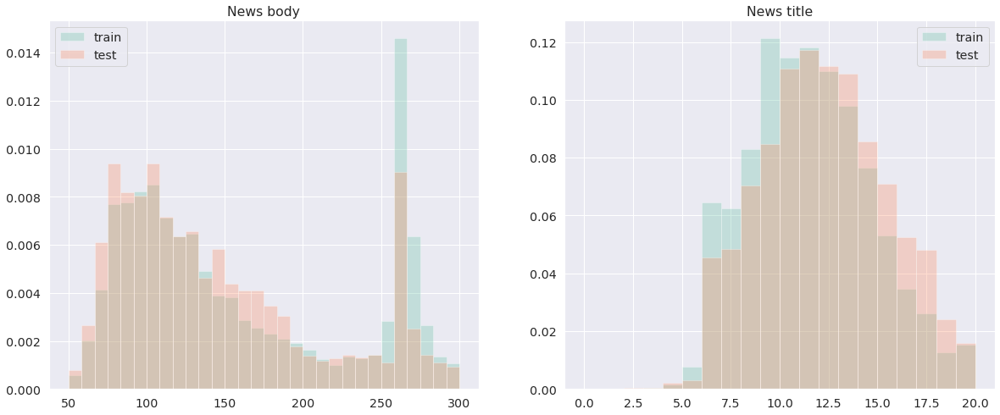

In [35]:
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
plt.hist([len(tockens) for tockens in train_tocken_list], alpha=0.3, label='train', range=(50, 300), density=True, bins=30)
plt.hist([len(tockens) for tockens in test_tocken_list], alpha=0.3, label='test', range=(50, 300), density=True, bins=30)
plt.legend()
plt.title('News body')

plt.subplot(1, 2, 2)
plt.hist([len(tockens) for tockens in train_title_tocken_list], alpha=0.3, label='train', range=(0, 20), density=True, bins=20)
plt.hist([len(tockens) for tockens in test_title_tocken_list], alpha=0.3, label='test', range=(0, 20), density=True, bins=20)
plt.legend()
plt.title('News title')

plt.show()

In [59]:
news_btc.loc[train_idxs][np.array([260<=len(tockens)<=265 for tockens in train_tocken_list])].tail(10)

,ticker,source,title,body,link
date,,,,,
2021-07-20 04:36:00+00:00,bitcoin,investing-new,Litecoin Falls 10% In Rout,\n\n\nLitecoin Falls 10% In Rout\n\n\nInvestin...,https://www.investing.com/news/cryptocurrency-...
2021-07-20 04:49:00+00:00,bitcoin,investing-new,Cardano Falls 10% In Bearish Trade,\n\n\nCardano Falls 10% In Bearish Trade\n\n\n...,https://www.investing.com/news/cryptocurrency-...
2021-07-21 10:49:00+00:00,bitcoin,investing-new,Cardano Climbs 10% As Investors Gain Confidence,\n\n\nCardano Climbs 10% As Investors Gain Con...,https://www.investing.com/news/cryptocurrency-...
2021-07-21 11:09:00+00:00,bitcoin,investing-new,Ethereum Climbs 10% In a Green Day,\n\n\nEthereum Climbs 10% In a Green Day\n\n\n...,https://www.investing.com/news/cryptocurrency-...
2021-07-21 15:26:00+00:00,bitcoin,investing-new,Litecoin Climbs 10% In Rally,\n\n\nLitecoin Climbs 10% In Rally\n\n\nInvest...,https://www.investing.com/news/cryptocurrency-...
2021-07-24 06:00:00+00:00,bitcoin,Other,Bitcoin mining suspended in Massena for aesthe...,\n\n\n© Reuters. Bitcoin mining suspended in M...,https://www.investing.com/news/cryptocurrency-...
2021-07-26 05:21:00+00:00,bitcoin,investing-new,Cardano Climbs 10% In Bullish Trade,\n\n\nCardano Climbs 10% In Bullish Trade\n\n\...,https://www.investing.com/news/cryptocurrency-...
2021-07-26 07:06:00+00:00,bitcoin,investing-new,Litecoin Climbs 10% In Rally,\n\n\nLitecoin Climbs 10% In Rally\n\n\nInvest...,https://www.investing.com/news/cryptocurrency-...
2021-07-27 07:54:00+00:00,bitcoin,investing-new,Cardano Falls 10% In Rout,\n\n\nCardano Falls 10% In Rout\n\n\nInvesting...,https://www.investing.com/news/cryptocurrency-...


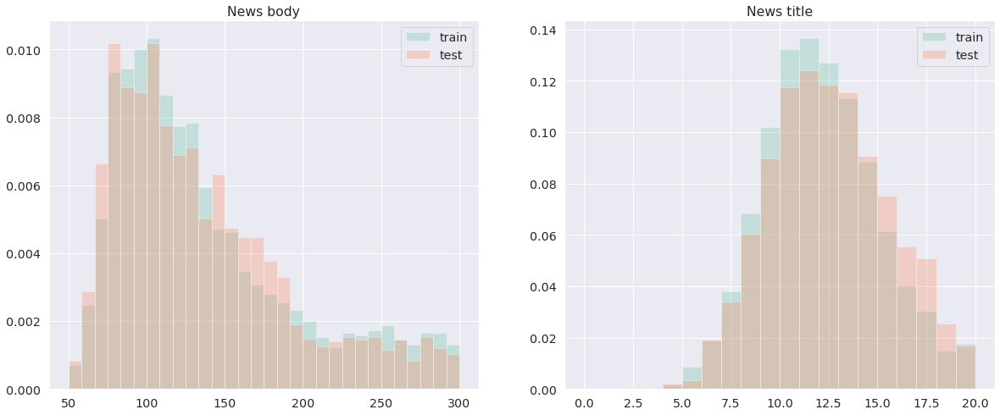

In [117]:
plt.figure(figsize=(20, 8))

plt.subplot(1, 2, 1)
plt.hist([len(tockens) for tockens in train_tocken_list], alpha=0.3, label='train', range=(50, 300), density=True, bins=30)
plt.hist([len(tockens) for tockens in test_tocken_list], alpha=0.3, label='test', range=(50, 300), density=True, bins=30)
plt.legend()
plt.title('News body')

plt.subplot(1, 2, 2)
plt.hist([len(tockens) for tockens in train_title_tocken_list], alpha=0.3, label='train', range=(0, 20), density=True, bins=20)
plt.hist([len(tockens) for tockens in test_title_tocken_list], alpha=0.3, label='test', range=(0, 20), density=True, bins=20)
plt.legend()
plt.title('News title')

plt.show()

Оставим новости длины не больше 222 слов

In [128]:
print(np.array([len(tockens) > 222 for tockens in train_tocken_list]).mean())
print(np.array([len(tockens) > 222 for tockens in test_tocken_list]).mean())
print(np.array([len(tockens) > 20 for tockens in train_title_tocken_list]).mean())
print(np.array([len(tockens) > 20 for tockens in test_title_tocken_list]).mean())

0.37969353948094975
0.41953163926258097
0.030922142462727776
0.0809666168410563


In [129]:
MAX_LEN = 222
MAX_TITLE_LEN = 20

train_text_list = [lemmatization(tockens)[:min(MAX_LEN, len(tockens))] for tockens in tqdm(train_tocken_list)]
test_text_list = [lemmatization(tockens)[:min(MAX_LEN, len(tockens))] for tockens in tqdm(test_tocken_list)]

train_title_list = [lemmatization(tockens)[:min(MAX_TITLE_LEN, len(tockens))] for tockens in tqdm(train_title_tocken_list)]
test_title_list = [lemmatization(tockens)[:min(MAX_TITLE_LEN, len(tockens))] for tockens in tqdm(test_title_tocken_list)]

  0%|          | 0/14488 [00:00<?, ?it/s]

  0%|          | 0/4014 [00:00<?, ?it/s]

  0%|          | 0/14488 [00:00<?, ?it/s]

  0%|          | 0/4014 [00:00<?, ?it/s]

In [131]:
torch.save({'train_tocken_list': train_tocken_list,
            'test_tocken_list': test_tocken_list,
            'train_title_tocken_list': train_title_tocken_list,
            'test_title_tocken_list': test_title_tocken_list,
            'train_text_list': train_text_list,
            'test_text_list': test_text_list,
            'train_title_list': train_title_list,
            'test_title_list': test_title_list}, 
           MAIN_DIR + 'lemmatization_news_indicators_222.data')

In [53]:
MAX_LEN = 222
MAX_TITLE_LEN = 20

loaded = torch.load(MAIN_DIR + 'lemmatization_news_indicators_222.data')
train_tocken_list = loaded['train_tocken_list']
test_tocken_list = loaded['test_tocken_list']
train_title_tocken_list = loaded['train_title_tocken_list']
test_title_tocken_list = loaded['test_title_tocken_list']
train_text_list = loaded['train_text_list']
test_text_list = loaded['test_text_list']
train_title_list = loaded['train_title_list']
test_title_list = loaded['test_title_list']

In [54]:
# y_train = [y for y, tockens in zip(np.array(y_train), train_tocken_list) if len(tockens) <= MAX_LEN]
# y_test = [y for y, tockens in zip(np.array(y_test), test_tocken_list) if len(tockens) <= MAX_LEN]
y_train = np.array(y_train)
y_test = np.array(y_test)

# buy_and_hold_train = [y for y, tockens in zip(np.array(buy_and_hold_train), train_tocken_list) if len(tockens) <= MAX_LEN]
# buy_and_hold_test = [y for y, tockens in zip(np.array(buy_and_hold_test), test_tocken_list) if len(tockens) <= MAX_LEN]

buy_and_hold_train = np.array(buy_and_hold_train)
buy_and_hold_test = np.array(buy_and_hold_test)

# X_train = [x for x, tockens in zip(np.array(X_train), train_tocken_list) if len(tockens) <= MAX_LEN]
# X_test = [x for x, tockens in zip(np.array(X_test), test_tocken_list) if len(tockens) <= MAX_LEN]

X_train = np.array(X_train)
X_test = np.array(X_test)

In [55]:
model_embeddings = gensim.models.Word2Vec(train_text_list)

In [56]:
print(model_embeddings.wv.most_similar('currency'))

[('coin', 0.7798283100128174), ('asset', 0.7491052150726318), ('yuan', 0.7480179071426392), ('asset-based', 0.6541454195976257), ('certificate', 0.6101309061050415), ('money', 0.5924879908561707), ('gold', 0.5892070531845093), ('portrait', 0.5609779357910156), ('cryptocurrencies', 0.5607619881629944), ('gold.', 0.5431417226791382)]


In [57]:
vocab = torchtext.vocab.build_vocab_from_iterator(train_text_list, specials=["<unk>"], min_freq=8)
vocab.set_default_index(vocab["<unk>"])
len(vocab)

10501

In [58]:
print(vocab(lemmas))

[8, 1622, 17, 5729, 161, 5, 12, 1545, 11, 190, 143, 86, 8, 651, 1954, 108, 11, 190, 1, 4, 0, 507, 1622, 1, 53, 4, 10428, 300, 81, 431, 2, 49, 55, 176, 4, 198, 44, 224, 2369, 108, 3, 446, 109, 26, 12, 0, 1, 65, 12, 0, 1, 62, 82, 0, 24, 11, 2, 81, 3, 8, 400, 17, 5729, 161, 5, 2, 12, 1545, 106, 1, 53, 1195, 2, 198, 106, 11, 177, 1, 224, 704, 108, 4, 110, 60, 477, 5, 112, 604, 3, 20, 156, 9, 8, 15, 3571, 60, 213, 1, 1578, 483, 0, 60, 1, 160, 2423, 99, 2, 34, 53, 1353, 1907, 7, 8, 9, 169, 6, 1543, 83, 57, 3, 1104, 57, 395, 154, 370, 61, 39, 1543, 1353, 1907, 7, 61, 620, 2, 1907, 6, 6293, 9, 515, 1, 167, 1538, 30, 2, 1201, 18, 22, 274, 7, 169, 3, 20, 5729, 44, 9, 8, 450, 563, 19, 69, 628, 1, 4, 2, 34, 1906, 754, 53, 219, 46, 68, 290, 24, 5, 4, 616, 79, 7, 12, 0, 3, 69, 83, 109, 26, 12, 0, 1, 65, 0, 24, 27, 0, 0, 3, 1960, 63, 15, 1597, 1442, 84, 165, 1632, 204, 4, 673, 375, 746, 526, 462, 10, 162, 1949, 9, 285, 1, 387, 6, 65, 0, 24, 10, 0, 24, 2212, 1, 1730, 3, 644, 2, 148, 7, 2, 64, 61, 15, 

Сформируем датасеты:

In [59]:
class NewsDataset(Dataset):
    def __init__(self, news, titles, X, y, vocab=vocab):
        self.len_news = [len(text) for text in news]
        self.news = [vocab(text) + [0] * (MAX_LEN - len(text)) for text in news]
        self.len_titles = [len(title) for title in titles]
        self.titles = [vocab(title) + [0] * (MAX_TITLE_LEN - len(title)) for title in titles]
        self.y = np.array(y)
        self.X = X

    def __len__(self):
        return len(self.news)

    def __getitem__(self, index):
        return self.news[index], self.len_news[index], self.titles[index], \
               self.len_titles[index], self.X[index], self.y[index]


def collate_batch(batch):
    news_list, len_news_list, title_list, len_title_list, x_list, value_list = [], [], [], [], [], []

    for new, len_new, title, len_title, x, value in batch:
        news_list.append(new)
        len_news_list.append(len_new)
        title_list.append(title)
        len_title_list.append(len_title)
        x_list.append(x)
        value_list.append(value)

    news_list = torch.tensor(news_list, dtype=torch.int32)
    len_news_list = torch.tensor(len_news_list, dtype=torch.int32)
    title_list = torch.tensor(title_list, dtype=torch.int32)
    len_title_list = torch.tensor(len_title_list, dtype=torch.int32)

    x_list = torch.tensor(x_list, dtype=torch.float32)
    value_list = torch.tensor(value_list, dtype=torch.float32)

    return news_list, len_news_list, title_list, len_title_list, x_list, value_list

In [60]:
BATCH_SIZE = 256

train_dataset = NewsDataset(train_text_list, train_title_list, X_train, y_train, vocab=vocab)
test_dataset = NewsDataset(test_text_list, test_title_list, X_test, y_test, vocab=vocab)

# train_dataset = NewsDataset(train_text_list, y_train, vocab=vocab)
# test_dataset = NewsDataset(test_text_list, y_test, vocab=vocab)

train_dataloader = DataLoader(train_dataset, 
                              batch_size=BATCH_SIZE, 
                              shuffle=True,
                              collate_fn=collate_batch)

test_dataloader = DataLoader(test_dataset, 
                             batch_size=BATCH_SIZE, 
                             shuffle=False, 
                             collate_fn=collate_batch)

In [96]:
def save_state(model, optimizer, epoch, history, name):
    torch.save({
        'epoch': epoch + 1,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'history': dict(history),
    }, MODELS_DIR + name + '.data')

def plot_history(history, start=0, save_name=None):
    num_plots = len(history)
    nrows = int(np.ceil(num_plots / 2))
    
    plt.figure(figsize=(20, 7 * nrows))

    for i, (name, metric) in enumerate(history.items()):
        plt.subplot(nrows, 2, i + 1)

        # if len(history[name]) > 30:
        #     plt.plot(history[name][5:], label='train')
        #     plt.plot(history['val_' + name][5:], label='val')
        # else:
        grid = np.arange(start, len(metric['train']))
        plt.plot(grid, metric['train'][start:], label='train')
        plt.plot(grid, metric['val'][start:], label='val')

        plt.title(name)
        plt.ylabel(name)
        plt.xlabel('Эпоха')
        plt.legend()
        
    if save_name is not None:
        plt.savefig(PLOTS_DIR + save_name)
    plt.show()


class ProfitPercent:
    def __init__(self, fee=FEE, buy_hold_returns=None, threshold=None, short=True, long=True):
        self.fee = fee
        self.threshold = threshold
        if threshold is None:
            self.threshold = 2 * self.fee
        self.profit = 0
        self.history = []

        self.buy_hold_returns = buy_hold_returns
        self.buy_and_hold_profit = []
        self.current_idx = 0

        self.short = short
        self.long = long

    def update_state(self, y_true, y_pred):
        y_true = torch.squeeze(y_true) / COEF
        y_pred = torch.squeeze(y_pred) / COEF

        idxs = ((y_pred > 2 * self.threshold) & self.long) | ((y_pred < -2 * self.threshold) & self.short)
        y_true = y_true[idxs]
        y_pred = y_pred[idxs]

        fee_sold = (1 + y_true) * (1 - self.fee) * self.fee
        profit = y_true * torch.sign(y_pred) * (1 - self.fee) - fee_sold

        profit = profit.detach().cpu()
        self.history.extend(profit.tolist())
        self.profit += profit.numpy().sum()

        if self.buy_hold_returns is not None:
            idxs = idxs.detach().cpu().numpy()
            self.buy_and_hold_profit.extend(self.buy_hold_returns[self.current_idx:self.current_idx + len(idxs)][idxs].tolist())
            self.current_idx += len(idxs)

    def result(self):
        return self.profit

    def get_history(self):
        return np.array(self.history).cumsum()

    def plot(self, create_figure=False):
        history = self.get_history()

        if create_figure:
            plt.figure(figsize=(12, 8))
        
        plt.plot(np.arange(len(history)), history, label='Модель')
        if self.buy_hold_returns is not None:
            plt.plot(np.arange(len(history)), self.buy_and_hold_profit, label='Купить и держать')

        plt.legend()
        plt.xlabel('Номер сделки')
        plt.ylabel('Кумулятивная доходность')
        add = ''
        if not self.short and self.long:
            add = ' only long'
        if not self.long and self.short:
            add = ' only short'

        plt.title(f'Комиссия {self.fee * 100}%, Граница {self.threshold * 100}%{add}')


def train(
    model, 
    criterion, 
    optimizer, 
    train_dataloader, 
    val_dataloader,
    scheduler=None,
    num_epochs=50, 
    history=None,
    save_name=None,
    threshold=0.0005,
    step_plotting=1,
):    
    if history is None:
        history = defaultdict(lambda: defaultdict(list))
        best_loss = float('inf')
        best_mae = float('inf')
        best_profit = -float('inf')
        best_profit_threshold = -float('inf')
        best_profit_fee = -float('inf')
        best_profit_fee_threshold = -float('inf')
    else:
        best_loss = min(history['loss']['val'])
        best_mae = min(history['mae']['val'])
        best_profit = max(history['profit']['val'])
        best_profit_threshold = max(history['profit_ths']['val'])
        best_profit_fee = max(history['profit_fee']['val'])
        best_profit_fee_threshold = max(history['profit_fee_ths']['val'])

    draw_start=0
        
    profit_dir = PLOTS_DIR + save_name + '_profit'
    os.makedirs(profit_dir, exist_ok=True)
    
    for epoch in range(num_epochs):
        train_loss, val_loss = 0.0, 0.0
        train_mae, val_mae = 0.0, 0.0

        train_profit = ProfitPercent(fee=0.0)
        train_profit_threshold = ProfitPercent(fee=0.0, threshold=threshold)
        val_profit = ProfitPercent(fee=0.0, buy_hold_returns=buy_and_hold_test)
        val_profit_threshold = ProfitPercent(fee=0.0, buy_hold_returns=buy_and_hold_test, threshold=threshold)

        train_profit_fee = ProfitPercent(fee=FEE)
        train_profit_fee_threshold = ProfitPercent(fee=FEE, threshold=threshold)
        val_profit_fee = ProfitPercent(fee=FEE, buy_hold_returns=buy_and_hold_test)
        val_profit_fee_threshold = ProfitPercent(fee=FEE, buy_hold_returns=buy_and_hold_test, threshold=2 * FEE + threshold)

        # Тренируем:
        start_time = time.time()
        model.train()
        
        for texts, len_texts, titles, len_titles, x, values in tqdm(train_dataloader):
            texts = texts.to(device)
            titles = titles.to(device)
            x = x.to(device)
            values = values.to(device)

            pred_ret = model(texts, len_texts, titles, len_titles, x)

            loss = criterion(pred_ret, values)

            # Backward prop.
            optimizer.zero_grad()
            loss.backward()
        
            optimizer.step()
            
            train_loss += loss.detach().cpu().numpy()
            train_mae += mean_absolute_error(values.detach().cpu().numpy(), pred_ret.detach().cpu().numpy())
            train_profit.update_state(values, pred_ret)
            train_profit_threshold.update_state(values, pred_ret)
            train_profit_fee.update_state(values, pred_ret)
            train_profit_fee_threshold.update_state(values, pred_ret)

            del loss, pred_ret
            del texts, len_texts, titles, len_titles, x, values
            
        if scheduler is not None:
            scheduler.step()
            
        train_loss /= len(train_dataloader)
        train_mae /= len(train_dataloader)
        
        history['loss']['train'].append(train_loss)
        history['mae']['train'].append(train_mae)
        history['profit']['train'].append(train_profit.result())
        history['profit_ths']['train'].append(train_profit_threshold.result())
        history['profit_fee']['train'].append(train_profit_fee.result())
        history['profit_fee_ths']['train'].append(train_profit_fee_threshold.result())
        
        # Валидируем:
        model.eval()
        
        with torch.no_grad():
            for texts, len_texts, titles, len_titles, x, values in tqdm(val_dataloader):
                texts = texts.to(device)
                titles = titles.to(device)
                x = x.to(device)
                values = values.to(device)

                pred_ret = model(texts, len_texts, titles, len_titles, x)

                loss = criterion(pred_ret, values)
                
                val_loss += loss.detach().cpu().numpy()
                val_mae += mean_absolute_error(values.detach().cpu().numpy(), pred_ret.detach().cpu().numpy())
                val_profit.update_state(values, pred_ret)
                val_profit_threshold.update_state(values, pred_ret)
                val_profit_fee.update_state(values, pred_ret)
                val_profit_fee_threshold.update_state(values, pred_ret)

                del loss, pred_ret
                del texts, len_texts, titles, len_titles, x, values

        val_loss /= len(val_dataloader)
        val_mae /= len(val_dataloader)
        
        history['loss']['val'].append(val_loss)
        history['mae']['val'].append(val_mae)
        history['profit']['val'].append(val_profit.result())
        history['profit_ths']['val'].append(val_profit_threshold.result())
        history['profit_fee']['val'].append(val_profit_fee.result())
        history['profit_fee_ths']['val'].append(val_profit_fee_threshold.result())
        
        if best_loss > val_loss:
            best_loss = val_loss
            save_state(model, optimizer, epoch, history, save_name + '_loss')

        if best_mae > val_mae:
            best_mae = val_mae
            save_state(model, optimizer, epoch, history, save_name + '_mae')

        if best_profit < val_profit.result():
            best_profit = val_profit.result()
            save_state(model, optimizer, epoch, history, save_name + '_profit')

        if best_profit_threshold < val_profit_threshold.result():
            best_profit_threshold = val_profit_threshold.result()
            save_state(model, optimizer, epoch, history, save_name + '_profit_ths')
        
        if best_profit_fee < val_profit_fee.result():
            best_profit_fee = val_profit_fee.result()
            save_state(model, optimizer, epoch, history, save_name + '_profit_fee')

        if best_profit_fee_threshold < val_profit_fee_threshold.result():
            best_profit_fee_threshold = val_profit_fee_threshold.result()
            save_state(model, optimizer, epoch, history, save_name + '_profit_fee_ths')
        
        # Выводим метрики и строим графики
        if epoch % step_plotting == step_plotting - 1 or epoch == num_epochs - 1:
            display.clear_output()
            
            print(f'Epoch {epoch + 1} of {num_epochs} took {time.time() - start_time:.3f}s')
            
            print(f'  training loss: \t{train_loss:.6f}')
            print(f'  training mae: \t{train_mae:.6f}')
            print(f'  training profit: \t{train_profit.result() * 100:.3f} %')
            print(f'  training profit ths: \t{train_profit_threshold.result() * 100:.3f} %')
            print(f'  training profit fee: \t{train_profit_fee.result() * 100:.3f} %')
            print(f'  training profit fee ths: \t{train_profit_fee_threshold.result() * 100:.3f} %')

            print(f'  val loss: \t{val_loss:.6f} \t({best_loss:.6f})')
            print(f'  val mae: \t{val_mae:.6f} \t({best_mae:.6f})')
            print(f'  val profit: \t{val_profit.result() * 100:.3f} % \t({best_profit * 100:.3f} %)')
            print(f'  val profit ths: \t{val_profit_threshold.result() * 100:.3f} % \t({best_profit_threshold * 100:.3f} %)')
            print(f'  val profit fee: \t{val_profit_fee.result() * 100:.3f} % \t({best_profit_fee * 100:.3f} %)')
            print(f'  val profit fee ths: \t{val_profit_fee_threshold.result() * 100:.3f} % \t({best_profit_fee_threshold * 100:.3f} %)')
            
            if len(history['loss']['train']) > 10:
                delta_begin = history['loss']['train'][draw_start] - history['loss']['train'][draw_start+5]
                delta_end = history['loss']['train'][-6] - history['loss']['train'][-1]
                if delta_begin / delta_end > 10:
                    draw_start = min(draw_start + 5, len(history['loss']['train']) - 2)
            
            plot_history(history, start=draw_start, save_name=f'{save_name}_metris.png')

            plt.figure(figsize=(20, 14))

            plt.subplot(2, 2, 1)
            val_profit.plot()
            plt.subplot(2, 2, 2)
            val_profit_fee.plot()

            plt.subplot(2, 2, 3)
            val_profit_threshold.plot()
            plt.subplot(2, 2, 4)
            val_profit_fee_threshold.plot()

            plt.savefig(profit_dir + f'/{epoch + 1}epoch.png')
            plt.show()

    return model, history

In [97]:
def predict(
    model, 
    criterion,
    val_dataloader,
    threshold=0.0005,
    short=True, long=True,
):    
    val_loss = 0.0
    val_mae = 0.0

    val_profit = ProfitPercent(fee=0.0, buy_hold_returns=buy_and_hold_test, short=short, long=long)
    val_profit_threshold = ProfitPercent(fee=0.0, buy_hold_returns=buy_and_hold_test, threshold=threshold, short=short, long=long)

    val_profit_fee = ProfitPercent(fee=FEE, buy_hold_returns=buy_and_hold_test, short=short, long=long)
    val_profit_fee_threshold = ProfitPercent(fee=FEE, buy_hold_returns=buy_and_hold_test, threshold=2 * FEE + threshold, short=short, long=long)

    model.eval()

    with torch.no_grad():
        for texts, len_texts, titles, len_titles, x, values in tqdm(val_dataloader):
            texts = texts.to(device)
            titles = titles.to(device)
            x = x.to(device)
            values = values.to(device)

            pred_ret = model(texts, len_texts, titles, len_titles, x)

            loss = criterion(pred_ret, values)
            
            val_loss += loss.detach().cpu().numpy()
            val_mae += mean_absolute_error(values.detach().cpu().numpy(), pred_ret.detach().cpu().numpy())
            val_profit.update_state(values, pred_ret)
            val_profit_threshold.update_state(values, pred_ret)
            val_profit_fee.update_state(values, pred_ret)
            val_profit_fee_threshold.update_state(values, pred_ret)

            del loss, pred_ret
            del texts, len_texts, titles, len_titles, x, values

    val_loss /= len(val_dataloader)
    val_mae /= len(val_dataloader)
    
    # Выводим метрики и строим графики
    display.clear_output()

    print(f'  val loss: \t{val_loss:.6f}')
    print(f'  val mae: \t{val_mae:.6f}')
    print(f'  val profit: \t{val_profit.result() * 100:.3f} %')
    print(f'  val profit ths: \t{val_profit_threshold.result() * 100:.3f} %')
    print(f'  val profit fee: \t{val_profit_fee.result() * 100:.3f} %')
    print(f'  val profit fee ths: \t{val_profit_fee_threshold.result() * 100:.3f} %')
    
    # plot_history(history, save_name=f'{save_name}_metris.png')

    plt.figure(figsize=(20, 14))

    plt.subplot(2, 2, 1)
    val_profit.plot()
    plt.subplot(2, 2, 2)
    val_profit_fee.plot()

    plt.subplot(2, 2, 3)
    val_profit_threshold.plot()
    plt.subplot(2, 2, 4)
    val_profit_fee_threshold.plot()

    # plt.savefig(profit_dir + f'/{epoch + 1}epoch.png')
    plt.show()

    return model

## Part 1 (LSTM, only news)

In [ ]:
class Model1(nn.Module):
    def __init__(self, embed_dim=200):
        super(Model1, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embed_dim, padding_idx=0)
        self.lstm = nn.LSTM(input_size=embed_dim, hidden_size=128, 
                            num_layers=2, 
                            # batch_first=True, 
                            bidirectional=True, dropout=0.3)
        
        self.fc1 = nn.Linear(256, 64)
        self.norm = nn.BatchNorm1d(64)
        self.dropout = nn.Dropout(0.3)

        self.fc2 = nn.Linear(64, 1)
        
    #     self.init_weights()

    # def init_weights(self):
    #     initrange = 0.5
    #     self.embedding.weight.data.uniform_(-initrange, initrange)
    #     self.fc.weight.data.uniform_(-initrange, initrange)
    #     self.fc.bias.data.zero_()

    def forward(self, text, text_len, X):
        embedded = self.embedding(text)

        embedded = embedded.permute(1, 0, 2)
        packed_in = nn.utils.rnn.pack_padded_sequence(embedded, text_len, 
                                        #  batch_first=True, 
                                         enforce_sorted=False)
        out, (hidden, cell) = self.lstm(packed_in)
        # out, _ = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)

        hidden = self.dropout(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))
        output = self.fc1(hidden)
        output = self.norm(output)
        output = F.relu(self.dropout(output))
        output =self.fc2(output)

        # out = self.fc1(out)
        # out = self.norm(out)
        # out = F.relu(self.dropout(self.norm(out)))
        # out = self.fc2(out)
        return output

# summary(Model1(), (32, 600), dtypes=[torch.long])

In [ ]:
inp = next(iter(train_dataloader))
# inp

In [ ]:
Model1()(inp[0], inp[1]).shape

torch.Size([128, 1])

Epoch 27 of 50 took 37.765s
  training loss: 	0.235101
  training mae: 	0.288840
  training profit: 	1562.836 %
  training profit fee: 	581.777 %
  val loss: 	0.180992 	(0.160135)
  val mae: 	0.259425 	(0.230844)
  val profit: 	23.477 % 	(53.125 %)
  val profit fee: 	-40.082 % 	(4.650 %)


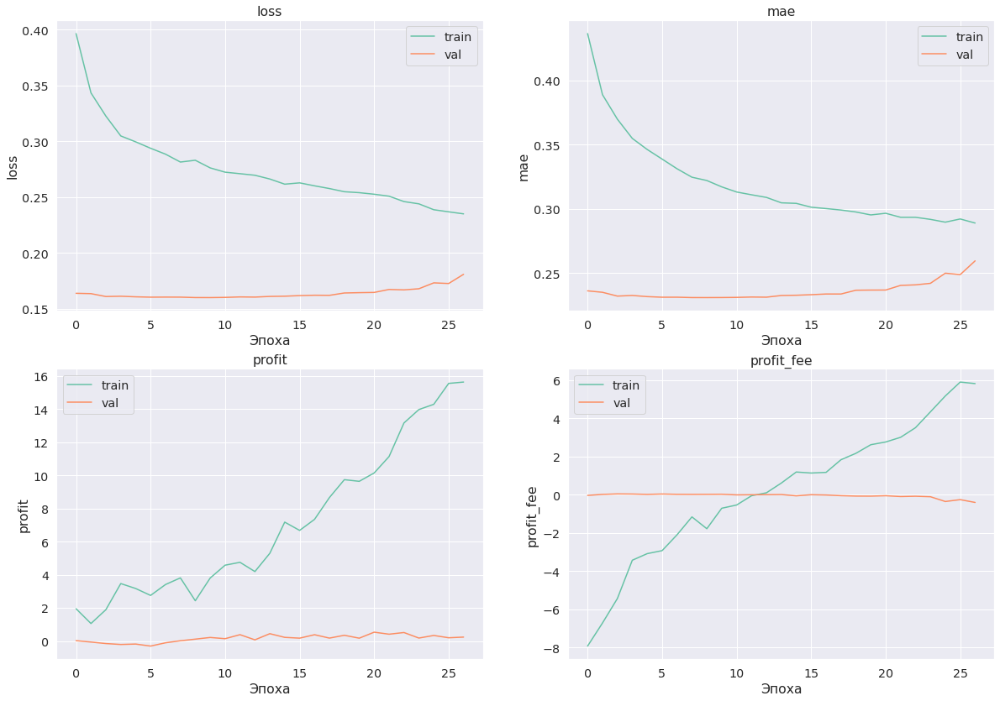

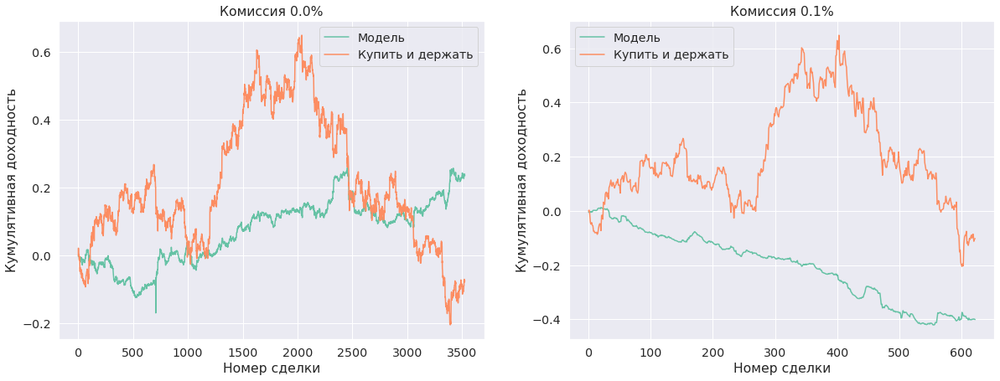

  0%|          | 0/63 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
model = Model1().to(device)
optimizer = torch.optim.Adam(params=model.parameters(), lr=2e-4)
criterion = nn.MSELoss()
# scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[10, 25], gamma=0.1)

model, history = train(
    model, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    # scheduler=scheduler,
    num_epochs=50,
    save_name='Model1',
)

In [ ]:
class Model2(nn.Module):
    def __init__(self):
        super(Model2, self).__init__()

        self.embedding = nn.Embedding(len(vocab), 300, padding_idx=0)
        self.lstm = nn.LSTM(input_size=300, 
                            hidden_size=128, 
                            num_layers=3, 
                            # batch_first=True, 
                            bidirectional=True, 
                            dropout=0.4)
        
        self.dropout0 = nn.Dropout(0.4)
        self.fc1 = nn.Linear(256, 128)
        # self.norm = nn.BatchNorm1d(128)
        self.dropout1 = nn.Dropout(0.3)

        self.fc2 = nn.Linear(128, 32)
        self.dropout2 = nn.Dropout(0.3)

        self.fc3 = nn.Linear(32, 1)

    def forward(self, text, text_len, X):
        embedded = self.embedding(text)

        embedded = embedded.permute(1, 0, 2)
        packed_in = nn.utils.rnn.pack_padded_sequence(embedded, text_len, 
                                        #  batch_first=True, 
                                         enforce_sorted=False)
        out, (hidden, cell) = self.lstm(packed_in)
        # out, _ = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)

        hidden = self.dropout0(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))

        output = self.fc1(hidden)
        # output = self.norm(output)
        output = F.relu(self.dropout1(output))

        output = self.fc2(output)
        output = F.relu(self.dropout2(output))

        output =self.fc3(output)
        return output

Epoch 17 of 50 took 62.897s
  training loss: 	0.123282
  training mae: 	0.198342
  training profit: 	3207.458 %
  training profit ths: 	2824.488 %
  training profit fee: 	1427.558 %
  training profit fee ths: 	2069.053 %
  val loss: 	0.198637 	(0.158604)
  val mae: 	0.277683 	(0.228475)
  val profit: 	-2.594 % 	(70.613 %)
  val profit ths: 	36.195 % 	(36.195 %)
  val profit fee: 	-18.039 % 	(0.000 %)
  val profit fee ths: 	-7.782 % 	(0.000 %)


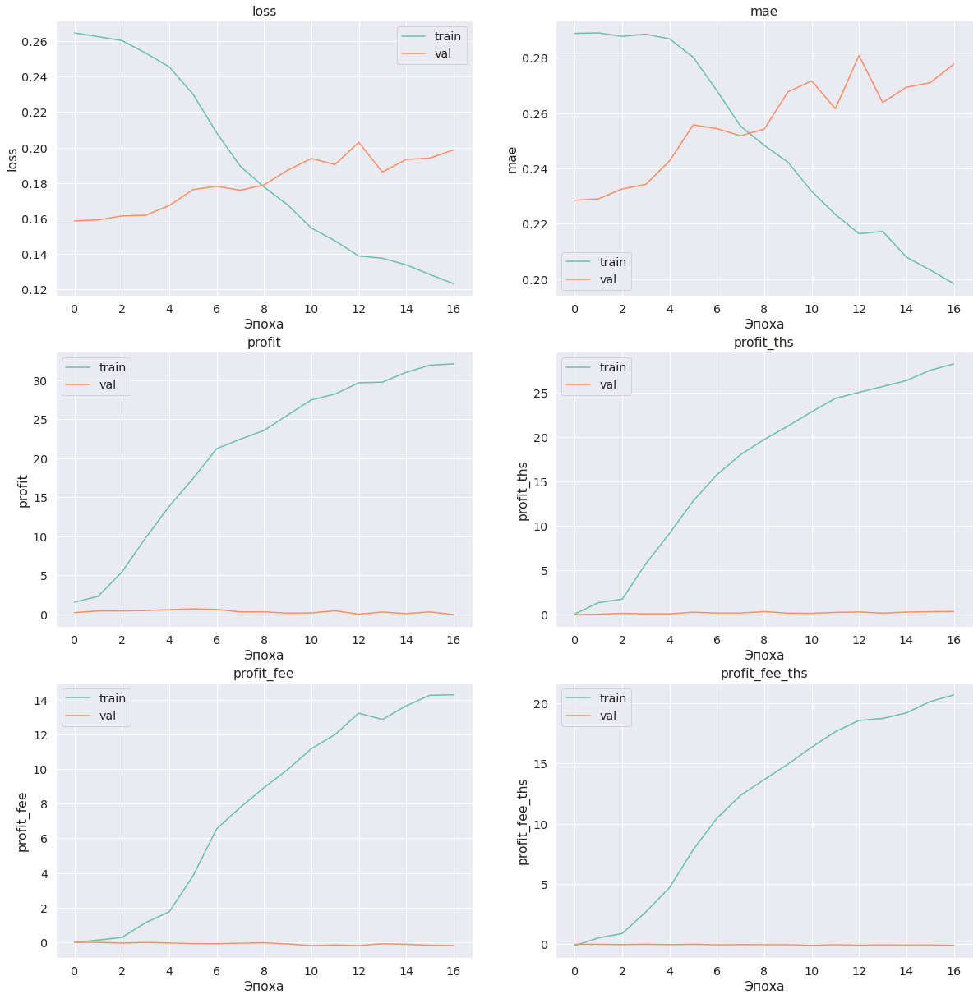

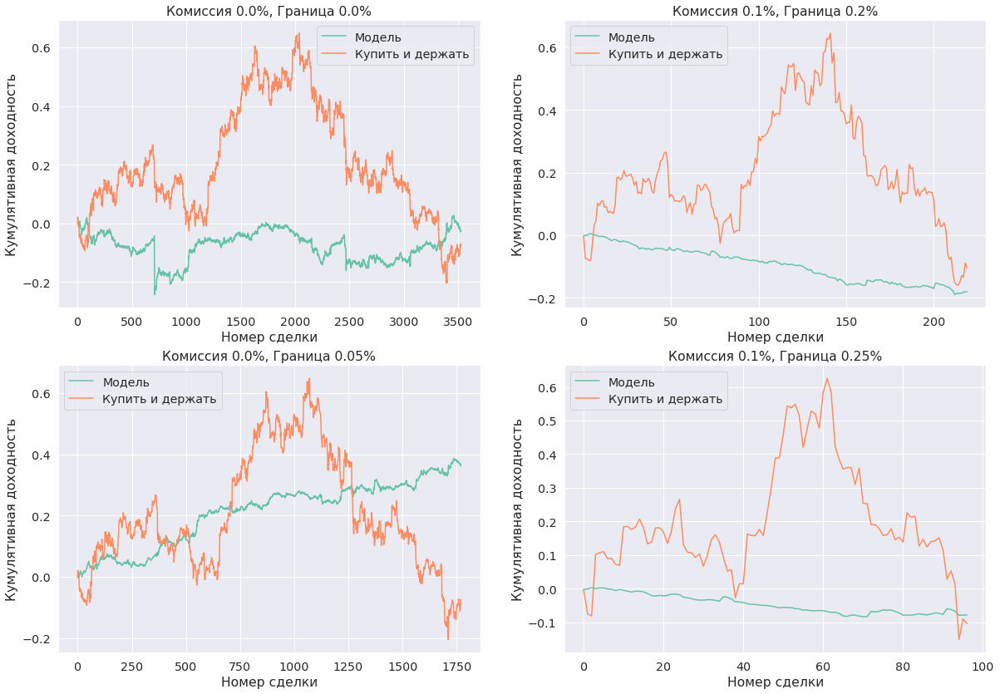

  0%|          | 0/63 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
model2 = Model2().to(device)
optimizer = torch.optim.Adam(params=model2.parameters(), lr=1e-3)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30], gamma=0.1)

model2, history = train(
    model2, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model2',
)

In [ ]:
class Model3(nn.Module):
    def __init__(self):
        super(Model3, self).__init__()

        self.embedding = nn.Embedding(len(vocab), 150, padding_idx=0)
        self.lstm = nn.LSTM(input_size=150, 
                            hidden_size=50, 
                            num_layers=2, 
                            # batch_first=True, 
                            bidirectional=True, 
                            dropout=0.3)
        
        self.dropout0 = nn.Dropout(0.3)
        self.fc1 = nn.Linear(100, 64)
        # self.norm = nn.BatchNorm1d(128)
        self.dropout1 = nn.Dropout(0.2)

        self.fc2 = nn.Linear(64, 1)

    def forward(self, text, text_len, X=None):
        embedded = self.embedding(text)

        embedded = embedded.permute(1, 0, 2)
        packed_in = nn.utils.rnn.pack_padded_sequence(embedded, text_len, 
                                        #  batch_first=True, 
                                         enforce_sorted=False)
        out, (hidden, cell) = self.lstm(packed_in)
        # out, _ = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)

        hidden = self.dropout0(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))

        output = self.fc1(hidden)
        # output = self.norm(output)
        output = F.leaky_relu(self.dropout1(output))

        output = self.fc2(output)
        return output

In [ ]:
(np.abs(y_train) > 0.25).mean()

0.3413981838537131

Epoch 26 of 50 took 29.767s
  training loss: 	0.112168
  training mae: 	0.190838
  training profit: 	3273.023 %
  training profit ths: 	2869.836 %
  training profit fee: 	1504.957 %
  training profit fee ths: 	2086.404 %
  val loss: 	0.215943 	(0.159490)
  val mae: 	0.289740 	(0.229569)
  val profit: 	51.041 % 	(68.180 %)
  val profit ths: 	30.793 % 	(38.613 %)
  val profit fee: 	-29.495 % 	(4.011 %)
  val profit fee ths: 	-15.674 % 	(7.634 %)


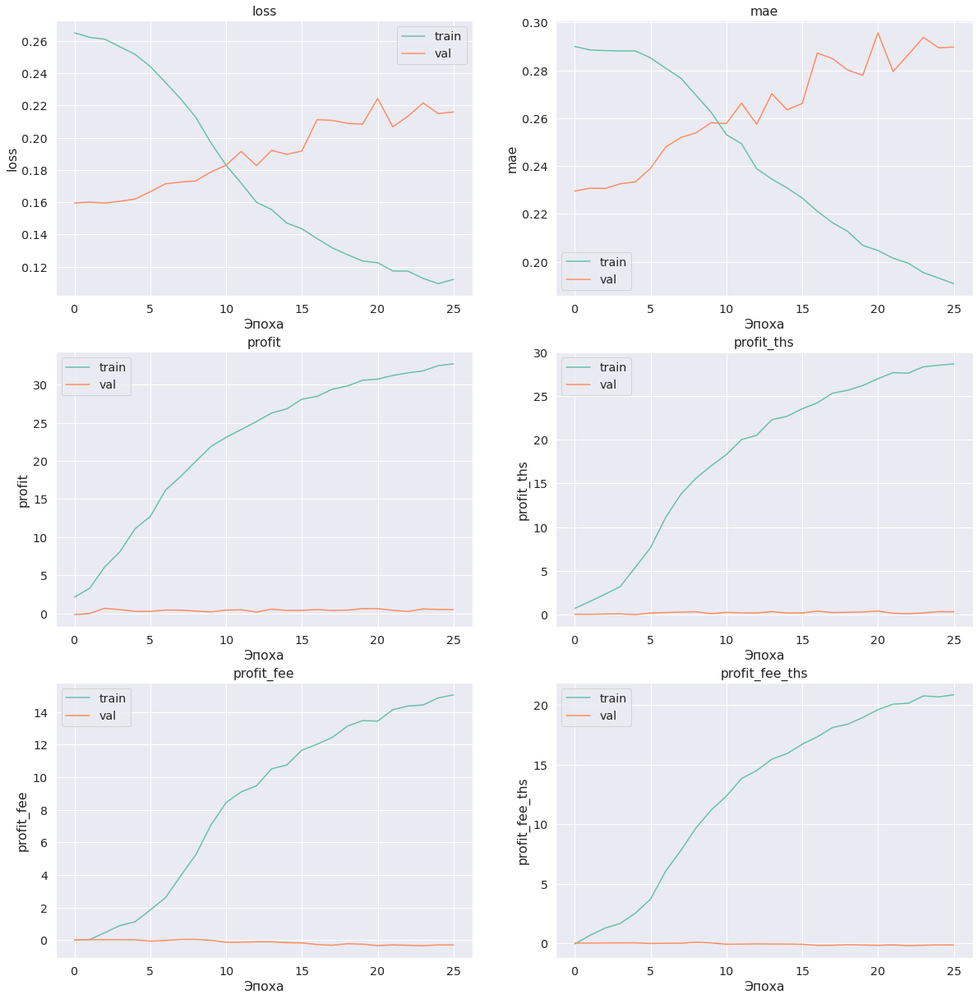

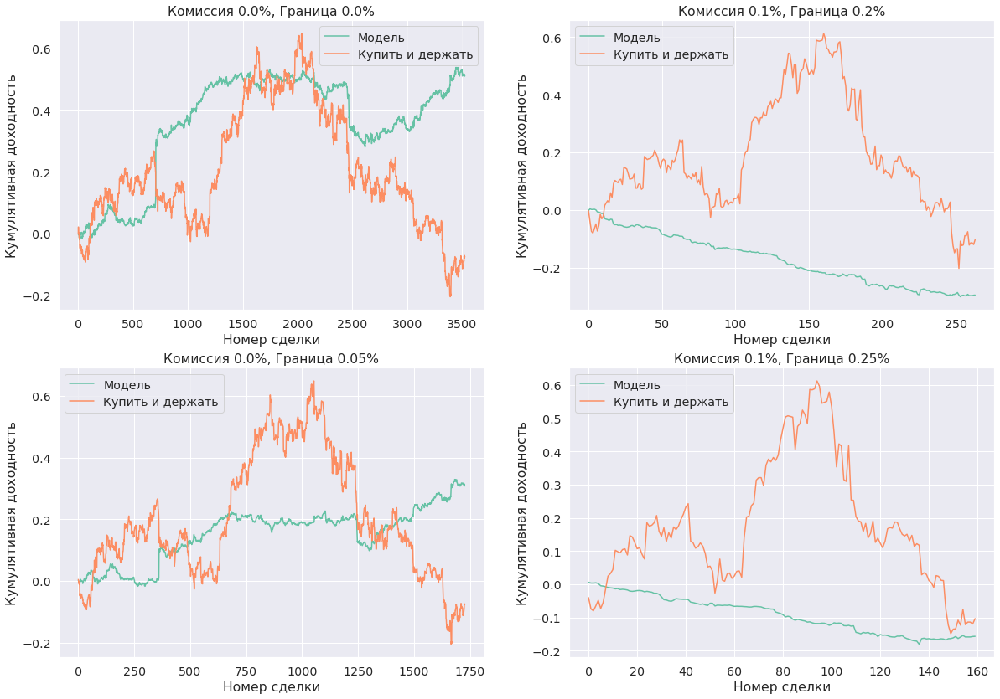

  0%|          | 0/63 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
model3 = Model3().to(device)
optimizer = torch.optim.Adam(params=model3.parameters(), lr=1e-3)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30], gamma=0.1)

model3, history = train(
    model3, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model3',
)

In [ ]:
class Model4(nn.Module):
    def __init__(self):
        super(Model4, self).__init__()

        self.embedding = nn.Embedding(len(vocab), 100, padding_idx=0)
        self.lstm = nn.LSTM(input_size=100, 
                            hidden_size=50, 
                            num_layers=5, 
                            # batch_first=True, 
                            bidirectional=True, 
                            dropout=0.5)
        
        self.dropout0 = nn.Dropout(0.4)
        self.fc1 = nn.Linear(100, 32)
        # self.norm = nn.BatchNorm1d(128)
        self.dropout1 = nn.Dropout(0.2)

        self.fc2 = nn.Linear(32, 1)

    def forward(self, text, text_len, X):
        embedded = self.embedding(text)

        embedded = embedded.permute(1, 0, 2)
        packed_in = nn.utils.rnn.pack_padded_sequence(embedded, text_len, 
                                        #  batch_first=True, 
                                         enforce_sorted=False)
        out, (hidden, cell) = self.lstm(packed_in)
        # out, _ = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)

        hidden = self.dropout0(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))

        output = self.fc1(hidden)
        # output = self.norm(output)
        output = F.leaky_relu(self.dropout1(output))

        output = self.fc2(output)
        return output

Epoch 21 of 50 took 93.341s
  training loss: 	0.140220
  training mae: 	0.223229
  training profit: 	2912.217 %
  training profit ths: 	2516.860 %
  training profit fee: 	1230.978 %
  training profit fee ths: 	1783.983 %
  val loss: 	0.219069 	(0.158484)
  val mae: 	0.298820 	(0.228179)
  val profit: 	29.807 % 	(72.121 %)
  val profit ths: 	39.417 % 	(39.417 %)
  val profit fee: 	-39.274 % 	(0.930 %)
  val profit fee ths: 	-17.156 % 	(1.641 %)


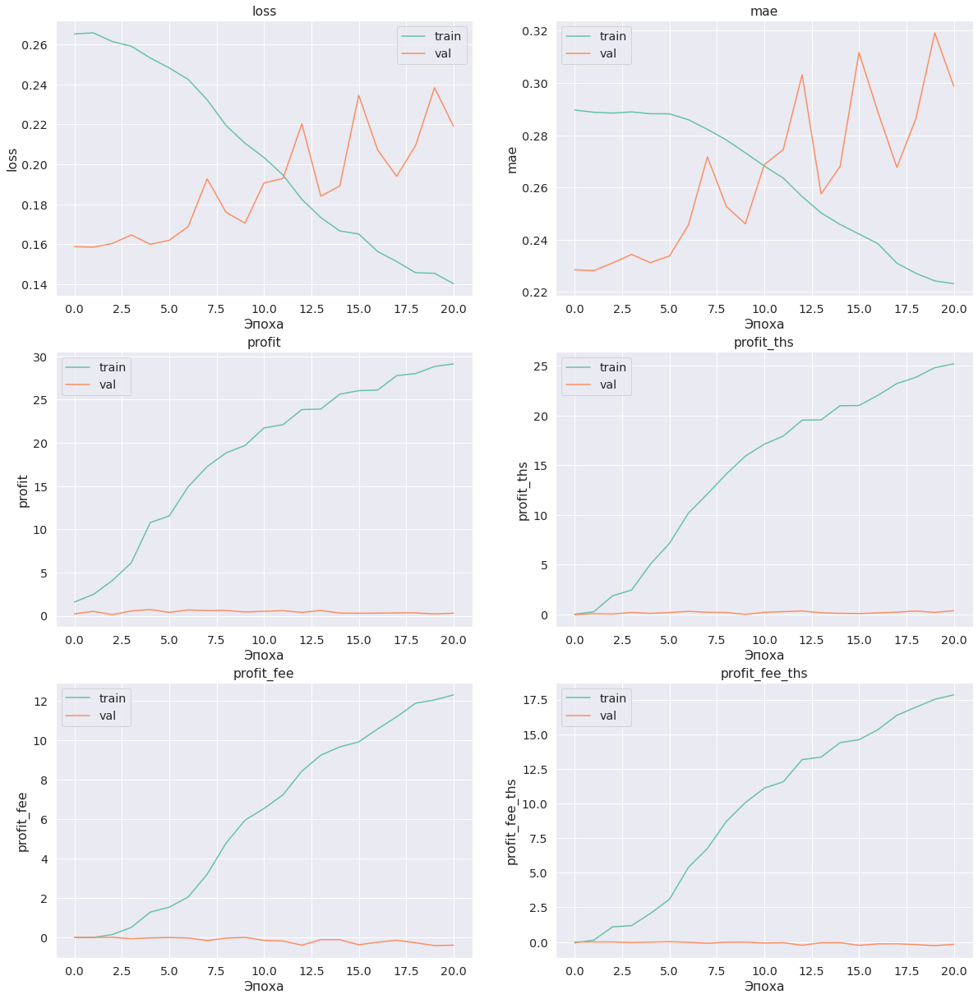

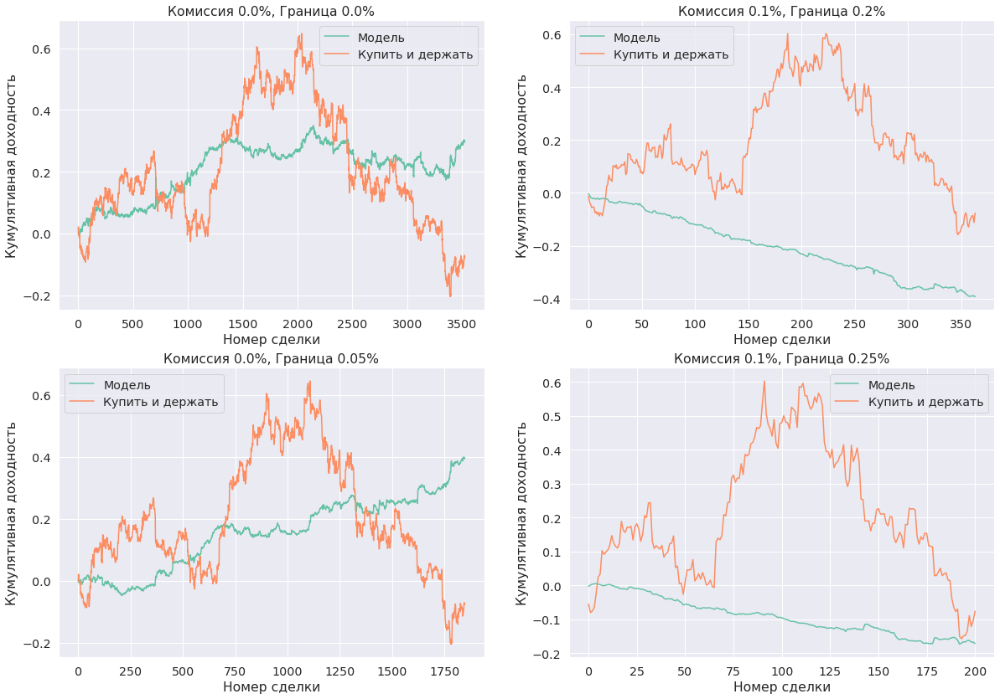

  0%|          | 0/63 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
model4 = Model4().to(device)
optimizer = torch.optim.Adam(params=model4.parameters(), lr=1e-3)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30], gamma=0.1)

model4, history = train(
    model4, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model4',
)

In [ ]:
class Model5(nn.Module):
    def __init__(self):
        super(Model5, self).__init__()

        self.embedding = nn.Embedding(len(vocab), 150, padding_idx=0)
        self.lstm = nn.LSTM(input_size=150, 
                            hidden_size=50, 
                            num_layers=2, 
                            batch_first=True, 
                            bidirectional=True, 
                            dropout=0.3)
        
        self.convs = nn.ModuleList([
          nn.Conv1d(
              in_channels=100, out_channels=128, 
              kernel_size=fs,
          ) for fs in [3, 4, 5]
        ])

        self.dropout0 = nn.Dropout(0.4)
        self.fc1 = nn.Linear(128 * 3, 64)
        # self.norm = nn.BatchNorm1d(128)
        self.dropout1 = nn.Dropout(0.3)

        self.fc2 = nn.Linear(64, 1)

    def forward(self, text, text_len, X):
        embedded = self.embedding(text)

        output, (_, _) = self.lstm(embedded)

        output = output.permute(0, 2, 1)
        conved = [F.relu(conv(output)) for conv in self.convs]
        pooled = [F.max_pool1d(conv, conv.shape[2]).squeeze(2) for conv in conved]
        pooled = self.dropout0(torch.cat(pooled, dim = 1))   

        output = self.fc1(pooled)
        # output = self.norm(output)
        output = F.relu(self.dropout1(output))

        output = self.fc2(output)
        return output

Epoch 15 of 50 took 45.450s
  training loss: 	0.163052
  training mae: 	0.236450
  training profit: 	2231.444 %
  training profit ths: 	1694.680 %
  training profit fee: 	676.943 %
  training profit fee ths: 	1111.658 %
  val loss: 	0.188066 	(0.158351)
  val mae: 	0.270579 	(0.228309)
  val profit: 	26.998 % 	(48.908 %)
  val profit ths: 	37.540 % 	(37.540 %)
  val profit fee: 	-12.860 % 	(0.057 %)
  val profit fee ths: 	-5.463 % 	(0.000 %)


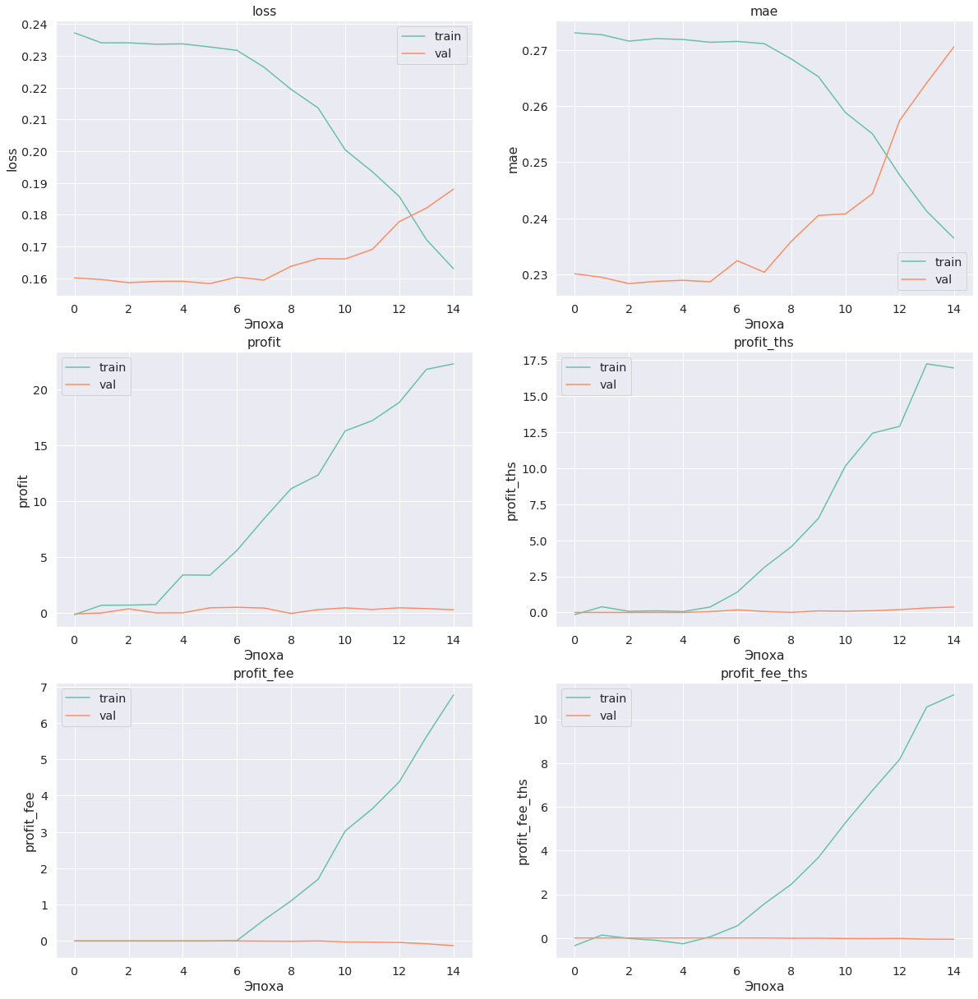

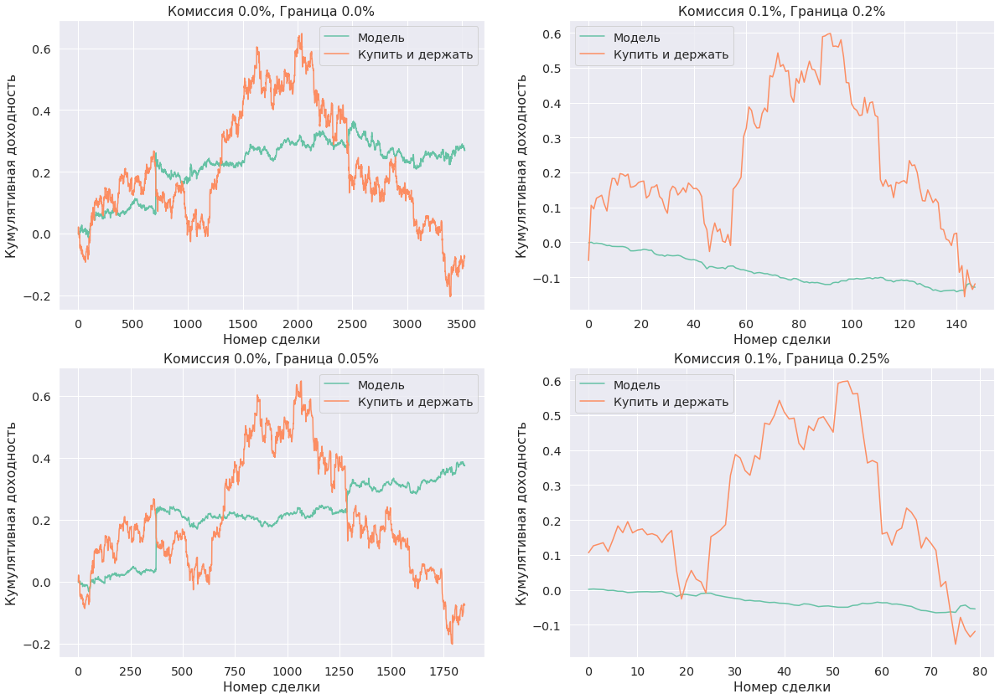

  0%|          | 0/60 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
model5 = Model5().to(device)
optimizer = torch.optim.Adam(params=model5.parameters(), lr=1e-3)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30], gamma=0.1)

model5, history = train(
    model5, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model5',
)

  val loss: 	0.173207
  val mae: 	0.253889
  val profit: 	31.166 %
  val profit ths: 	30.166 %
  val profit fee: 	4.011 %
  val profit fee ths: 	7.634 %


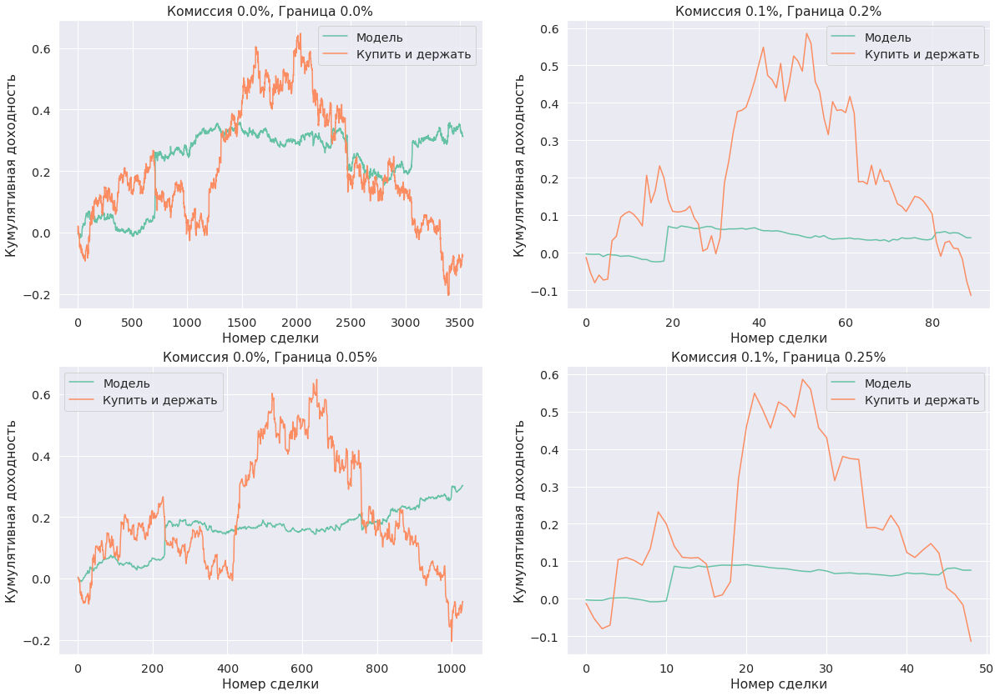

Model3(
  (embedding): Embedding(10495, 150, padding_idx=0)
  (lstm): LSTM(150, 50, num_layers=2, dropout=0.3, bidirectional=True)
  (dropout0): Dropout(p=0.3, inplace=False)
  (fc1): Linear(in_features=100, out_features=64, bias=True)
  (dropout1): Dropout(p=0.2, inplace=False)
  (fc2): Linear(in_features=64, out_features=1, bias=True)
)

In [ ]:
criterion = nn.MSELoss()

predict(model3, criterion, test_dataloader)

## Part 2 (LSTM, news + prices)

In [ ]:
class Model6(nn.Module):
    def __init__(self):
        super(Model6, self).__init__()

        self.embedding = nn.Embedding(len(vocab), 150, padding_idx=0)
        self.lstm = nn.LSTM(input_size=150, 
                            hidden_size=64, 
                            num_layers=2, 
                            # batch_first=True, 
                            bidirectional=True, 
                            dropout=0.3)
        self.dropout0 = nn.Dropout(0.3)
        
        # -------

        self.fc1_X = nn.Linear(147, 1024)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(1024, 128)
        self.dropout2_X = nn.Dropout(0.3)
        self.norm = nn.BatchNorm1d(128)

        # -------

        self.fc1 = nn.Linear(64 * 2 + 128, 64)
        self.dropout1 = nn.Dropout(0.2)

        self.fc2 = nn.Linear(64, 1)

    def forward(self, text, text_len, X):
        embedded = self.embedding(text)

        embedded = embedded.permute(1, 0, 2)
        packed_in = nn.utils.rnn.pack_padded_sequence(embedded, text_len, 
                                        #  batch_first=True, 
                                         enforce_sorted=False)
        out, (hidden, cell) = self.lstm(packed_in)
        # out, _ = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)

        hidden = self.dropout0(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = self.norm(F.relu(self.dropout2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc1(torch.cat([hidden, X_out], dim=1))
        # output = self.norm(output)
        output = F.leaky_relu(self.dropout1(output))

        output = self.fc2(output)
        return output

Epoch 50 of 50 took 29.785s
  training loss: 	1049.788013
  training mae: 	13.097974
  training profit: 	-68.852 %
  training profit ths: 	-68.030 %
  training profit fee: 	-1471.977 %
  training profit fee ths: 	-1561.048 %
  val loss: 	8.279845 	(8.279845)
  val mae: 	1.544485 	(1.544485)
  val profit: 	-14.626 % 	(33.219 %)
  val profit ths: 	-23.181 % 	(35.199 %)
  val profit fee: 	-263.300 % 	(-246.802 %)
  val profit fee ths: 	-243.002 % 	(-231.257 %)


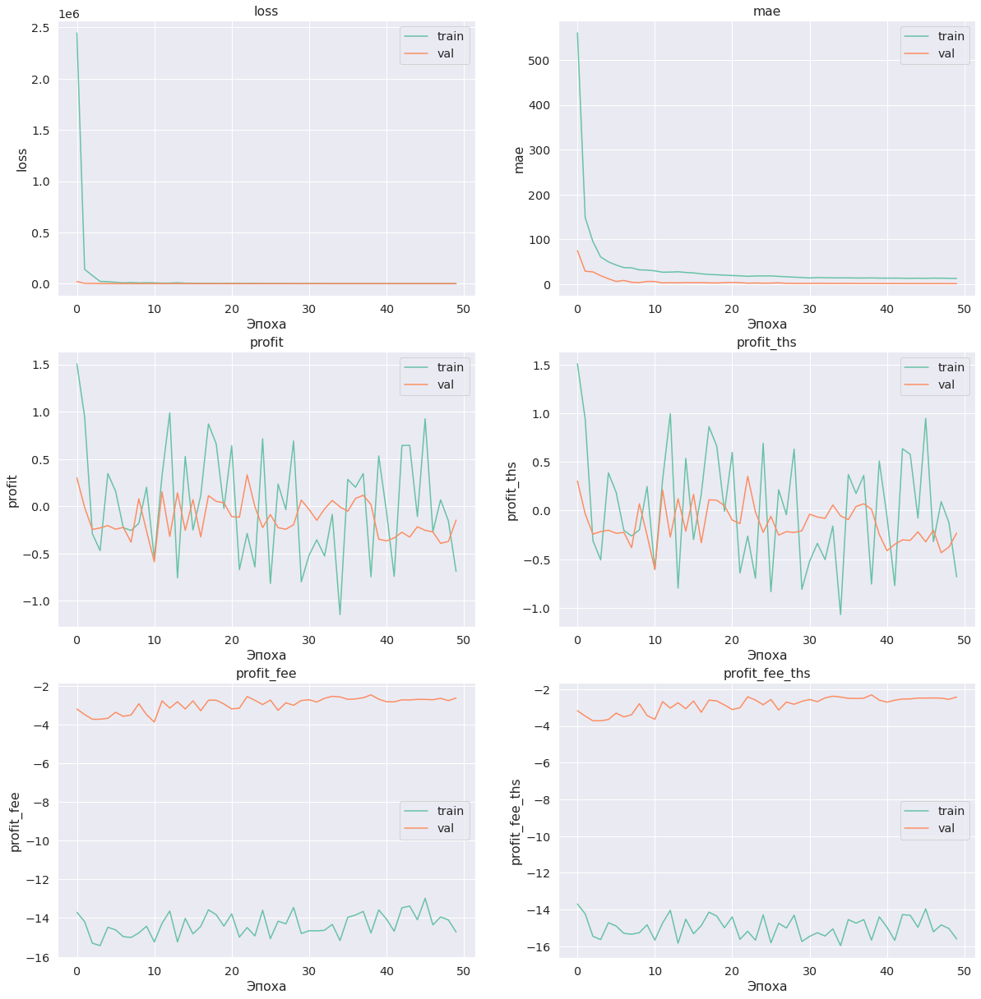

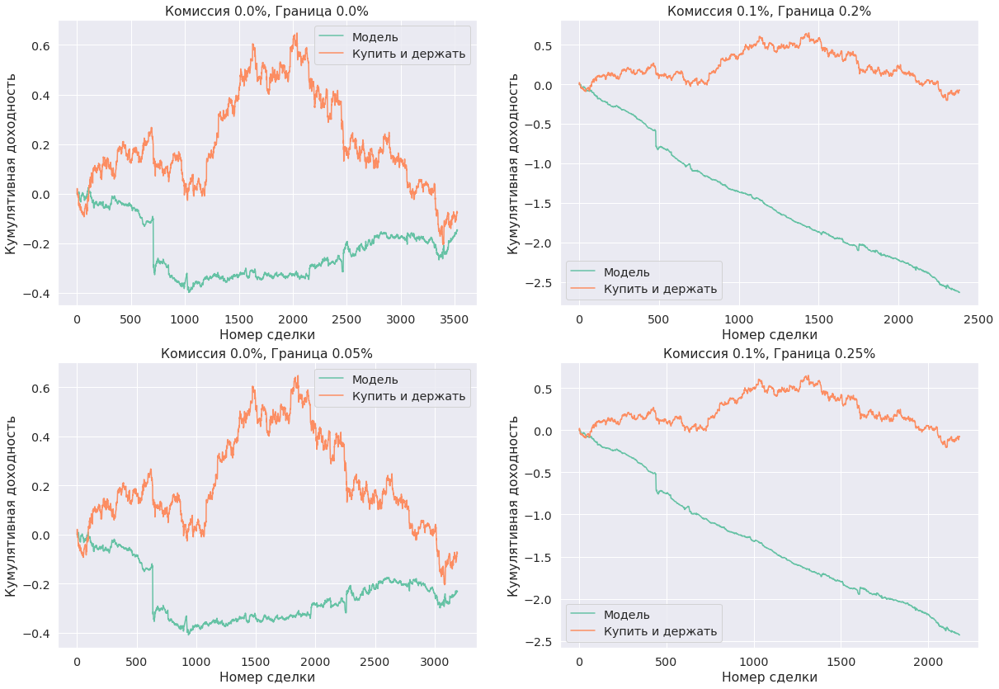

In [ ]:
model6 = Model6().to(device)
optimizer = torch.optim.Adam(params=model6.parameters(), lr=1e-3)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30], gamma=0.1)

model6, history = train(
    model6, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model6',
)

In [ ]:
for metric in history:
    for data_type in history[metric]:
        history[metric][data_type] = history[metric][data_type][25:]

Epoch 4 of 50 took 29.792s
  training loss: 	941.125104
  training mae: 	12.734305
  training profit: 	18.208 %
  training profit ths: 	16.022 %
  training profit fee: 	-1388.742 %
  training profit fee ths: 	-1471.981 %
  val loss: 	8.954062 	(8.279845)
  val mae: 	1.553377 	(1.544485)
  val profit: 	-4.077 % 	(11.603 %)
  val profit ths: 	-4.937 % 	(6.966 %)
  val profit fee: 	-262.108 % 	(-241.652 %)
  val profit fee ths: 	-243.173 % 	(-222.907 %)


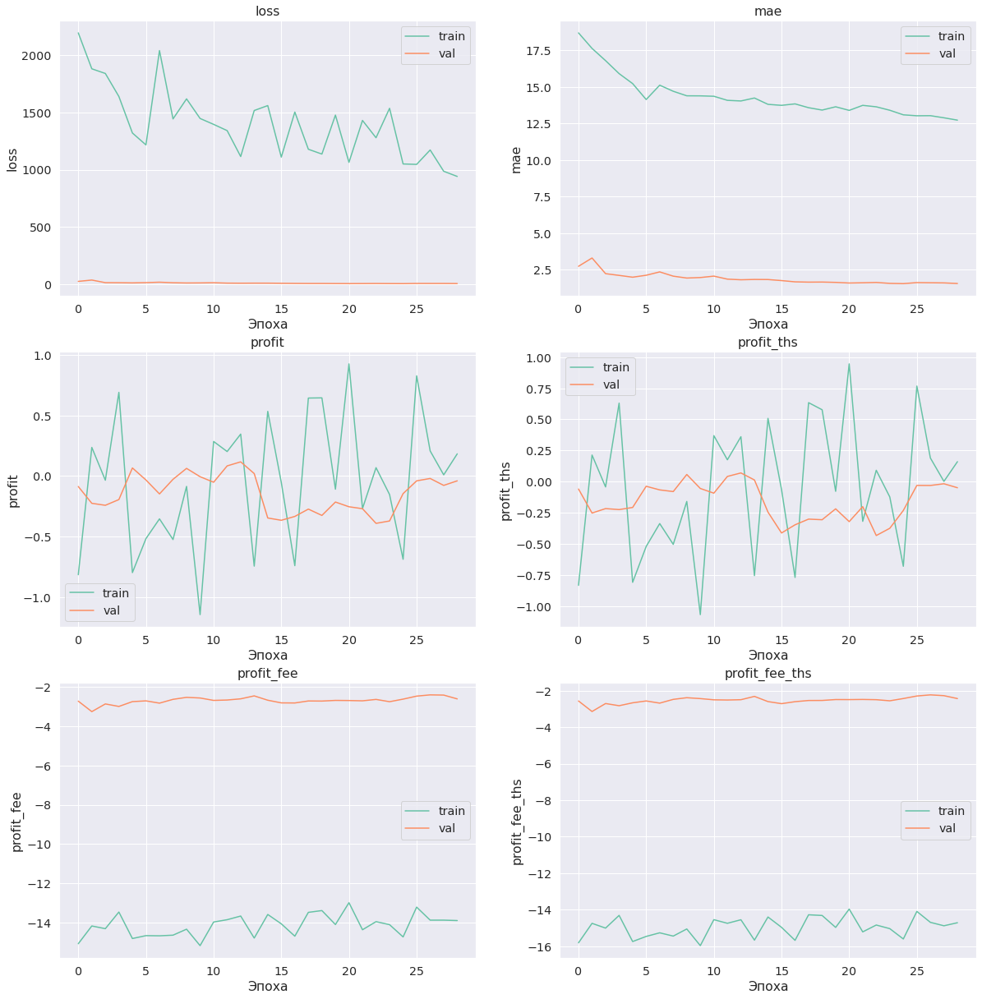

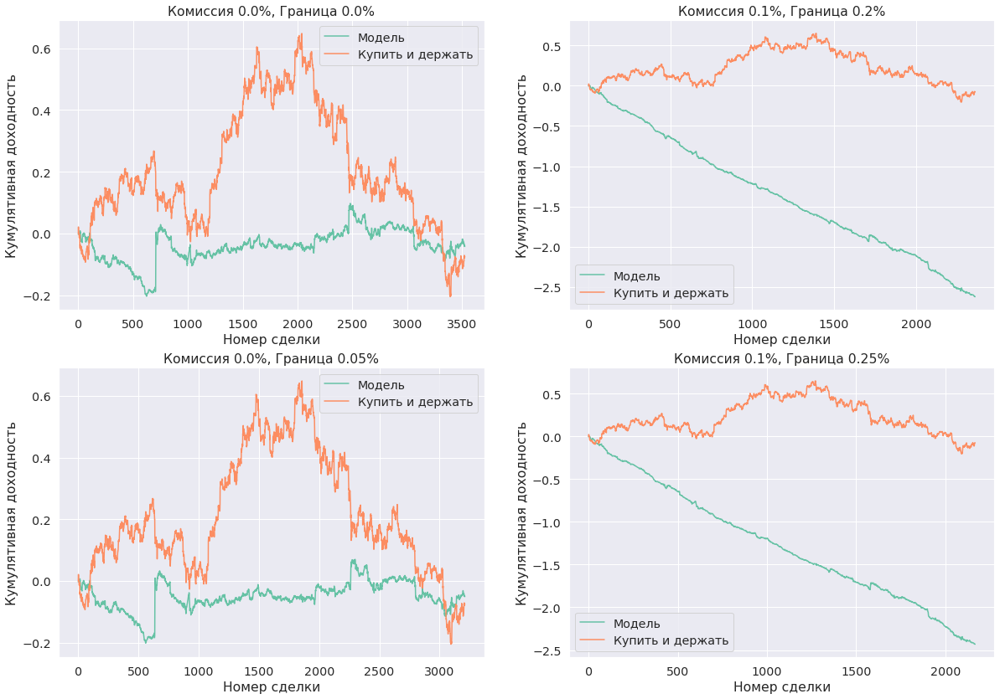

  0%|          | 0/60 [00:00<?, ?it/s]

In [ ]:
model6, history = train(
    model6, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    history=history,
    scheduler=scheduler,
    num_epochs=50,
    save_name='Model6_2',
)

In [ ]:
device = 'cpu'

In [ ]:
model3 = Model3().to(device)
train_info = torch.load(MODELS_DIR + 'Model3_profit_fee_ths.data', map_location=torch.device(device))
model3.load_state_dict(train_info['model_state_dict'])

<All keys matched successfully>

In [ ]:
# predict(model3, criterion, train_dataloader)

  0%|          | 0/63 [00:00<?, ?it/s]

IndexError: ignored

## Part 3 (GRU, only news)

In [ ]:
class ModelGRU1(nn.Module):
    def __init__(self, embedding_size=100, hidden_size=40):
        super(ModelGRU1, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_size, 
            num_layers=2, 
            batch_first=True, 
            bidirectional=True,
            dropout=0.5
        )
        
        self.dropout0 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(8 * hidden_size, 128)
        # self.norm = nn.BatchNorm1d(128)
        self.dropout1 = nn.Dropout(0.3)

        self.fc2 = nn.Linear(128, 1)

    def forward(self, text, text_len, X=None):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded = self.embedding(text)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_in = nn.utils.rnn.pack_padded_sequence(
            embedded, 
            text_len,
            batch_first=True,
            enforce_sorted=False
        )
        packed_out, hidden_state = self.gru(packed_in)
        out, lengths = nn.utils.rnn.pad_packed_sequence(packed_out, batch_first=True, total_length=MAX_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool = torch.sum(out, dim=1) / lengths.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out, lengths)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat = torch.cat([hidden_state[-1], hidden_state[-2], 
                              hidden_state[-3], hidden_state[-4], 
                              avg_pool, max_pool], dim=1)
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output = self.fc1(self.dropout0(pool_cat))
        # output = self.norm(output)
        output = F.leaky_relu(self.dropout1(output))

        output = self.fc2(output)
        return output

Epoch 75 of 75 took 43.377s
  training loss: 	0.178270
  training mae: 	0.263358
  training profit: 	4835.480 %
  training profit ths: 	4564.115 %
  training profit fee: 	2670.871 %
  training profit fee ths: 	3480.552 %
  val loss: 	0.414887 	(0.238609)
  val mae: 	0.446952 	(0.314739)
  val profit: 	-28.048 % 	(15.008 %)
  val profit ths: 	-36.183 % 	(15.709 %)
  val profit fee: 	-94.230 % 	(0.000 %)
  val profit fee ths: 	-77.580 % 	(0.000 %)


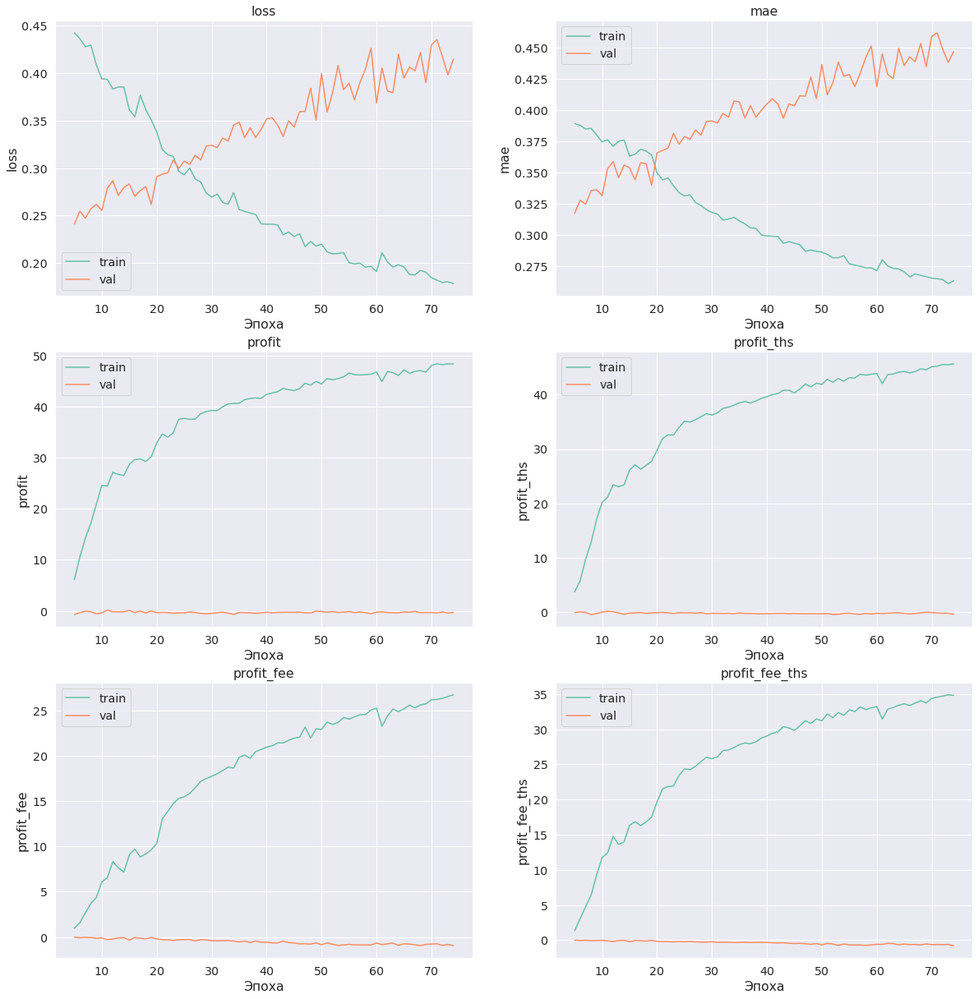

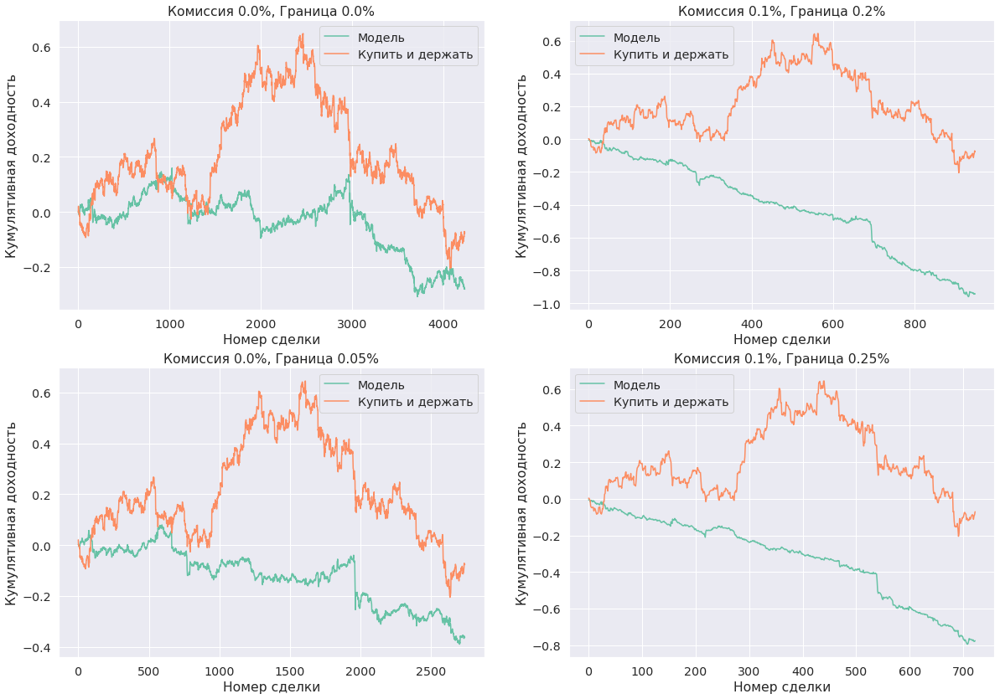

In [ ]:
model_gru1 = ModelGRU1().to(device)
optimizer = torch.optim.Adam(params=model_gru1.parameters(), lr=1e-2)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[20], gamma=0.1)

model_gru1, history = train(
    model_gru1, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=75,
    save_name='ModelGRU1',
)

Epoch 25 of 25 took 43.405s
  training loss: 	0.140270
  training mae: 	0.235842
  training profit: 	5153.827 %
  training profit ths: 	4867.512 %
  training profit fee: 	2939.897 %
  training profit fee ths: 	3785.943 %
  val loss: 	0.483723 	(0.238609)
  val mae: 	0.481526 	(0.314739)
  val profit: 	-8.050 % 	(15.008 %)
  val profit ths: 	-2.306 % 	(15.709 %)
  val profit fee: 	-114.057 % 	(0.000 %)
  val profit fee ths: 	-88.901 % 	(0.000 %)


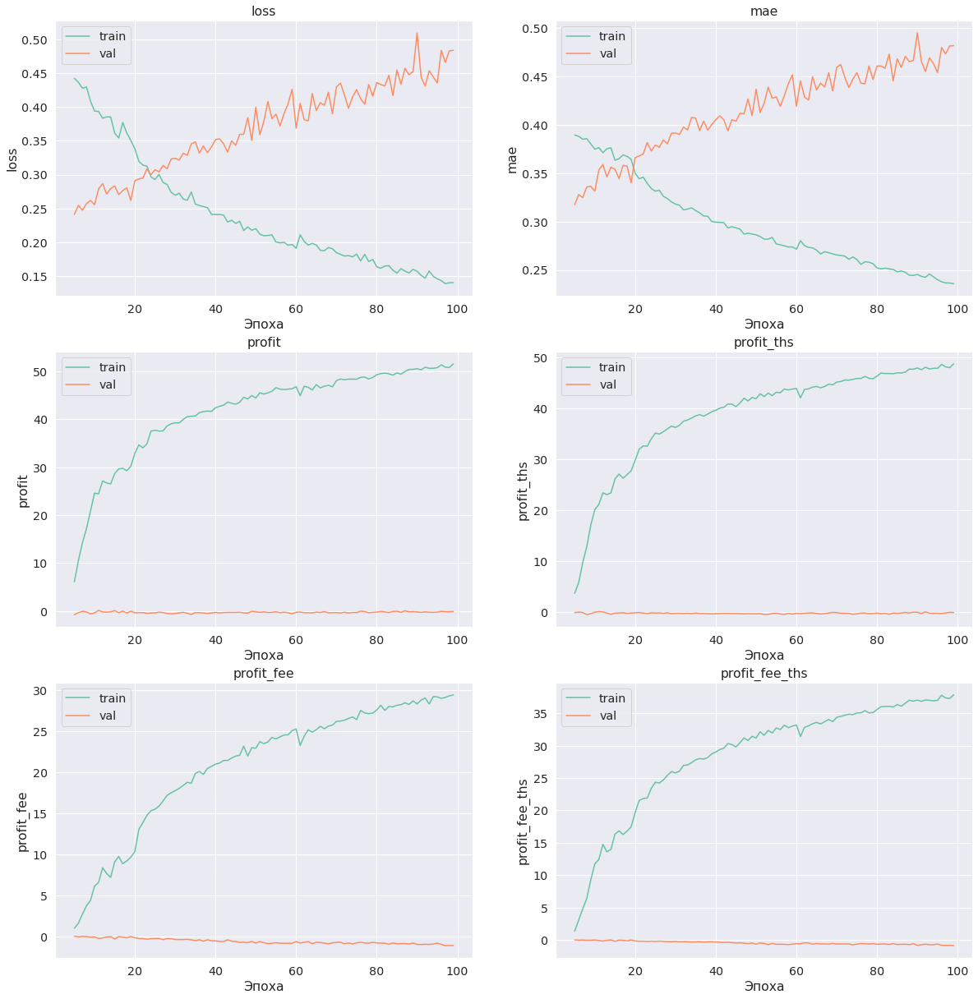

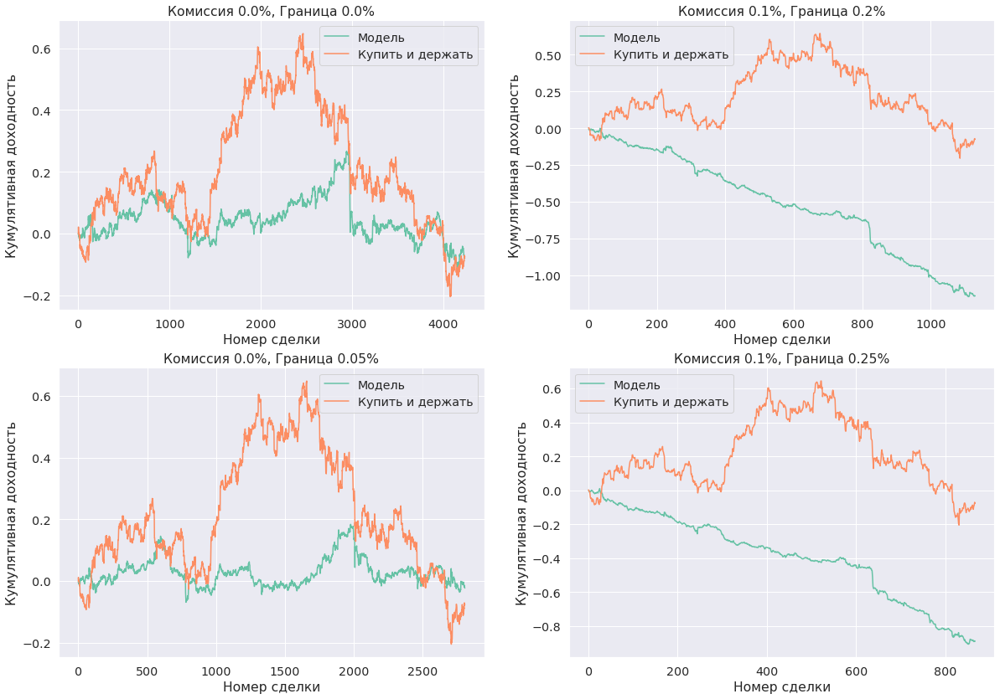

In [ ]:
model_gru1, history = train(
    model_gru1, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    history=history,
    scheduler=scheduler,
    num_epochs=25,
    save_name='ModelGRU1',
)

Epoch 140 of 150 took 43.113s
  training loss: 	0.447032
  training mae: 	0.386617
  training profit: 	165.676 %
  training profit ths: 	0.000 %
  training profit fee: 	0.000 %
  training profit fee ths: 	0.000 %
  val loss: 	0.238354 	(0.238308)
  val mae: 	0.314898 	(0.314796)
  val profit: 	10.632 % 	(12.463 %)
  val profit ths: 	0.000 % 	(0.000 %)
  val profit fee: 	0.000 % 	(0.000 %)
  val profit fee ths: 	0.000 % 	(0.000 %)


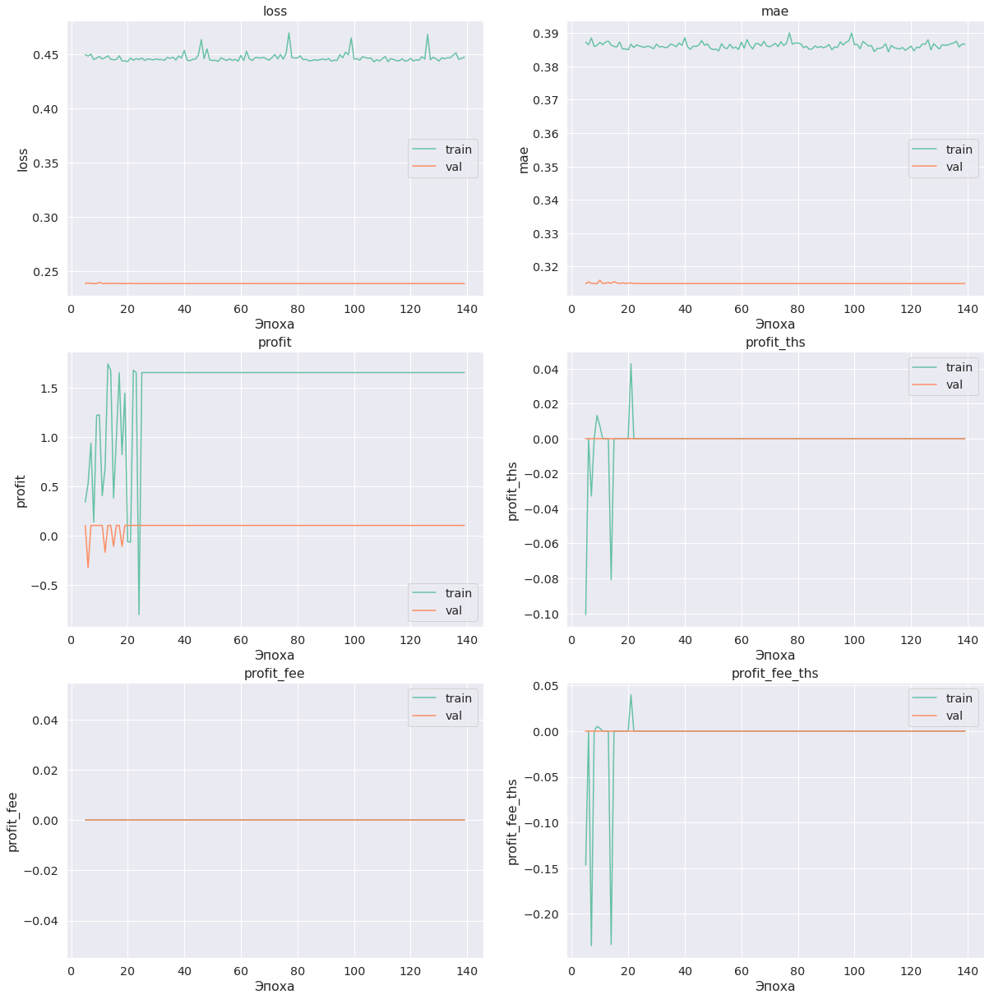

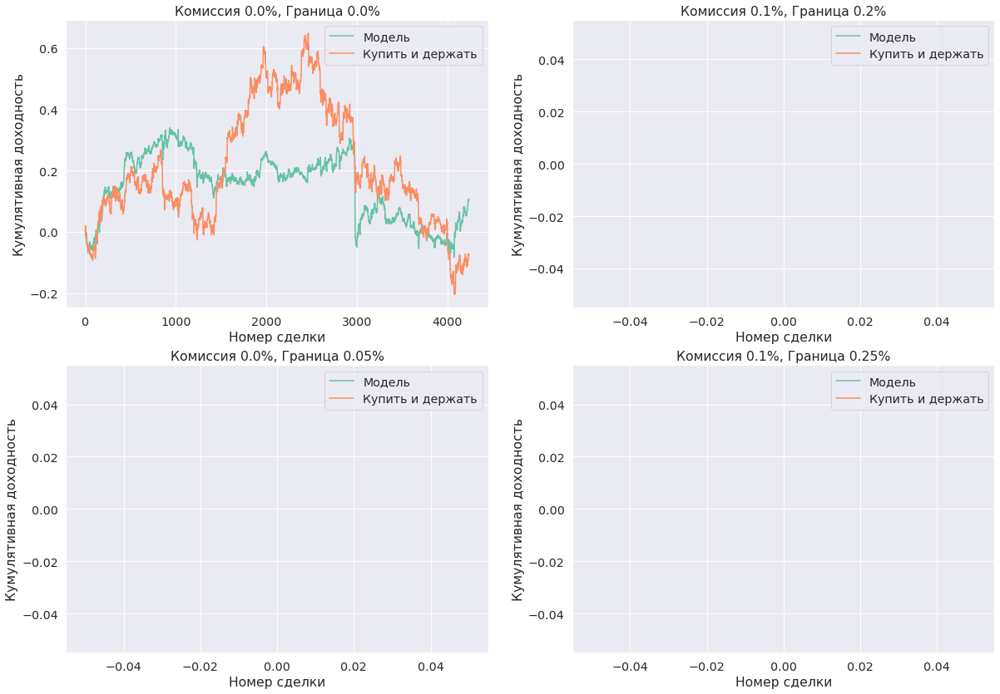

  0%|          | 0/66 [00:00<?, ?it/s]

In [ ]:
model_gru2 = ModelGRU1().to(device)
optimizer = torch.optim.Adam(params=model_gru2.parameters(), lr=1e-2, weight_decay=5e-5)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[25, 100], gamma=0.1)

model_gru2, history = train(
    model_gru2, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=150,
    save_name='ModelGRU2',
)

## Part 4 (GRU, news + indicators)

In [80]:
class ModelGRU_IND1(nn.Module):
    def __init__(self, embedding_size=100, hidden_news_size=40, hidden_title_size=20):
        super(ModelGRU_IND1, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru_news = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_news_size, 
            num_layers=2, 
            batch_first=True, 
            bidirectional=True,
            dropout=0.5
        )
        
        self.dropout_news0 = nn.Dropout(0.5)
        self.fc_news1 = nn.Linear(8 * hidden_news_size, 64)
        self.norm_news1 = nn.BatchNorm1d(64)
        self.dropout_news1 = nn.Dropout(0.3)

        # -------

        self.gru_titles = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_title_size, 
            num_layers=2, 
            batch_first=True, 
            bidirectional=True,
            dropout=0.4
        )

        self.dropout_title0 = nn.Dropout(0.5)
        self.fc_title1 = nn.Linear(8 * hidden_title_size, 64)
        self.norm_title1 = nn.BatchNorm1d(64)
        self.dropout_title1 = nn.Dropout(0.3)
        
        # -------

        self.fc1_X = nn.Linear(X.shape[1], 256)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(256, 64)
        self.norm2_X = nn.BatchNorm1d(64)
        self.dropout2_X = nn.Dropout(0.3)

        # -------

        self.fc2 = nn.Linear(64 + 64 + 64, 32)
        self.norm2 = nn.BatchNorm1d(32)
        self.dropout2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(32, 1)

    def forward(self, text, text_len, title, title_len, X):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded_news = self.embedding(text)
        embedded_titles = self.embedding(title)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_news_in = nn.utils.rnn.pack_padded_sequence(
            embedded_news, text_len,
            batch_first=True, enforce_sorted=False
        )
        packed_titles_in = nn.utils.rnn.pack_padded_sequence(
            embedded_titles, title_len,
            batch_first=True, enforce_sorted=False
        )
        packed_news_out, hidden_news_state = self.gru_news(packed_news_in)
        packed_titles_out, hidden_titles_state = self.gru_titles(packed_titles_in)
        
        out_news, lengths_news = nn.utils.rnn.pad_packed_sequence(packed_news_out, 
                                                                  batch_first=True, 
                                                                  total_length=MAX_LEN)
        out_titles, lengths_titles = nn.utils.rnn.pad_packed_sequence(packed_titles_out, 
                                                                      batch_first=True, 
                                                                      total_length=MAX_TITLE_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool_news = torch.sum(out_news, dim=1) / lengths_news.to(device).view(-1, 1)
        avg_pool_titles = torch.sum(out_titles, dim=1) / lengths_titles.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool_news = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_news, lengths_news)], dim=0)
        max_pool_titles = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_titles, lengths_titles)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat_news = torch.cat([hidden_news_state[-1], hidden_news_state[-2], 
                                   hidden_news_state[-3], hidden_news_state[-4], 
                                   avg_pool_news, max_pool_news], dim=1)
        pool_cat_titles = torch.cat([hidden_titles_state[-1], hidden_titles_state[-2], 
                                     hidden_titles_state[-3], hidden_titles_state[-4], 
                                     avg_pool_titles, max_pool_titles], dim=1)
        
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output_news = self.fc_news1(self.dropout_news0(pool_cat_news))
        output_titles = self.fc_title1(self.dropout_title0(pool_cat_titles))
        # output = self.norm(output)
        output_news = F.leaky_relu(self.dropout_news1(output_news))
        output_titles = F.leaky_relu(self.dropout_title1(output_titles))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = F.leaky_relu(self.dropout2_X(self.norm2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc2(torch.cat([output_news, output_titles, X_out], dim=1))
        output = F.relu(self.dropout2(self.norm2(output)))
        output = self.fc3(output)
        return output

Epoch 75 of 75 took 12.542s
  training loss: 	0.078732
  training mae: 	0.183654
  training profit: 	4286.983 %
  training profit ths: 	4007.072 %
  training profit fee: 	2447.033 %
  training profit fee ths: 	3143.146 %
  val loss: 	0.286030 	(0.216029)
  val mae: 	0.372670 	(0.314868)
  val profit: 	-7.807 % 	(20.393 %)
  val profit ths: 	22.554 % 	(28.806 %)
  val profit fee: 	-28.777 % 	(0.010 %)
  val profit fee ths: 	-19.454 % 	(0.010 %)


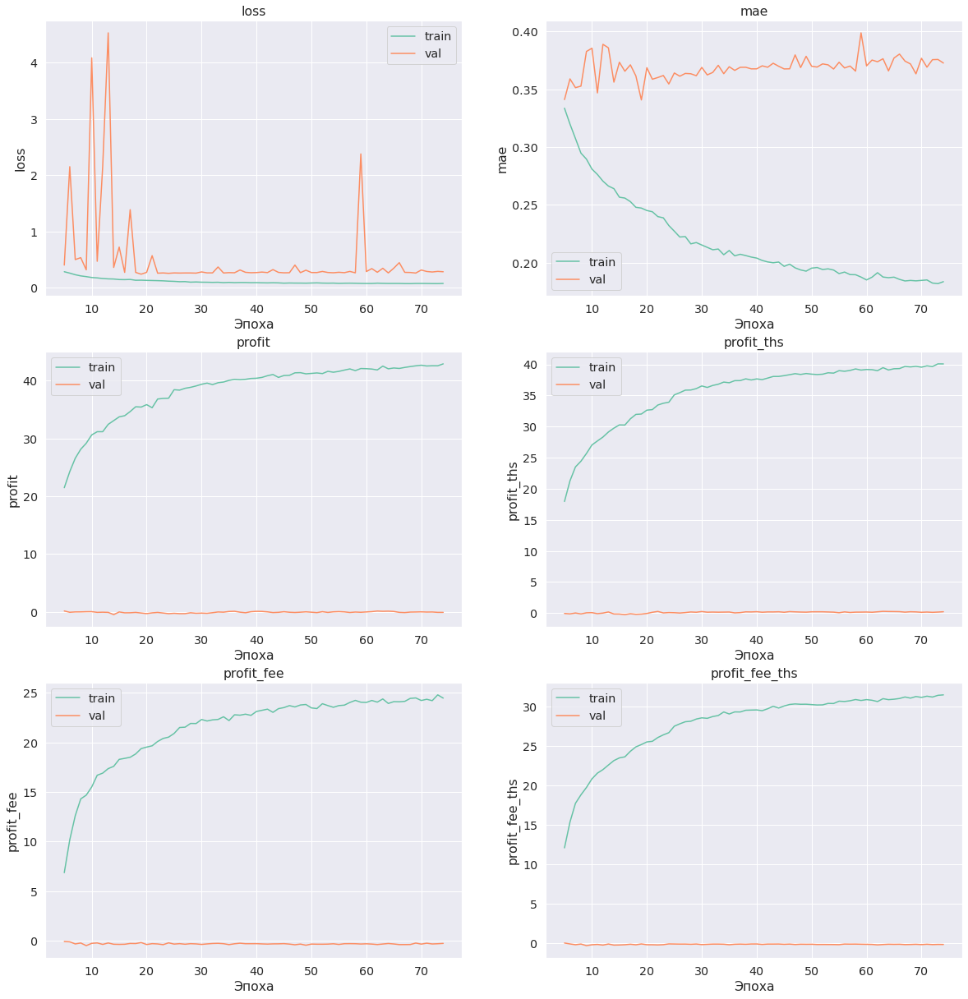

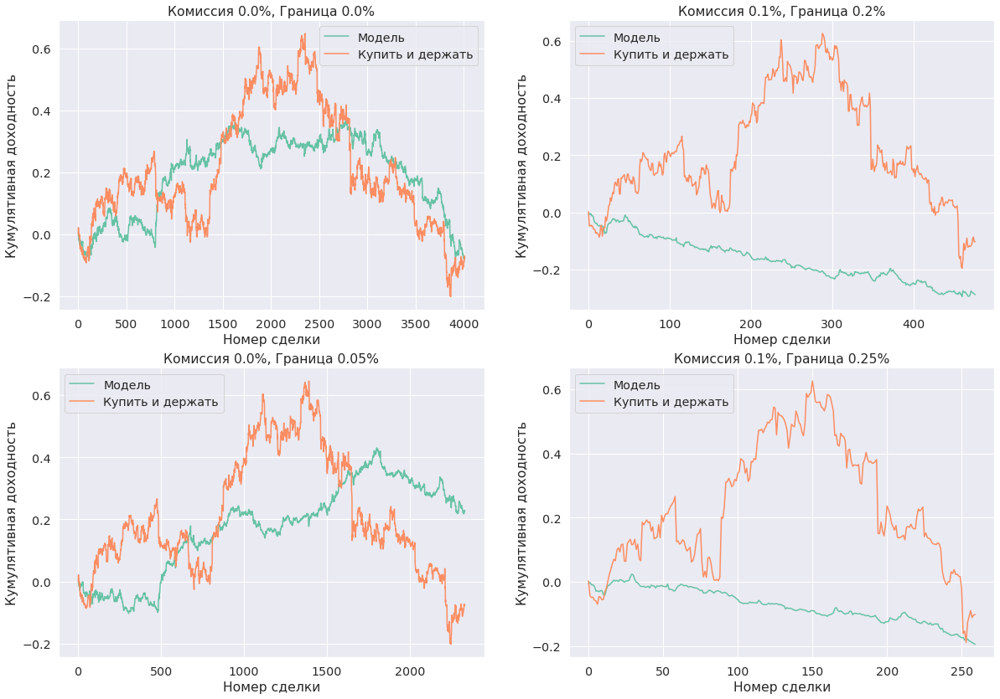

In [81]:
model_gru_ind1 = ModelGRU_IND1().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind1.parameters(), lr=1e-2)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[25], gamma=0.1)

model_gru_ind1, history = train(
    model_gru_ind1, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=75,
    save_name='ModelGRU_IND1',
    step_plotting=5,
)

Epoch 100 of 100 took 12.657s
  training loss: 	0.068970
  training mae: 	0.163931
  training profit: 	4357.632 %
  training profit ths: 	4107.215 %
  training profit fee: 	2538.884 %
  training profit fee ths: 	3242.462 %
  val loss: 	0.287029 	(0.201833)
  val mae: 	0.377669 	(0.305977)
  val profit: 	-19.554 % 	(22.723 %)
  val profit ths: 	-22.510 % 	(11.197 %)
  val profit fee: 	-66.481 % 	(1.124 %)
  val profit fee ths: 	-42.112 % 	(0.010 %)


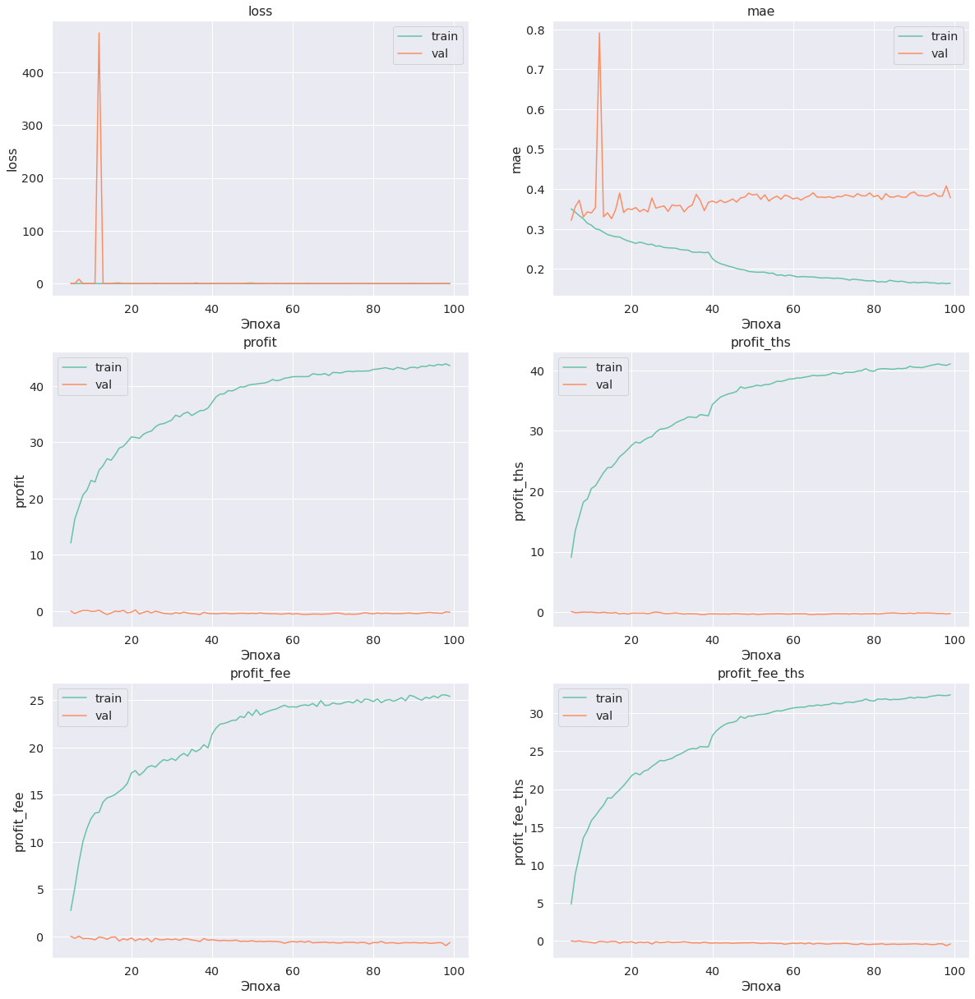

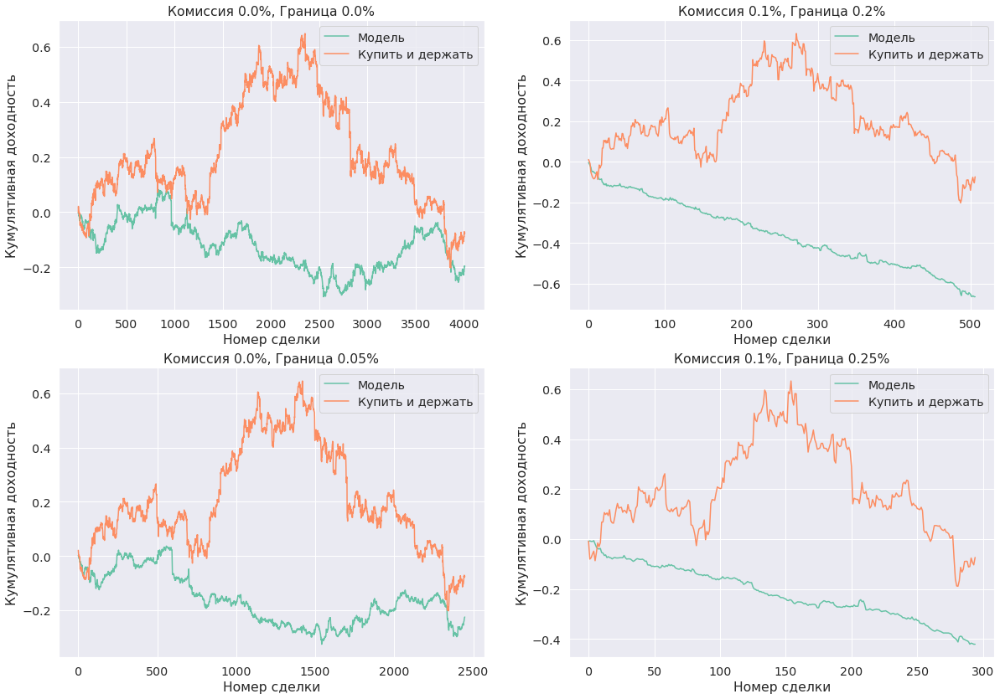

In [82]:
model_gru_ind2 = ModelGRU_IND1().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind2.parameters(), lr=1e-2, weight_decay=1e-5)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40], gamma=0.1)

model_gru_ind2, history = train(
    model_gru_ind2, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND2',
    step_plotting=5,
)

In [85]:
class ModelGRU_IND3(nn.Module):
    def __init__(self, embedding_size=80, hidden_news_size=30, hidden_title_size=30):
        super(ModelGRU_IND3, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru_news = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_news_size, 
            num_layers=2, 
            batch_first=True, 
            bidirectional=True,
            dropout=0.5
        )
        
        self.dropout_news0 = nn.Dropout(0.5)
        self.fc_news1 = nn.Linear(8 * hidden_news_size, 48)
        self.norm_news1 = nn.BatchNorm1d(48)
        self.dropout_news1 = nn.Dropout(0.4)

        # -------

        self.gru_titles = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_title_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=True,
            # dropout=0.4
        )

        self.dropout_title0 = nn.Dropout(0.5)
        self.fc_title1 = nn.Linear(6 * hidden_title_size, 32)
        self.norm_title1 = nn.BatchNorm1d(32)
        self.dropout_title1 = nn.Dropout(0.3)
        
        # -------

        self.fc1_X = nn.Linear(X.shape[1], 128)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(128, 64)
        self.norm2_X = nn.BatchNorm1d(64)
        self.dropout2_X = nn.Dropout(0.4)

        # -------

        self.fc2 = nn.Linear(64 + 48 + 32, 32)
        self.norm2 = nn.BatchNorm1d(32)
        self.dropout2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(32, 1)

    def forward(self, text, text_len, title, title_len, X):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded_news = self.embedding(text)
        embedded_titles = self.embedding(title)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_news_in = nn.utils.rnn.pack_padded_sequence(
            embedded_news, text_len,
            batch_first=True, enforce_sorted=False
        )
        packed_titles_in = nn.utils.rnn.pack_padded_sequence(
            embedded_titles, title_len,
            batch_first=True, enforce_sorted=False
        )
        packed_news_out, hidden_news_state = self.gru_news(packed_news_in)
        packed_titles_out, hidden_titles_state = self.gru_titles(packed_titles_in)
        
        out_news, lengths_news = nn.utils.rnn.pad_packed_sequence(packed_news_out, 
                                                                  batch_first=True, 
                                                                  total_length=MAX_LEN)
        out_titles, lengths_titles = nn.utils.rnn.pad_packed_sequence(packed_titles_out, 
                                                                      batch_first=True, 
                                                                      total_length=MAX_TITLE_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool_news = torch.sum(out_news, dim=1) / lengths_news.to(device).view(-1, 1)
        avg_pool_titles = torch.sum(out_titles, dim=1) / lengths_titles.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool_news = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_news, lengths_news)], dim=0)
        max_pool_titles = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_titles, lengths_titles)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat_news = torch.cat([hidden_news_state[-1], hidden_news_state[-2], 
                                   hidden_news_state[-3], hidden_news_state[-4], 
                                   avg_pool_news, max_pool_news], dim=1)
        pool_cat_titles = torch.cat([hidden_titles_state[-1], hidden_titles_state[-2], 
                                     avg_pool_titles, max_pool_titles], dim=1)
        
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output_news = self.fc_news1(self.dropout_news0(pool_cat_news))
        output_titles = self.fc_title1(self.dropout_title0(pool_cat_titles))
        # output_news = self.norm_news1(output_news)
        # output_titles = self.norm_title1(output_titles)
        output_news = F.leaky_relu(self.dropout_news1(output_news))
        output_titles = F.leaky_relu(self.dropout_title1(output_titles))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = F.leaky_relu(self.dropout2_X(self.norm2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc2(torch.cat([output_news, output_titles, X_out], dim=1))
        output = F.relu(self.dropout2(self.norm2(output)))
        output = self.fc3(output)
        return output

Epoch 100 of 100 took 11.615s
  training loss: 	0.062250
  training mae: 	0.158861
  training profit: 	4511.037 %
  training profit ths: 	4233.247 %
  training profit fee: 	2576.651 %
  training profit fee ths: 	3318.255 %
  val loss: 	2.508672 	(0.207919)
  val mae: 	0.392905 	(0.308764)
  val profit: 	-43.097 % 	(20.089 %)
  val profit ths: 	-21.575 % 	(8.196 %)
  val profit fee: 	-39.960 % 	(0.010 %)
  val profit fee ths: 	-19.294 % 	(0.010 %)


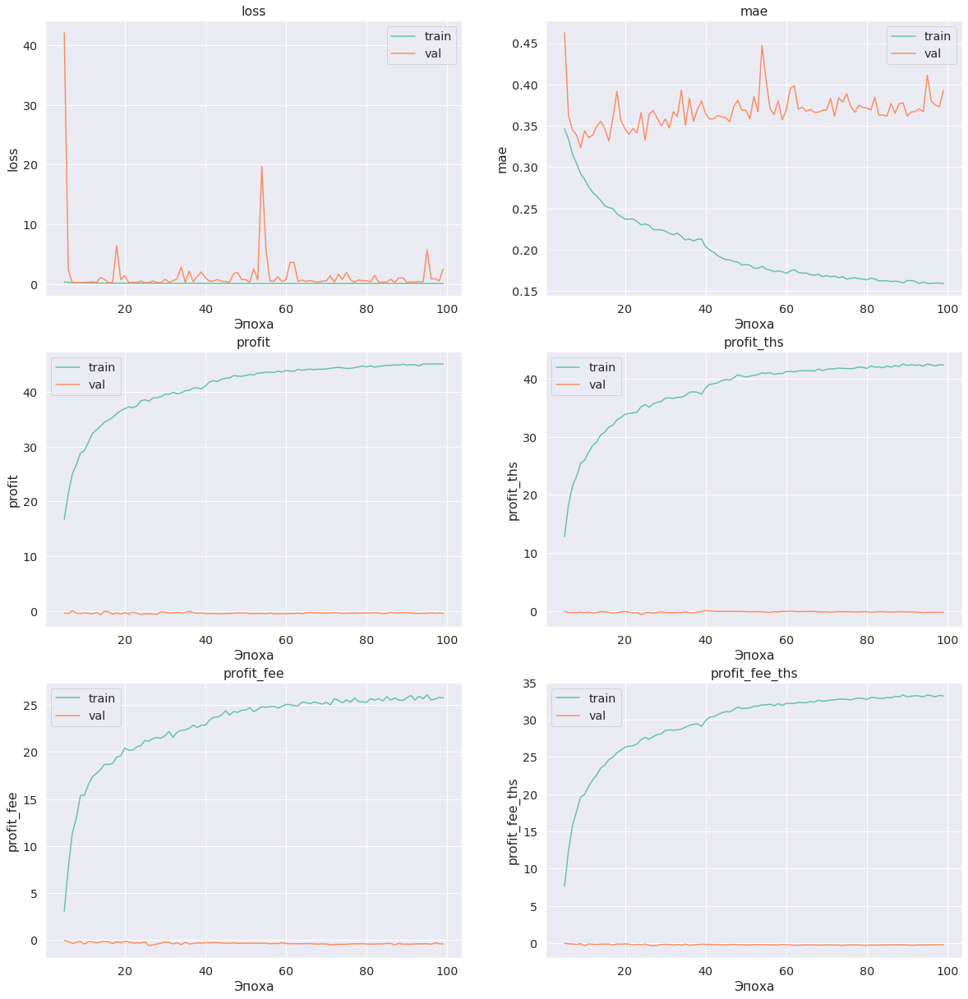

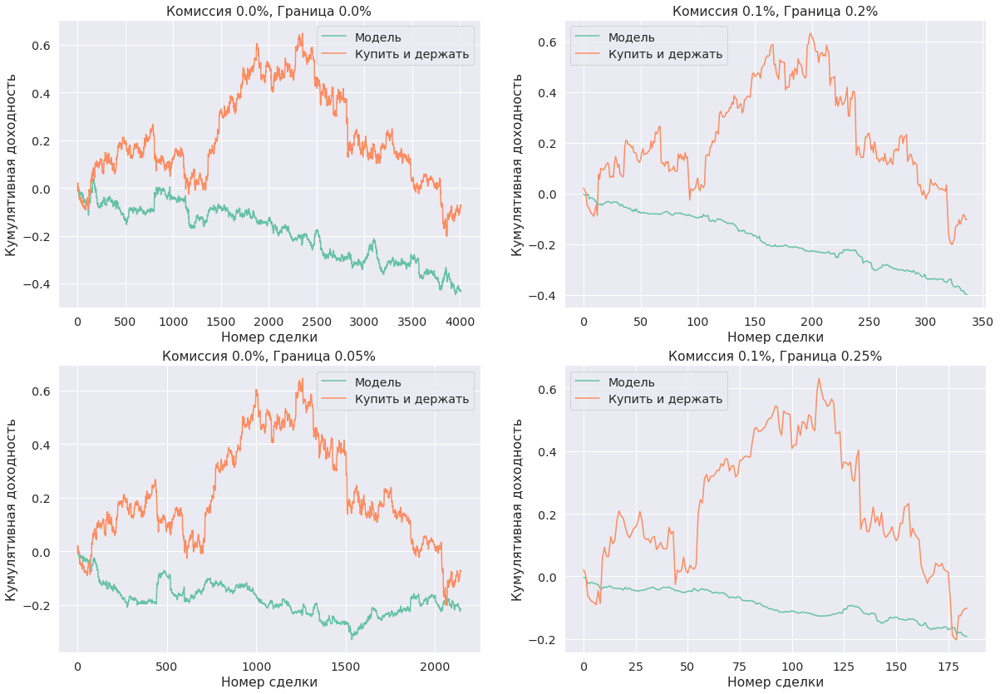

In [86]:
model_gru_ind3 = ModelGRU_IND3().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind3.parameters(), lr=1e-2, weight_decay=1e-6)
criterion = nn.MSELoss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40], gamma=0.1)

model_gru_ind3, history = train(
    model_gru_ind3, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND3',
    step_plotting=5,
)

Epoch 50 of 50 took 11.640s
  training loss: 	0.059133
  training mae: 	0.152055
  training profit: 	4542.172 %
  training profit ths: 	4277.222 %
  training profit fee: 	2609.911 %
  training profit fee ths: 	3351.987 %
  val loss: 	0.263355 	(0.260328)
  val mae: 	0.364758 	(0.360075)
  val profit: 	-41.623 % 	(-31.974 %)
  val profit ths: 	-26.697 % 	(-18.731 %)
  val profit fee: 	-44.932 % 	(-30.956 %)
  val profit fee ths: 	-20.564 % 	(-17.605 %)


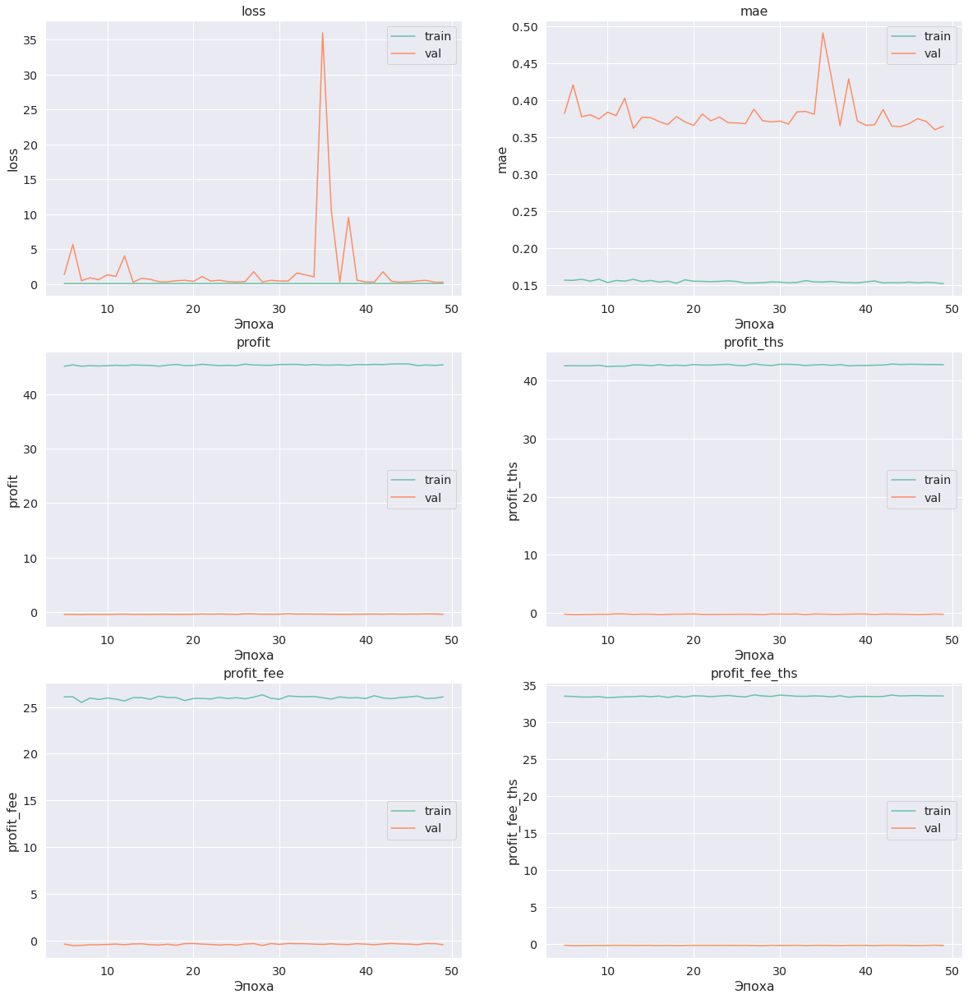

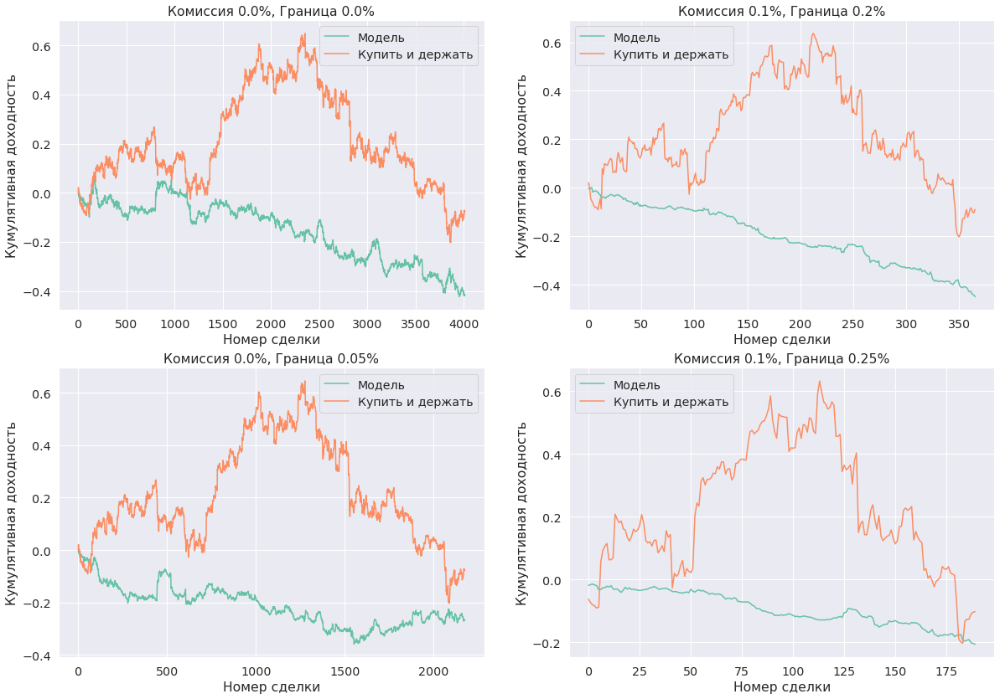

In [89]:
optimizer.param_groups[0]['lr'] = 1e-4

model_gru_ind3, history = train(
    model_gru_ind3, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=50,
    save_name='ModelGRU_IND3',
    step_plotting=5,
)

Epoch 100 of 100 took 14.352s
  training loss: 	0.147566
  training mae: 	0.147566
  training profit: 	4479.042 %
  training profit ths: 	4192.565 %
  training profit fee: 	2411.241 %
  training profit fee ths: 	3256.417 %
  val loss: 	0.353292 	(0.310120)
  val mae: 	0.353292 	(0.310120)
  val profit: 	-22.123 % 	(52.654 %)
  val profit ths: 	5.147 % 	(18.075 %)
  val profit fee: 	-14.566 % 	(2.030 %)
  val profit fee ths: 	-2.724 % 	(3.292 %)


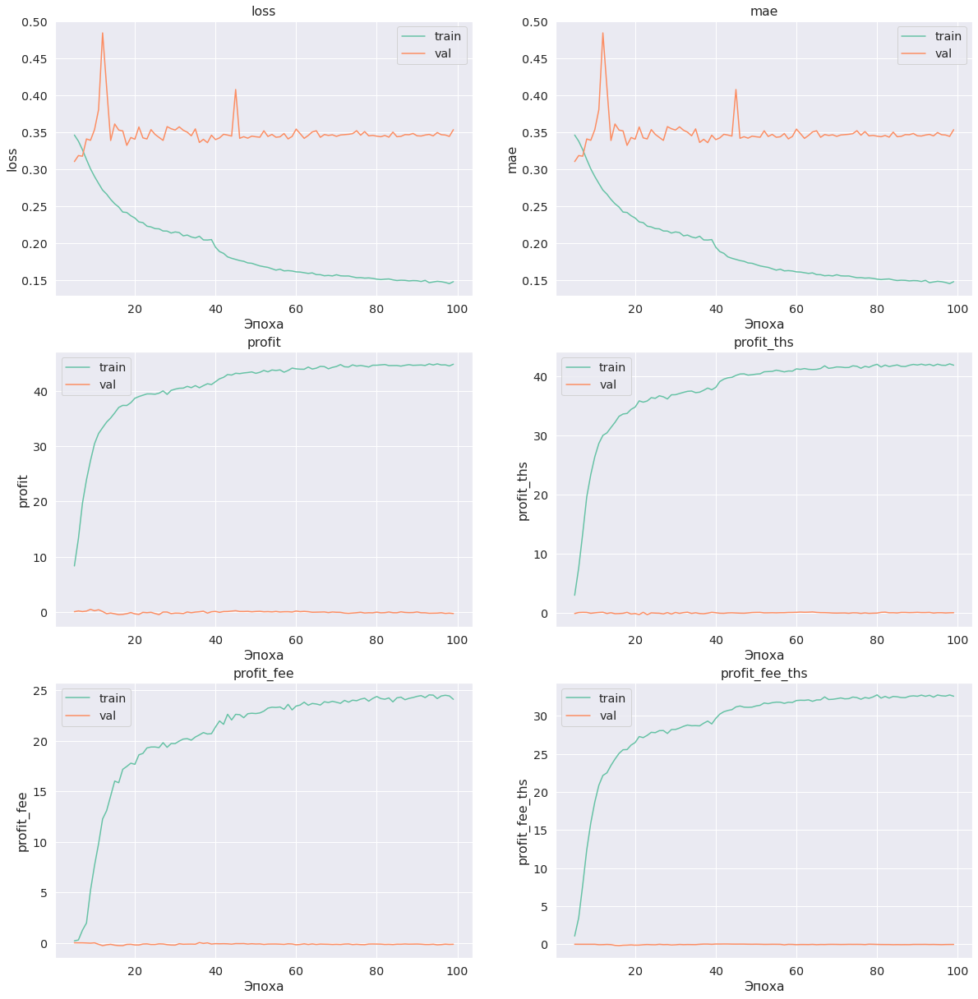

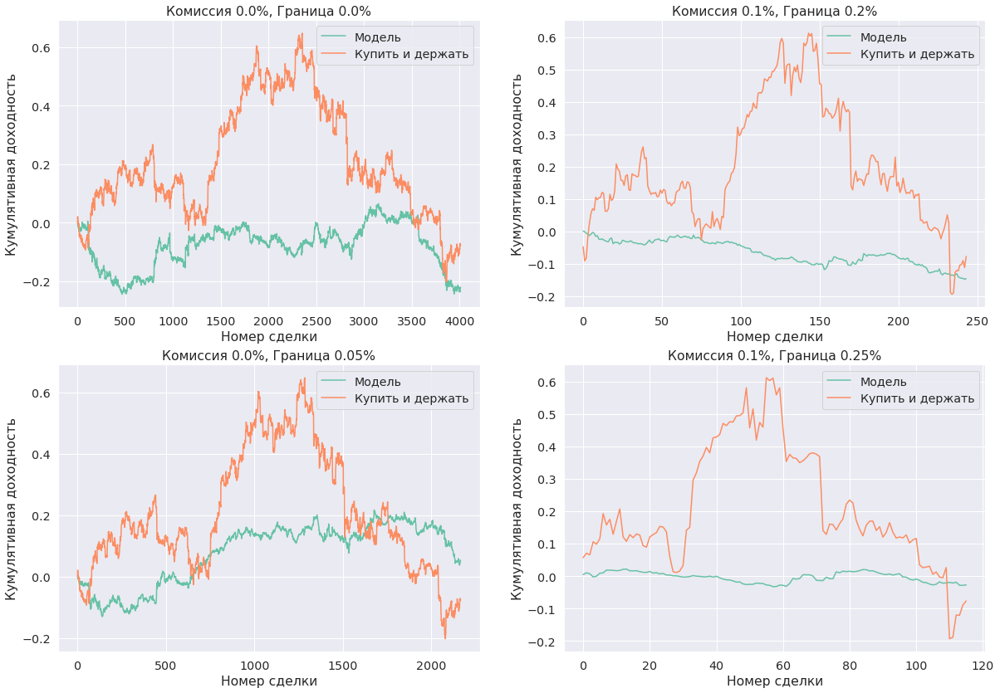

In [90]:
model_gru_ind4 = ModelGRU_IND3().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind4.parameters(), lr=1e-2, weight_decay=1e-6)
criterion = nn.L1Loss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40], gamma=0.1)

model_gru_ind4, history = train(
    model_gru_ind4, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND4',
    step_plotting=5,
)

In [98]:
class ModelGRU_IND5(nn.Module):
    def __init__(self, embedding_size=80, hidden_news_size=40, hidden_title_size=40):
        super(ModelGRU_IND5, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru_news = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_news_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.5
        )
        
        self.dropout_news0 = nn.Dropout(0.5)
        self.fc_news1 = nn.Linear(3 * hidden_news_size, 48)
        self.norm_news1 = nn.BatchNorm1d(48)
        self.dropout_news1 = nn.Dropout(0.4)

        # -------

        self.gru_titles = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_title_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.4
        )

        self.dropout_title0 = nn.Dropout(0.5)
        self.fc_title1 = nn.Linear(3 * hidden_title_size, 32)
        self.norm_title1 = nn.BatchNorm1d(32)
        self.dropout_title1 = nn.Dropout(0.3)
        
        # -------

        self.fc1_X = nn.Linear(X.shape[1], 128)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(128, 64)
        self.norm2_X = nn.BatchNorm1d(64)
        self.dropout2_X = nn.Dropout(0.4)

        # -------

        self.fc2 = nn.Linear(64 + 48 + 32, 32)
        self.norm2 = nn.BatchNorm1d(32)
        self.dropout2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(32, 1)

    def forward(self, text, text_len, title, title_len, X):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded_news = self.embedding(text)
        embedded_titles = self.embedding(title)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_news_in = nn.utils.rnn.pack_padded_sequence(
            embedded_news, text_len,
            batch_first=True, enforce_sorted=False
        )
        packed_titles_in = nn.utils.rnn.pack_padded_sequence(
            embedded_titles, title_len,
            batch_first=True, enforce_sorted=False
        )
        packed_news_out, hidden_news_state = self.gru_news(packed_news_in)
        packed_titles_out, hidden_titles_state = self.gru_titles(packed_titles_in)
        
        out_news, lengths_news = nn.utils.rnn.pad_packed_sequence(packed_news_out, 
                                                                  batch_first=True, 
                                                                  total_length=MAX_LEN)
        out_titles, lengths_titles = nn.utils.rnn.pad_packed_sequence(packed_titles_out, 
                                                                      batch_first=True, 
                                                                      total_length=MAX_TITLE_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool_news = torch.sum(out_news, dim=1) / lengths_news.to(device).view(-1, 1)
        avg_pool_titles = torch.sum(out_titles, dim=1) / lengths_titles.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool_news = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_news, lengths_news)], dim=0)
        max_pool_titles = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_titles, lengths_titles)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat_news = torch.cat([hidden_news_state[-1],
                                   avg_pool_news, max_pool_news], dim=1)
        pool_cat_titles = torch.cat([hidden_titles_state[-1],
                                     avg_pool_titles, max_pool_titles], dim=1)
        
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output_news = self.fc_news1(self.dropout_news0(pool_cat_news))
        output_titles = self.fc_title1(self.dropout_title0(pool_cat_titles))
        # output_news = self.norm_news1(output_news)
        # output_titles = self.norm_title1(output_titles)
        output_news = F.leaky_relu(self.dropout_news1(output_news))
        output_titles = F.leaky_relu(self.dropout_title1(output_titles))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = F.leaky_relu(self.dropout2_X(self.norm2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc2(torch.cat([output_news, output_titles, X_out], dim=1))
        output = F.relu(self.dropout2(self.norm2(output)))
        output = self.fc3(output)
        return output

Epoch 100 of 100 took 8.316s
  training loss: 	0.151470
  training mae: 	0.151470
  training profit: 	4481.945 %
  training profit ths: 	4213.497 %
  training profit fee: 	2434.998 %
  training profit fee ths: 	3268.620 %
  val loss: 	0.351084 	(0.307153)
  val mae: 	0.351084 	(0.307153)
  val profit: 	-0.093 % 	(30.153 %)
  val profit ths: 	-0.118 % 	(17.659 %)
  val profit fee: 	-29.279 % 	(0.010 %)
  val profit fee ths: 	-17.216 % 	(0.010 %)


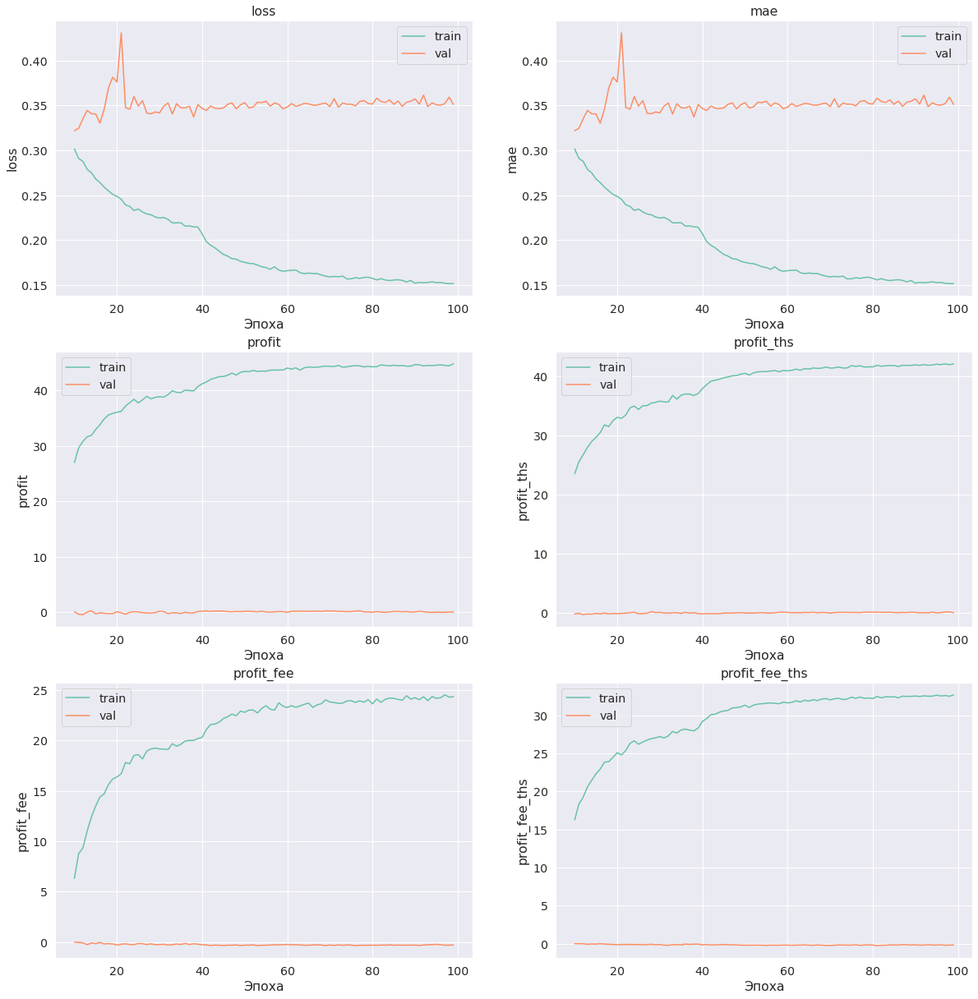

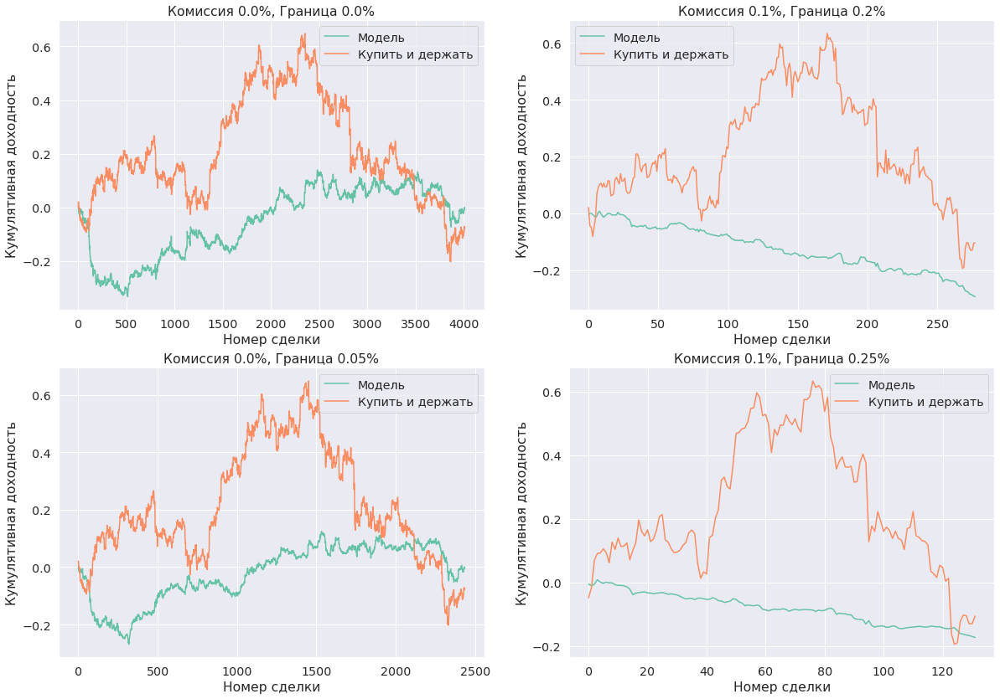

In [99]:
model_gru_ind5 = ModelGRU_IND5().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind5.parameters(), lr=1e-2, weight_decay=3e-6)
criterion = nn.L1Loss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40], gamma=0.1)

model_gru_ind5, history = train(
    model_gru_ind5, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND5',
    step_plotting=5,
)

In [100]:
class ModelGRU_IND6(nn.Module):
    def __init__(self, embedding_size=50, hidden_news_size=20, hidden_title_size=20):
        super(ModelGRU_IND6, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru_news = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_news_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.5
        )
        
        self.dropout_news0 = nn.Dropout(0.4)
        self.fc_news1 = nn.Linear(3 * hidden_news_size, 24)
        self.norm_news1 = nn.BatchNorm1d(24)
        self.dropout_news1 = nn.Dropout(0.3)

        # -------

        self.gru_titles = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_title_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.4
        )

        self.dropout_title0 = nn.Dropout(0.5)
        self.fc_title1 = nn.Linear(3 * hidden_title_size, 16)
        self.norm_title1 = nn.BatchNorm1d(16)
        self.dropout_title1 = nn.Dropout(0.3)
        
        # -------

        self.fc1_X = nn.Linear(X.shape[1], 64)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(64, 24)
        self.norm2_X = nn.BatchNorm1d(24)
        self.dropout2_X = nn.Dropout(0.4)

        # -------

        self.fc2 = nn.Linear(24 + 24 + 16, 16)
        self.norm2 = nn.BatchNorm1d(16)
        self.dropout2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(16, 1)

    def forward(self, text, text_len, title, title_len, X):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded_news = self.embedding(text)
        embedded_titles = self.embedding(title)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_news_in = nn.utils.rnn.pack_padded_sequence(
            embedded_news, text_len,
            batch_first=True, enforce_sorted=False
        )
        packed_titles_in = nn.utils.rnn.pack_padded_sequence(
            embedded_titles, title_len,
            batch_first=True, enforce_sorted=False
        )
        packed_news_out, hidden_news_state = self.gru_news(packed_news_in)
        packed_titles_out, hidden_titles_state = self.gru_titles(packed_titles_in)
        
        out_news, lengths_news = nn.utils.rnn.pad_packed_sequence(packed_news_out, 
                                                                  batch_first=True, 
                                                                  total_length=MAX_LEN)
        out_titles, lengths_titles = nn.utils.rnn.pad_packed_sequence(packed_titles_out, 
                                                                      batch_first=True, 
                                                                      total_length=MAX_TITLE_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool_news = torch.sum(out_news, dim=1) / lengths_news.to(device).view(-1, 1)
        avg_pool_titles = torch.sum(out_titles, dim=1) / lengths_titles.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool_news = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_news, lengths_news)], dim=0)
        max_pool_titles = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_titles, lengths_titles)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat_news = torch.cat([hidden_news_state[-1],
                                   avg_pool_news, max_pool_news], dim=1)
        pool_cat_titles = torch.cat([hidden_titles_state[-1],
                                     avg_pool_titles, max_pool_titles], dim=1)
        
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output_news = self.fc_news1(self.dropout_news0(pool_cat_news))
        output_titles = self.fc_title1(self.dropout_title0(pool_cat_titles))
        # output_news = self.norm_news1(output_news)
        # output_titles = self.norm_title1(output_titles)
        output_news = F.leaky_relu(self.dropout_news1(output_news))
        output_titles = F.leaky_relu(self.dropout_title1(output_titles))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = F.leaky_relu(self.dropout2_X(self.norm2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc2(torch.cat([output_news, output_titles, X_out], dim=1))
        output = F.relu(self.dropout2(self.norm2(output)))
        output = self.fc3(output)
        return output

Epoch 90 of 100 took 7.752s
  training loss: 	0.192242
  training mae: 	0.192242
  training profit: 	4435.308 %
  training profit ths: 	4110.277 %
  training profit fee: 	2229.235 %
  training profit fee ths: 	3188.099 %
  val loss: 	0.347520 	(0.305167)
  val mae: 	0.347520 	(0.305167)
  val profit: 	12.165 % 	(48.481 %)
  val profit ths: 	-10.844 % 	(32.588 %)
  val profit fee: 	-17.593 % 	(1.913 %)
  val profit fee ths: 	-7.276 % 	(1.433 %)


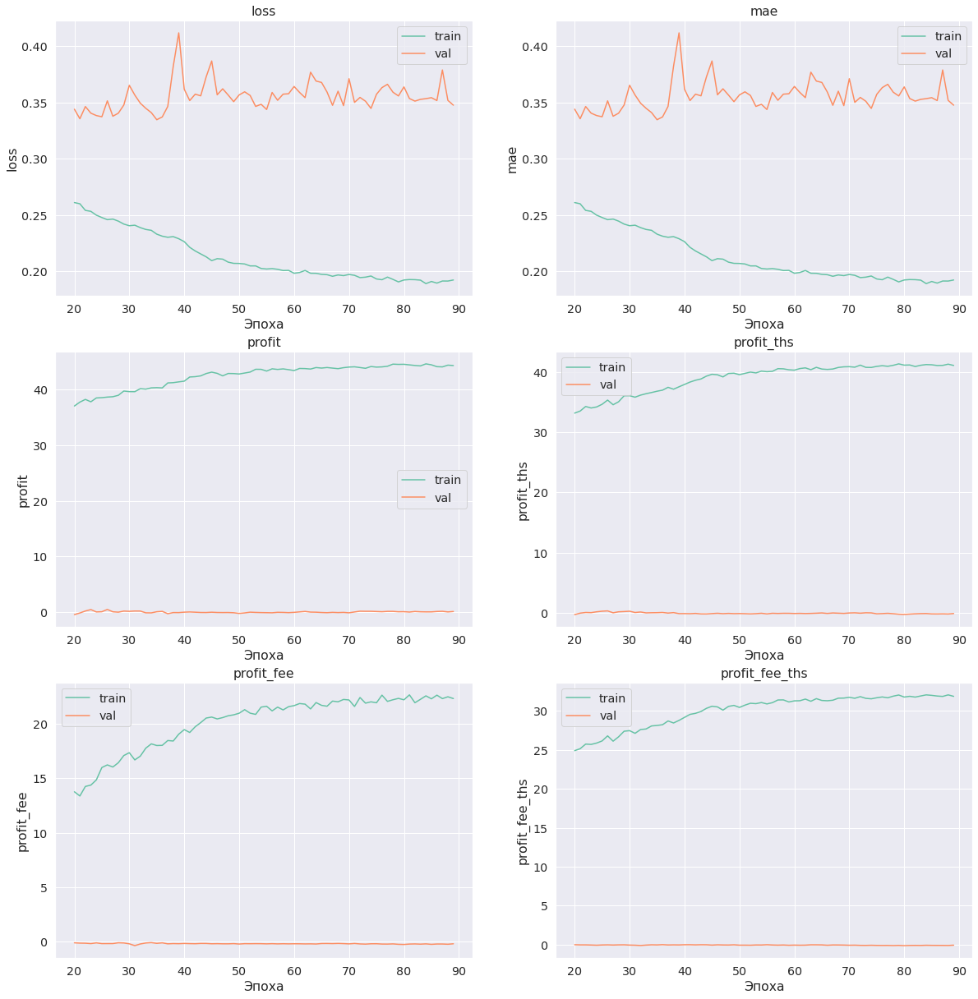

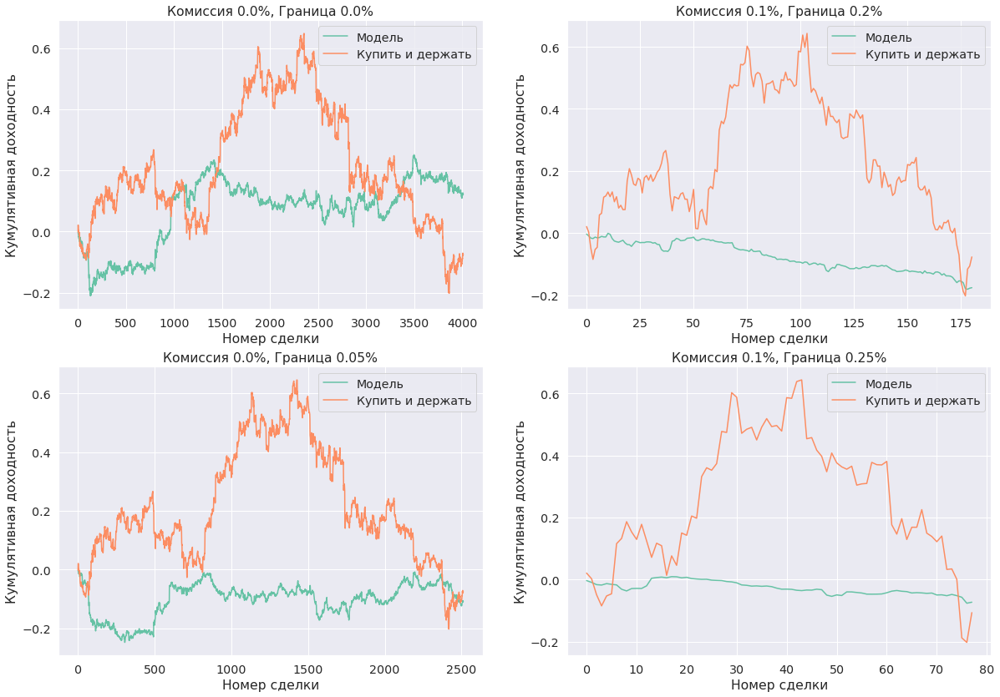

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [101]:
model_gru_ind6 = ModelGRU_IND6().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind6.parameters(), lr=1e-2)
criterion = nn.L1Loss()
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40, 80], gamma=0.1)

model_gru_ind6, history = train(
    model_gru_ind6, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND6',
    step_plotting=5,
)

Epoch 60 of 100 took 13.157s
  training loss: 	0.025811
  training mae: 	0.198756
  training profit: 	4319.147 %
  training profit ths: 	4019.505 %
  training profit fee: 	2199.812 %
  training profit fee ths: 	3101.924 %
  val loss: 	0.053068 	(0.044082)
  val mae: 	0.350989 	(0.303974)
  val profit: 	3.571 % 	(62.351 %)
  val profit ths: 	-0.737 % 	(32.201 %)
  val profit fee: 	-32.125 % 	(0.316 %)
  val profit fee ths: 	-18.255 % 	(0.012 %)


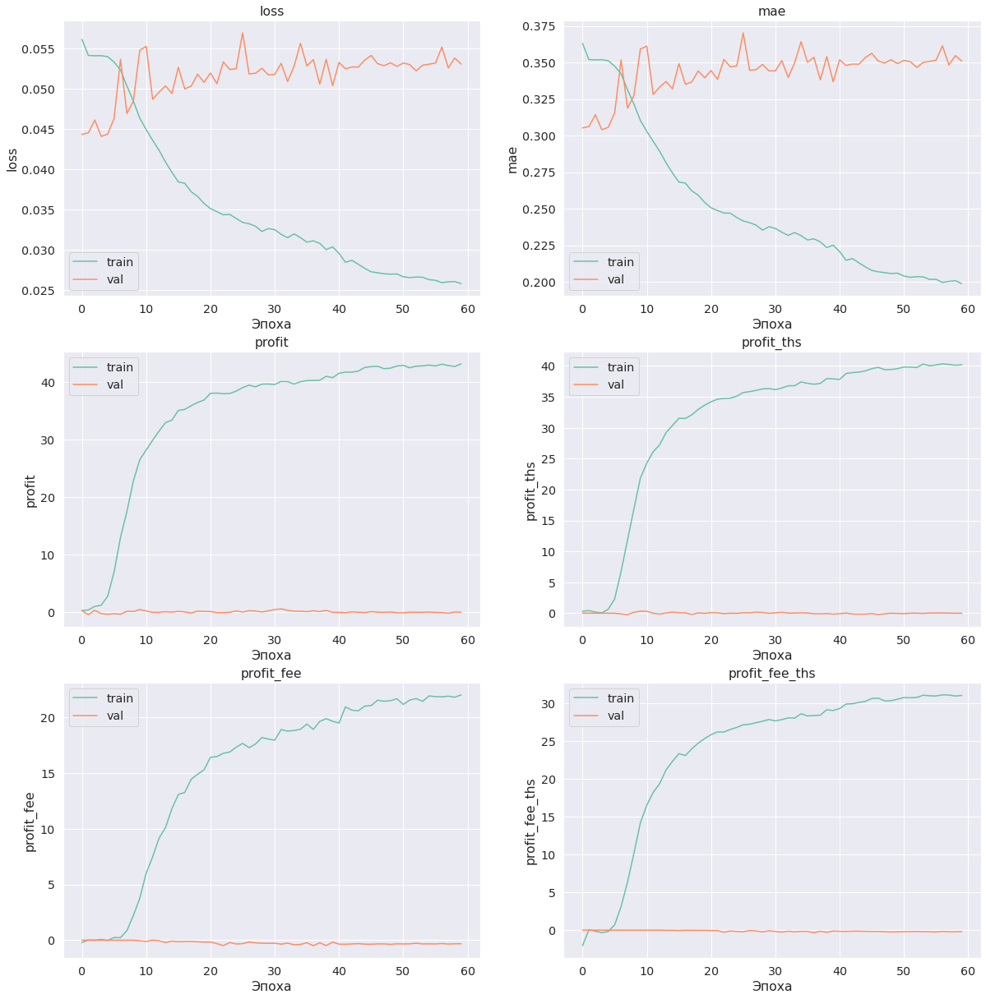

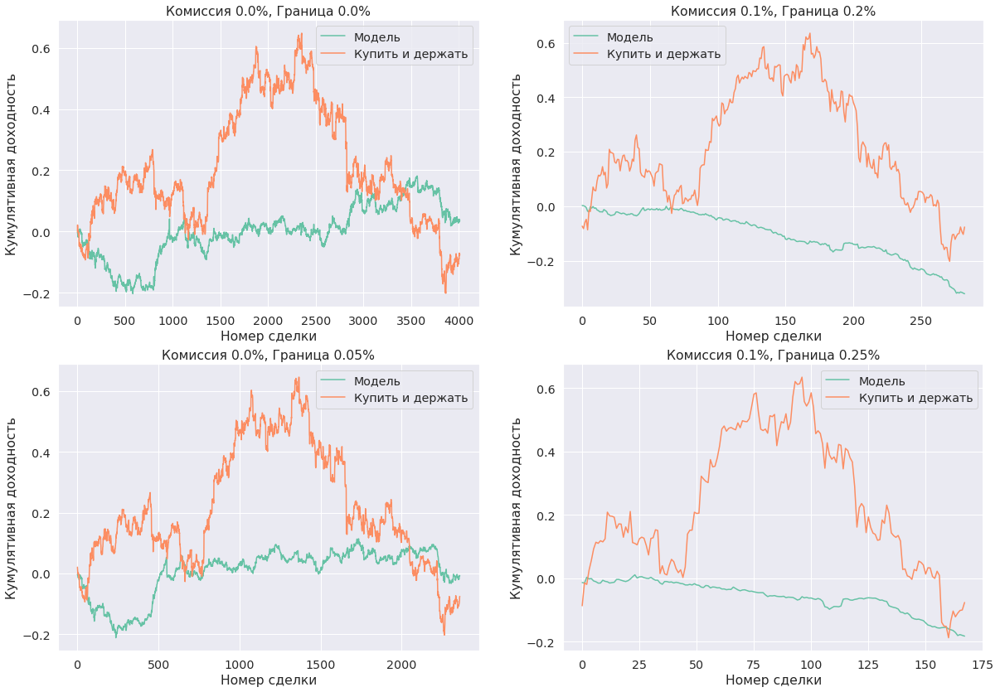

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [108]:
model_gru_ind7 = ModelGRU_IND6().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind7.parameters(), lr=1e-2)
criterion = nn.HuberLoss(delta=0.2)
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40, 80], gamma=0.1)

model_gru_ind7, history = train(
    model_gru_ind7, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND7',
    step_plotting=5,
)

In [109]:
class ModelGRU_IND8(nn.Module):
    def __init__(self, embedding_size=30, hidden_news_size=10, hidden_title_size=10):
        super(ModelGRU_IND8, self).__init__()

        self.embedding = nn.Embedding(len(vocab), embedding_size, padding_idx=0)
        self.gru_news = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_news_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.5
        )
        
        self.dropout_news0 = nn.Dropout(0.3)
        self.fc_news1 = nn.Linear(3 * hidden_news_size, 12)
        self.norm_news1 = nn.BatchNorm1d(12)
        self.dropout_news1 = nn.Dropout(0.2)

        # -------

        self.gru_titles = nn.GRU(
            input_size=embedding_size, 
            hidden_size=hidden_title_size, 
            num_layers=1, 
            batch_first=True, 
            bidirectional=False,
            # dropout=0.4
        )

        self.dropout_title0 = nn.Dropout(0.5)
        self.fc_title1 = nn.Linear(3 * hidden_title_size, 8)
        self.norm_title1 = nn.BatchNorm1d(8)
        self.dropout_title1 = nn.Dropout(0.2)
        
        # -------

        self.fc1_X = nn.Linear(X.shape[1], 32)
        self.dropout1_X = nn.Dropout(0.3)
        self.fc2_X = nn.Linear(32, 16)
        self.norm2_X = nn.BatchNorm1d(16)
        self.dropout2_X = nn.Dropout(0.3)

        # -------

        self.fc2 = nn.Linear(16 + 8 + 12, 8)
        self.norm2 = nn.BatchNorm1d(8)
        self.dropout2 = nn.Dropout(0.2)

        self.fc3 = nn.Linear(8, 1)

    def forward(self, text, text_len, title, title_len, X):
        # text.shape = (BS, MAX_LEN)
        # print("text.shape:", text.shape)

        embedded_news = self.embedding(text)
        embedded_titles = self.embedding(title)
        # embedded.shape = (BS, MAX_LEN, EMBED_SIZE)
        # print("embedded.shape:", embedded.shape)

        packed_news_in = nn.utils.rnn.pack_padded_sequence(
            embedded_news, text_len,
            batch_first=True, enforce_sorted=False
        )
        packed_titles_in = nn.utils.rnn.pack_padded_sequence(
            embedded_titles, title_len,
            batch_first=True, enforce_sorted=False
        )
        packed_news_out, hidden_news_state = self.gru_news(packed_news_in)
        packed_titles_out, hidden_titles_state = self.gru_titles(packed_titles_in)
        
        out_news, lengths_news = nn.utils.rnn.pad_packed_sequence(packed_news_out, 
                                                                  batch_first=True, 
                                                                  total_length=MAX_LEN)
        out_titles, lengths_titles = nn.utils.rnn.pad_packed_sequence(packed_titles_out, 
                                                                      batch_first=True, 
                                                                      total_length=MAX_TITLE_LEN)
        # out.shape = (BS, MAX_LEN, 2 * HIDDEN_SIZE), hidden_state.shape = ()
        # print("out.shape:", out.shape)
        # print("hidden_state.shape:", hidden_state.shape)

        avg_pool_news = torch.sum(out_news, dim=1) / lengths_news.to(device).view(-1, 1)
        avg_pool_titles = torch.sum(out_titles, dim=1) / lengths_titles.to(device).view(-1, 1)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('avg_pool.shape:', avg_pool.shape)
        
        max_pool_news = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_news, lengths_news)], dim=0)
        max_pool_titles = torch.cat([torch.max(o[:l], dim=0)[0].view(1, -1) for o, l in zip(out_titles, lengths_titles)], dim=0)
        # avg_pool.shape = (BS, 2 * HIDDEN_SIZE)
        # print('max_pool.shape:', max_pool.shape)

        # hidden_state = self.dropout0(torch.cat((hidden_state[-2,:,:], hidden_state[-1,:,:]), dim = 1))

        pool_cat_news = torch.cat([hidden_news_state[-1],
                                   avg_pool_news, max_pool_news], dim=1)
        pool_cat_titles = torch.cat([hidden_titles_state[-1],
                                     avg_pool_titles, max_pool_titles], dim=1)
        
        # pool_cat.shape = (BS, 8 * HIDDEN_SIZE)
        # print('pool_cat.shape:', pool_cat.shape)

        output_news = self.fc_news1(self.dropout_news0(pool_cat_news))
        output_titles = self.fc_title1(self.dropout_title0(pool_cat_titles))
        # output_news = self.norm_news1(output_news)
        # output_titles = self.norm_title1(output_titles)
        output_news = F.leaky_relu(self.dropout_news1(output_news))
        output_titles = F.leaky_relu(self.dropout_title1(output_titles))

        # -------

        X_out = F.relu(self.dropout1_X(self.fc1_X(X)))
        X_out = F.leaky_relu(self.dropout2_X(self.norm2_X(self.fc2_X(X_out))))

        # -------

        output = self.fc2(torch.cat([output_news, output_titles, X_out], dim=1))
        output = F.relu(self.norm2(output))
        output = self.fc3(output)
        return output

Epoch 55 of 100 took 7.896s
  training loss: 	0.023996
  training mae: 	0.189218
  training profit: 	4385.721 %
  training profit ths: 	4161.758 %
  training profit fee: 	2349.319 %
  training profit fee ths: 	3217.069 %
  val loss: 	0.058506 	(0.044367)
  val mae: 	0.380090 	(0.305617)
  val profit: 	-48.386 % 	(20.892 %)
  val profit ths: 	-52.485 % 	(2.737 %)
  val profit fee: 	-61.078 % 	(0.419 %)
  val profit fee ths: 	-30.578 % 	(1.517 %)


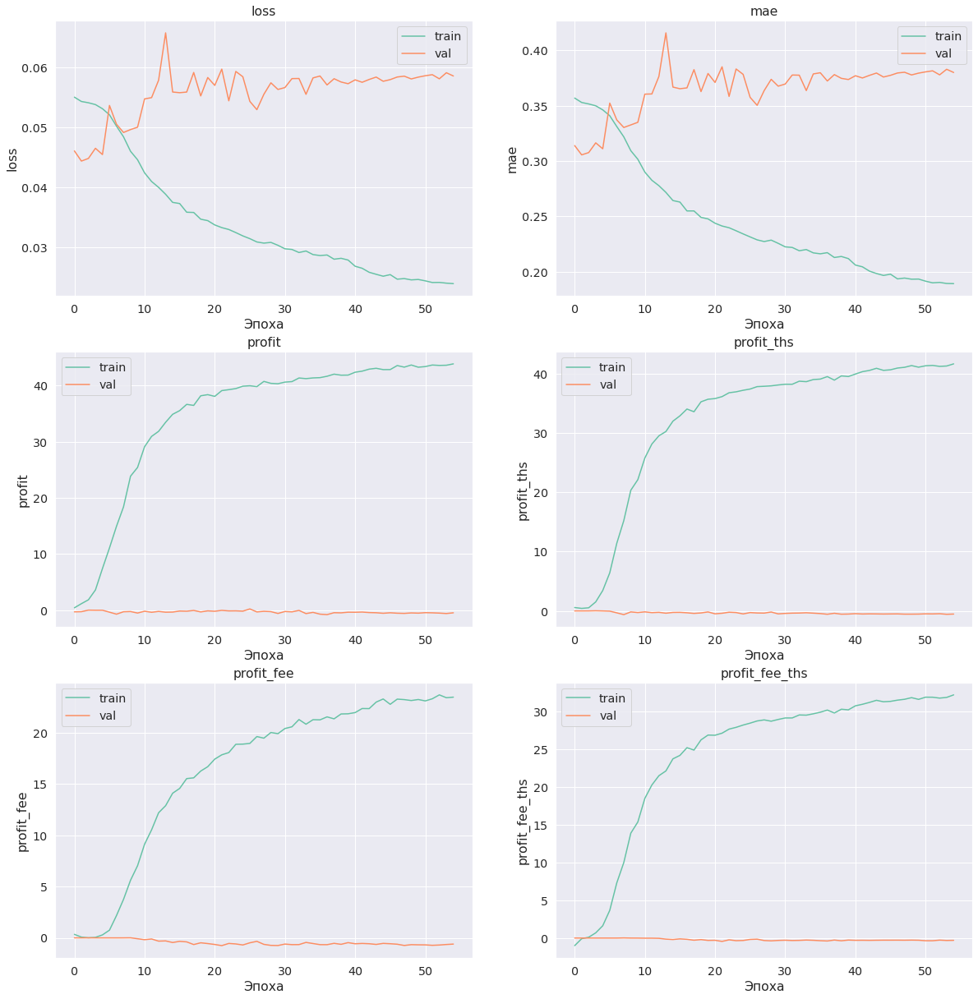

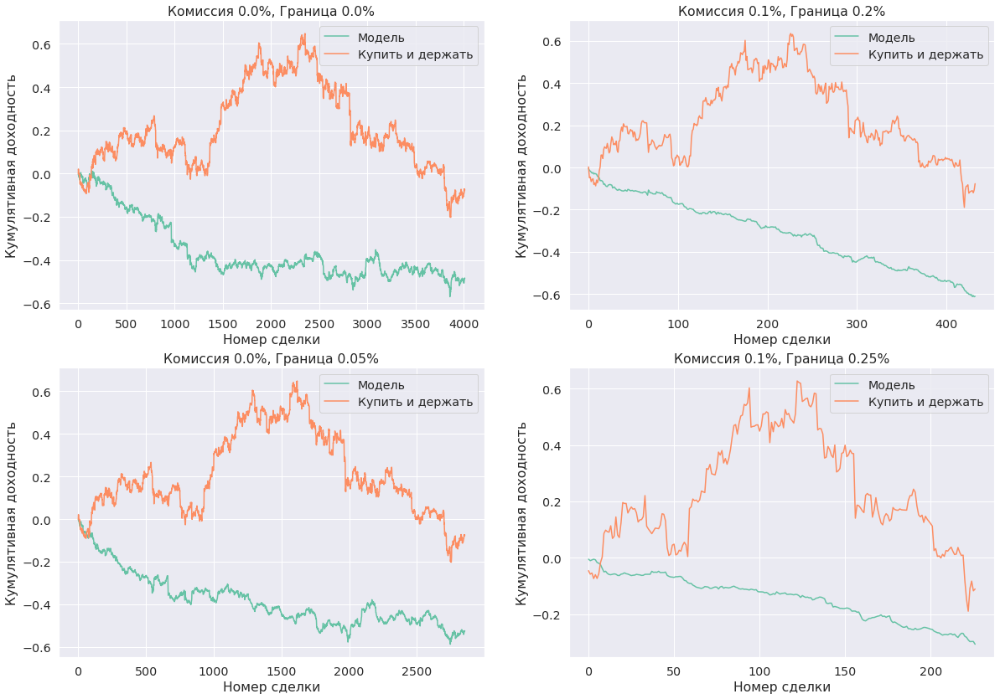

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [111]:
model_gru_ind8 = ModelGRU_IND8().to(device)
optimizer = torch.optim.Adam(params=model_gru_ind8.parameters(), lr=1e-2)
criterion = nn.HuberLoss(delta=0.2)
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[40, 80], gamma=0.1)

model_gru_ind8, history = train(
    model_gru_ind8, 
    criterion, 
    optimizer, 
    train_dataloader, 
    test_dataloader,
    scheduler=scheduler,
    num_epochs=100,
    save_name='ModelGRU_IND8',
    step_plotting=5,
)

In [91]:
import gc
gc.collect()

27095

In [ ]:
# model_gru_ind4, model_gru_ind6        _profit_fee_ths

In [112]:
model_gru_ind4 = ModelGRU_IND3().to(device)
train_info = torch.load(MODELS_DIR + 'ModelGRU_IND4_profit_fee_ths.data', map_location=torch.device(device))
model_gru_ind4.load_state_dict(train_info['model_state_dict'])

<All keys matched successfully>

  val loss: 	0.052264
  val mae: 	0.347060
  val profit: 	13.447 %
  val profit ths: 	-5.005 %
  val profit fee: 	-8.800 %
  val profit fee ths: 	3.292 %


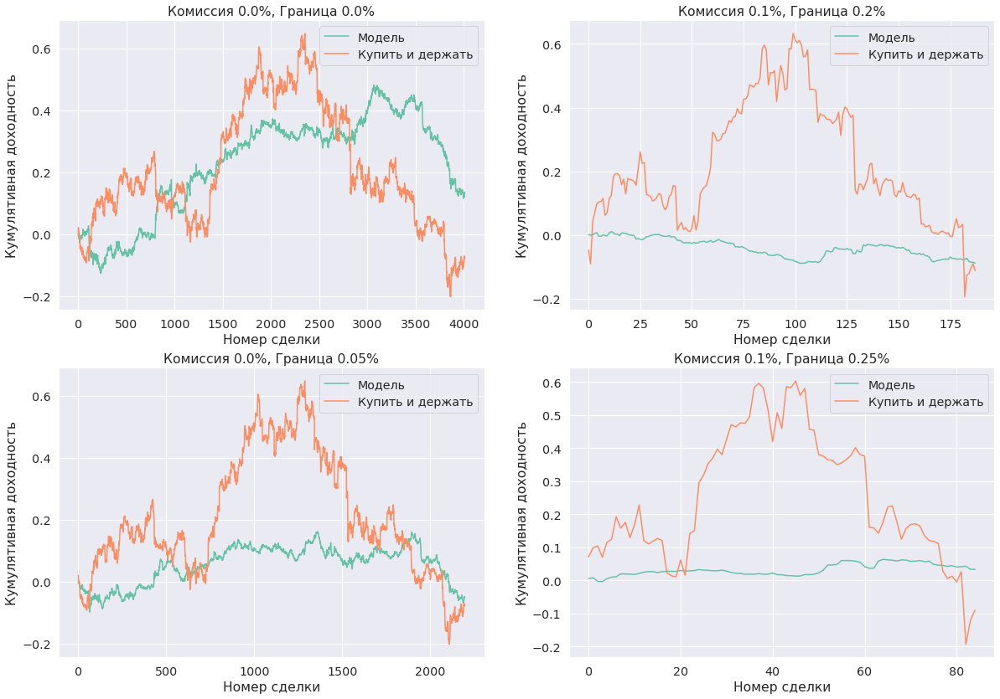

In [117]:
predict(model_gru_ind4, criterion, test_dataloader, threshold=0.0005, short=True, long=True);

  val loss: 	0.052264
  val mae: 	0.347060
  val profit: 	21.621 %
  val profit ths: 	3.635 %
  val profit fee: 	-2.855 %
  val profit fee ths: 	3.561 %


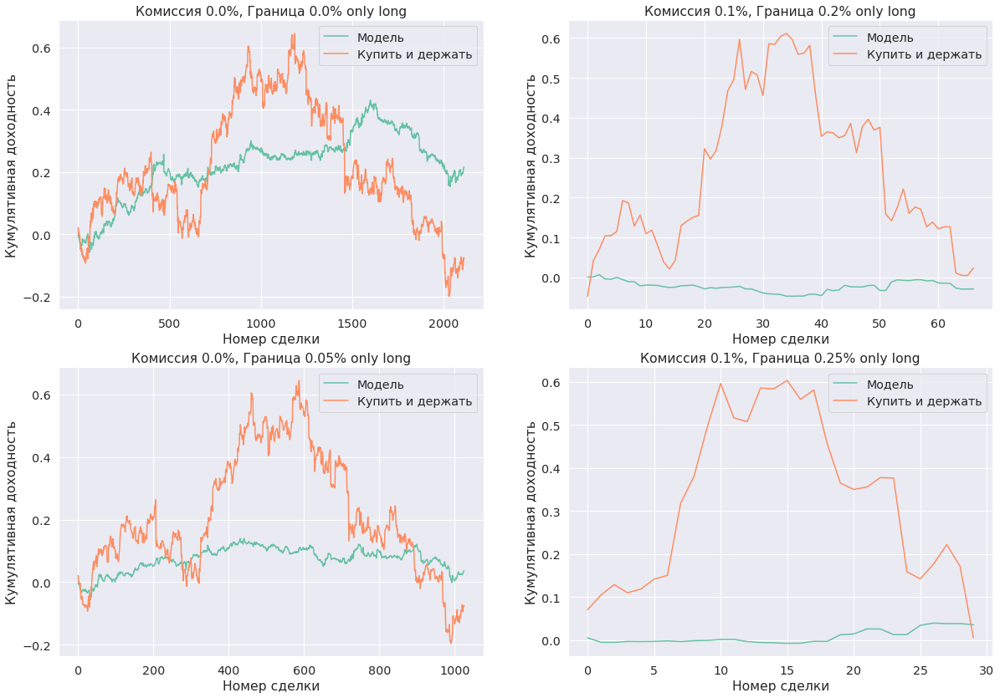

In [116]:
predict(model_gru_ind4, criterion, test_dataloader, threshold=0.0005, short=False, long=True);

  val loss: 	0.050074
  val mae: 	0.335984
  val profit: 	9.557 %
  val profit ths: 	-8.845 %
  val profit fee: 	2.030 %
  val profit fee ths: 	-0.444 %


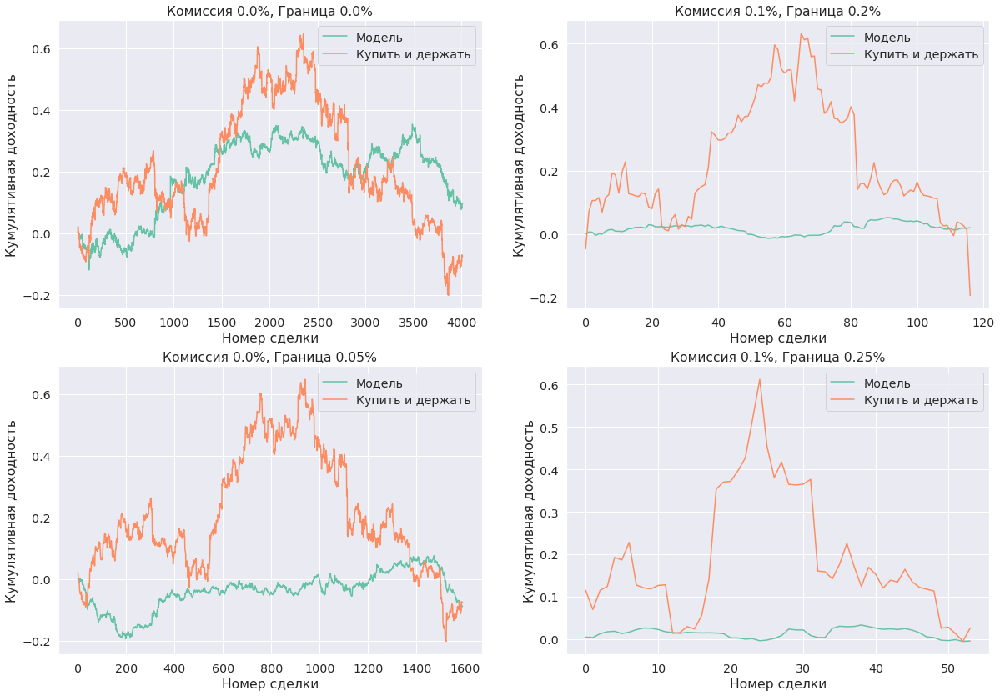

In [119]:
model_gru_ind4 = ModelGRU_IND3().to(device)
train_info = torch.load(MODELS_DIR + 'ModelGRU_IND4_profit_fee.data', map_location=torch.device(device))
model_gru_ind4.load_state_dict(train_info['model_state_dict'])

predict(model_gru_ind4, criterion, test_dataloader, threshold=0.0005, short=True, long=True);

  val loss: 	0.050074
  val mae: 	0.335984
  val profit: 	19.676 %
  val profit ths: 	-6.621 %
  val profit fee: 	4.468 %
  val profit fee ths: 	1.935 %


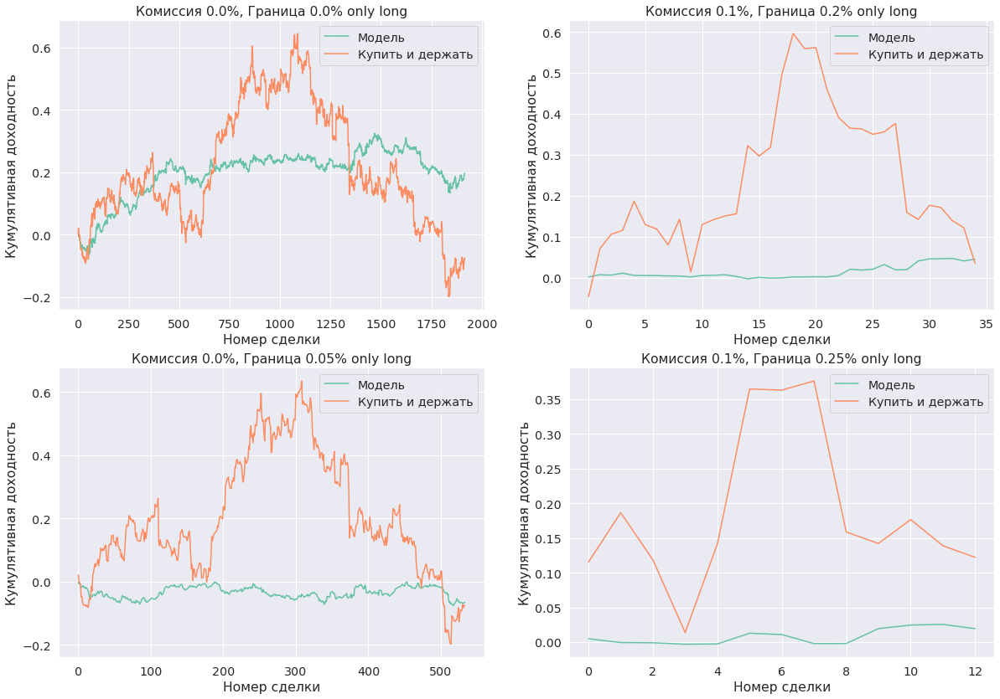

In [122]:
predict(model_gru_ind4, criterion, test_dataloader, threshold=0.0005, short=False, long=True);

  val loss: 	0.052143
  val mae: 	0.346031
  val profit: 	27.011 %
  val profit ths: 	12.102 %
  val profit fee: 	0.736 %
  val profit fee ths: 	1.433 %


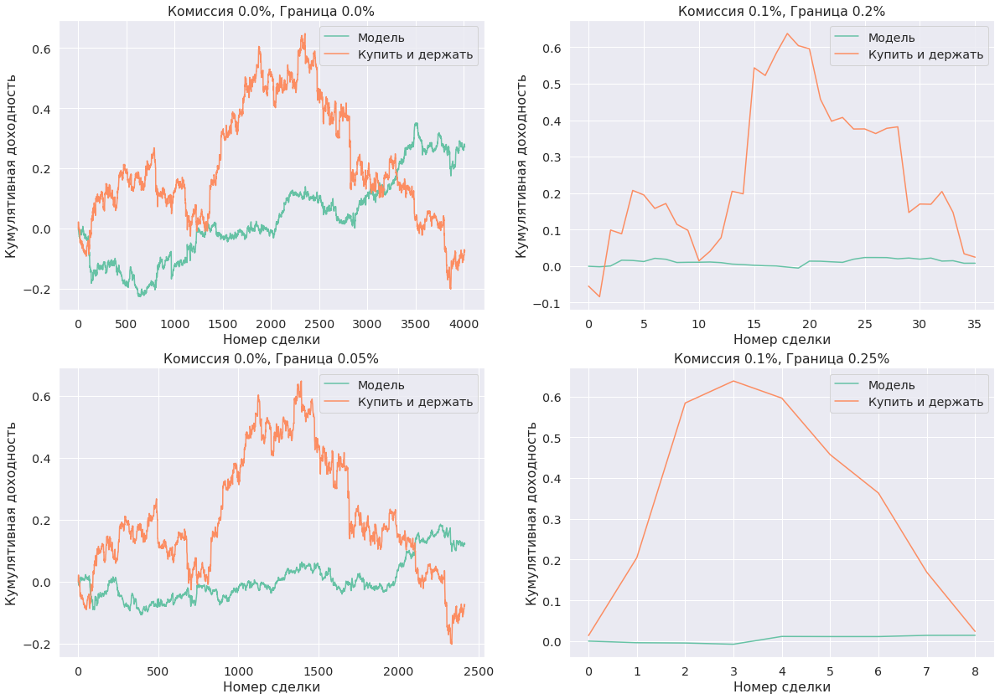

In [126]:
model_gru_ind6 = ModelGRU_IND6().to(device)
train_info = torch.load(MODELS_DIR + 'ModelGRU_IND6_profit_fee_ths.data', map_location=torch.device(device))
model_gru_ind6.load_state_dict(train_info['model_state_dict'])

predict(model_gru_ind6, criterion, test_dataloader, threshold=0.0005, short=True, long=True);